## Setup, Loading Data and CDFs

In [1]:
DATA_NAME = 'coco-outdoor' 
TRANSFORM = 'learned'
CHANNEL = ''

In [2]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
learned_outdoor_coco.ipynb


In [3]:
import git
from pathlib import Path
import os

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/brandonmarks/Desktop/hierarchical-bayesian-model-validation/results/case-studies/coco/outdoor/learned'

In [4]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [5]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))
nonskewed_df = pd.read_csv(os.path.join(ROOT_DIR, 'learned-filters', 'nonskewed_filter_idxs_df.csv')).set_index(['dataset', 'num_images', 'num_bootstrap'])
nonskewed_filter_idxs = eval(nonskewed_df.loc[DATA_NAME].sort_values('num_images', ascending=False)['nonskewed_filter_idxs'].iloc[0])
filter_group_map = pd.read_pickle(os.path.join(ROOT_DIR, 'learned-filters', 'filter_group_map.pickle'))

In [6]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 196608000,
 1: 196608000,
 2: 196608000,
 3: 196608000,
 4: 196608000,
 5: 196608000,
 6: 196608000,
 7: 196608000,
 8: 196608000,
 9: 196608000,
 10: 196608000,
 11: 196608000,
 12: 196608000,
 13: 196608000,
 14: 196608000,
 15: 196608000,
 16: 196608000,
 17: 196608000,
 18: 196608000,
 19: 196608000,
 20: 196608000,
 21: 196608000,
 22: 196608000,
 23: 196608000,
 24: 196608000,
 25: 196608000,
 26: 196608000,
 27: 196608000,
 28: 196608000,
 29: 196608000,
 30: 196608000,
 31: 196608000,
 32: 196608000,
 33: 196608000,
 34: 196608000,
 35: 196608000,
 36: 196608000,
 37: 196608000,
 38: 196608000,
 39: 196608000,
 40: 196608000,
 41: 196608000,
 42: 196608000,
 43: 196608000,
 44: 196608000,
 45: 196608000,
 46: 196608000,
 47: 196608000,
 48: 196608000,
 49: 196608000,
 50: 196608000,
 51: 196608000,
 52: 196608000,
 53: 196608000,
 54: 196608000,
 55: 196608000,
 56: 196608000,
 57: 196608000,
 58: 196608000,
 59: 196608000,
 60: 196608000,
 61: 196608000,
 62: 196608000,
 6

Running 12760 CDFs


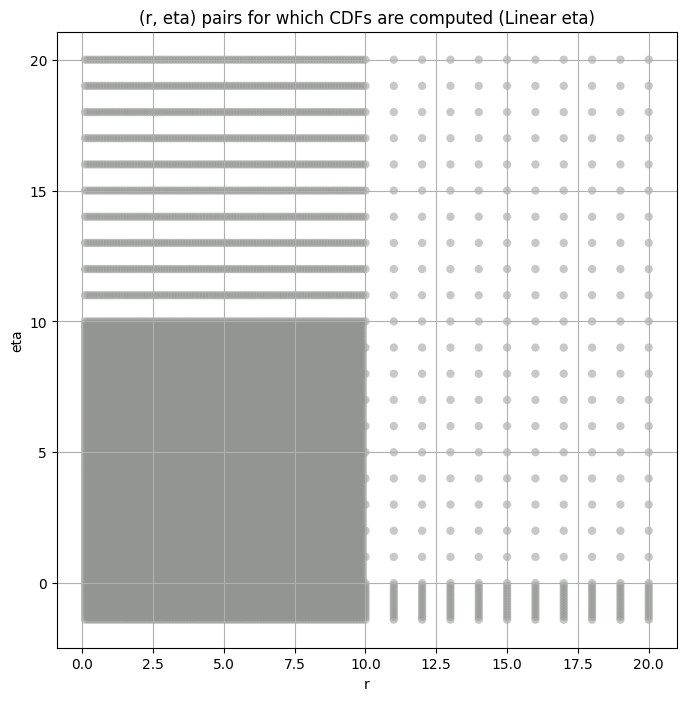

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [7]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [8]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [9]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = filter_group_map[group]

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 1


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 19


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 21


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 35


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 36


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 37


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 40


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 42


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 43


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 44


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 45


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 46


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 47


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 48


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 49


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 50


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 51


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 52


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 53


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 54


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 55


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 56


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 57


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 58


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 59


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 60


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 61


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 62


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 63


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,5.722945,3.941295,15.222635,59.391348,5.931396,391.685447,196608000.0,dual_color
1,6.533414,5.498173,8.526413,3.136300,0.137287,80.026759,196608000.0,misc
2,7.159568,4.921619,20.682040,85.591074,7.076928,476.156391,196608000.0,dual_color
3,4.838522,3.290435,11.411586,48.853143,6.976516,333.181233,196608000.0,single_edge
4,8.759626,6.083474,18.486370,34.242134,7.774326,295.723662,196608000.0,dual_color
...,...,...,...,...,...,...,...,...
59,7.331521,5.420855,13.697990,22.008065,4.583866,237.169119,196608000.0,dual_color
60,0.908400,0.631226,2.939074,103.870175,5.770326,500.142442,196608000.0,misc
61,2.831791,1.875037,6.085772,40.461455,7.221174,309.068150,196608000.0,misc


## Initial Grid Search and Hypothesis Test Plots

In [10]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [11]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,5.722945,5.722945,5.171240,4.937813,4.588196
1,6.533414,6.533414,6.346170,6.252358,6.104103
2,7.159568,7.159568,6.350358,6.021584,5.538102
3,4.838522,4.838522,4.320077,4.090691,3.762275
4,8.759626,8.759626,8.055955,7.703118,7.147288
...,...,...,...,...,...
59,7.331521,7.331521,6.831544,6.585038,6.205108
60,0.908400,0.908400,0.801540,0.764461,0.711429
61,2.831791,2.831791,2.540592,2.402862,2.203161


####
Filter_idx  0


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 0 0.007872721646730974 5.722945063258994


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 50 0.009951819675150242 5.171239635391533


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 100 0.010240898689330091 4.937812881908325


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 200 0.009019613537538662 4.588196182625446
Number of samples: 100000, Without approximation : 196608000.0


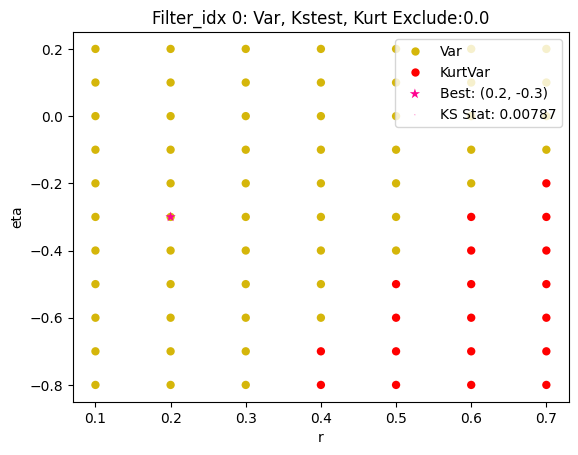

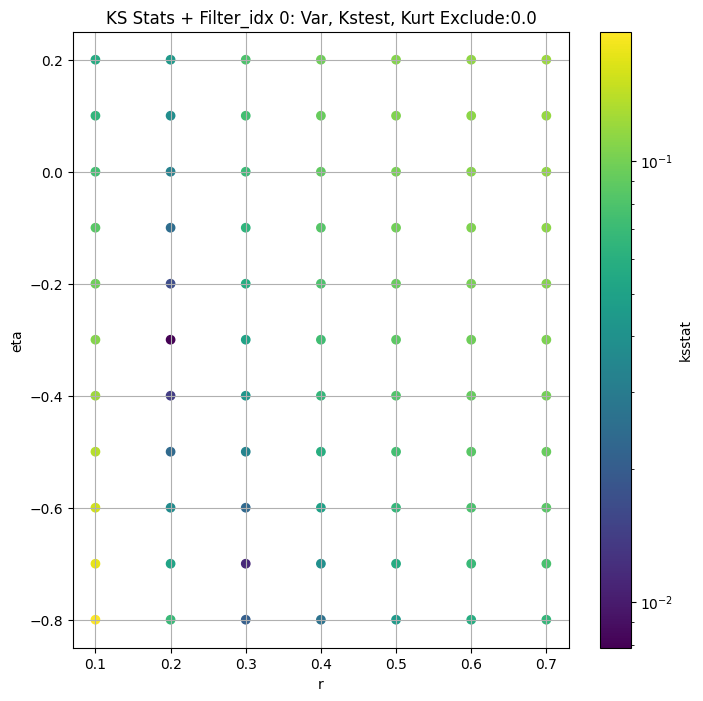

####
Filter_idx  1


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 0 0.027701867530590507 6.533413952768092


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 50 0.027703434032465946 6.346170305753413


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 100 0.027665425462894855 6.252357616831734


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 200 0.02765207437532924 6.1041026192380015
Number of samples: 100000, Without approximation : 196608000.0


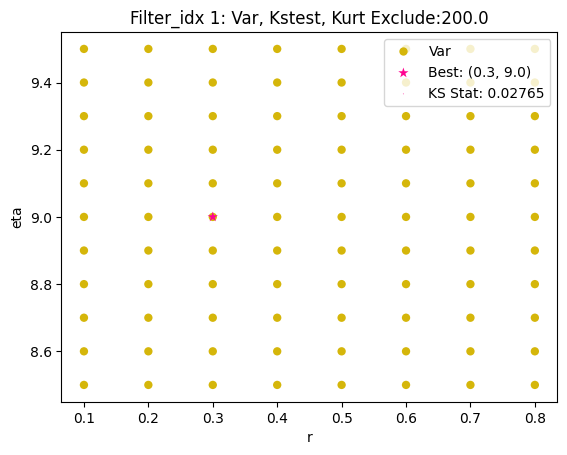

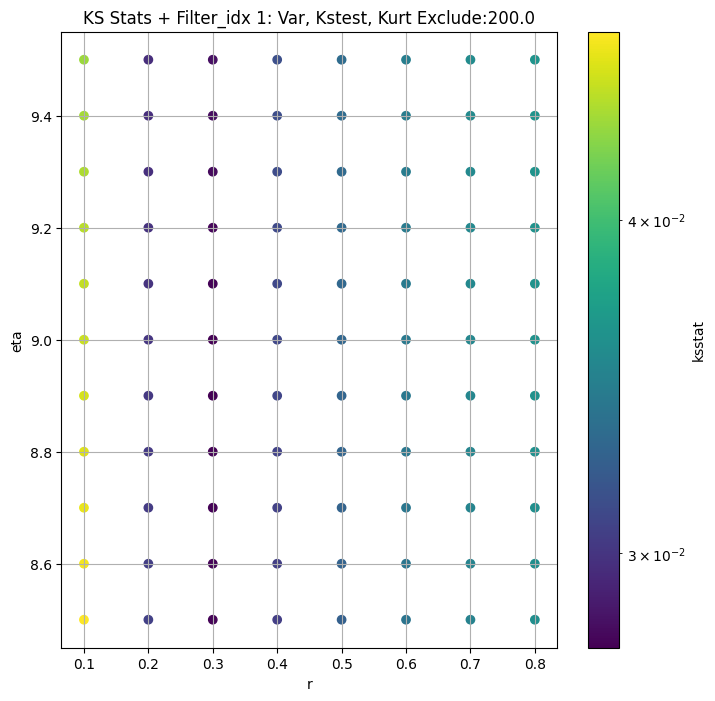

####
Filter_idx  2


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 0 0.006579417655318831 7.1595676114240385


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 50 0.00892520447834988 6.3503583542742374


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 100 0.007615937747797369 6.021584361857979


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 200 0.008852787933141482 5.5381015467307035
Number of samples: 100000, Without approximation : 196608000.0


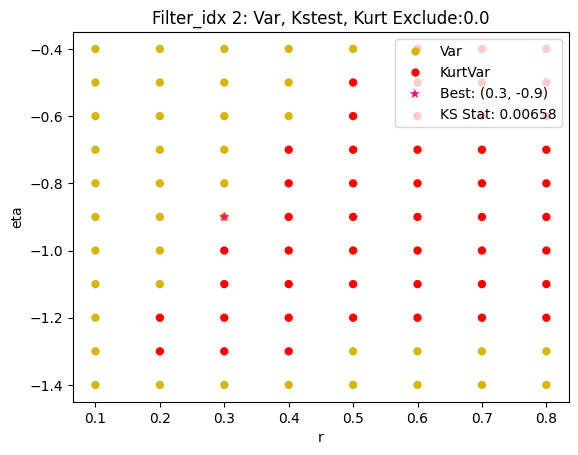

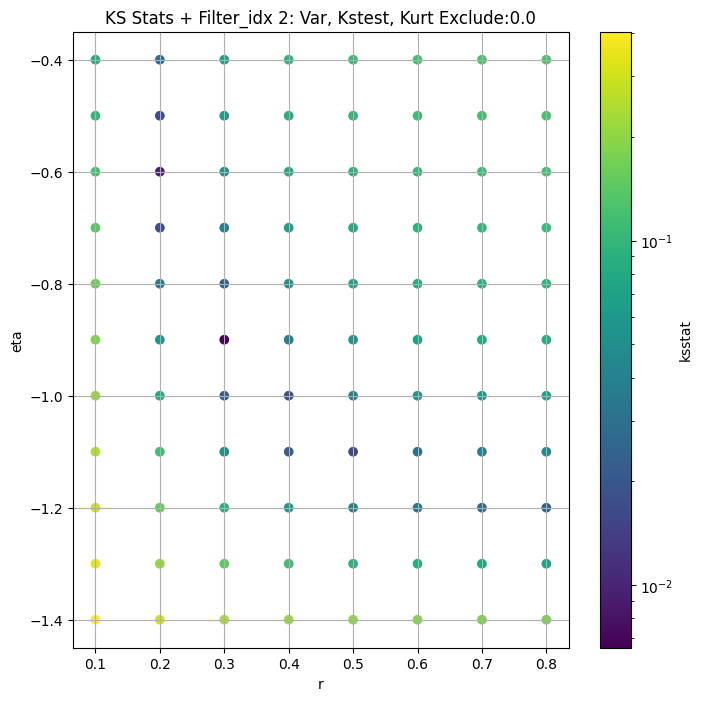

####
Filter_idx  3


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 0 0.005482435409888395 4.838522315826807


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 50 0.007199249452098155 4.3200768860396614


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 100 0.006520182875889777 4.090690627663553


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 200 0.008823479175657956 3.7622748701716135
Number of samples: 100000, Without approximation : 196608000.0


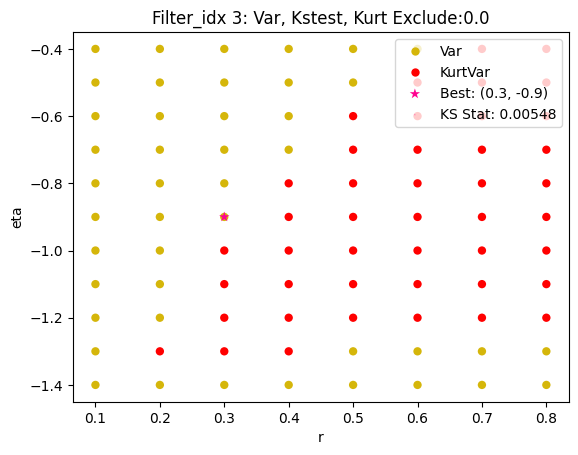

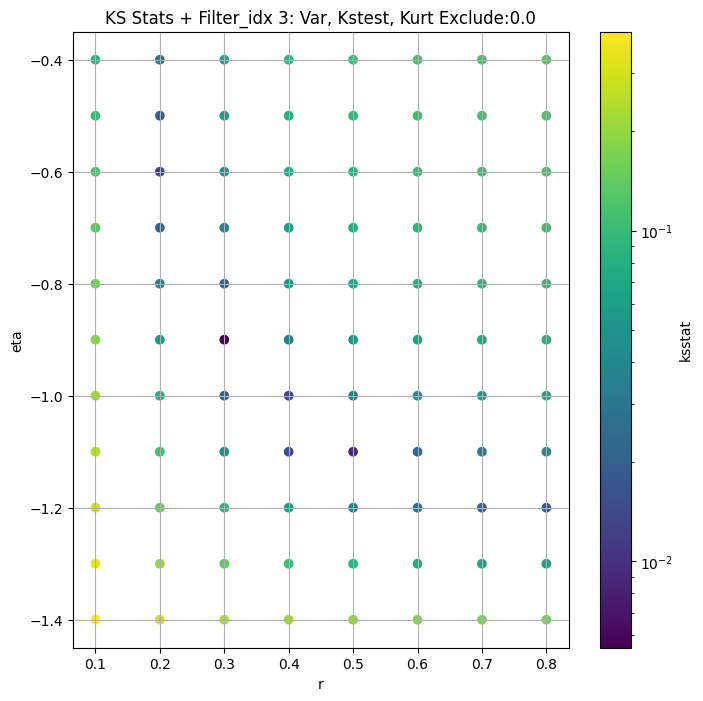

####
Filter_idx  4


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 0 0.012242728997978333 8.75962554271881


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 50 0.011844633012886296 8.055954842394957


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 100 0.01001071584159452 7.703117686415404


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 200 0.011791574753797503 7.147288232864539
Number of samples: 100000, Without approximation : 196608000.0


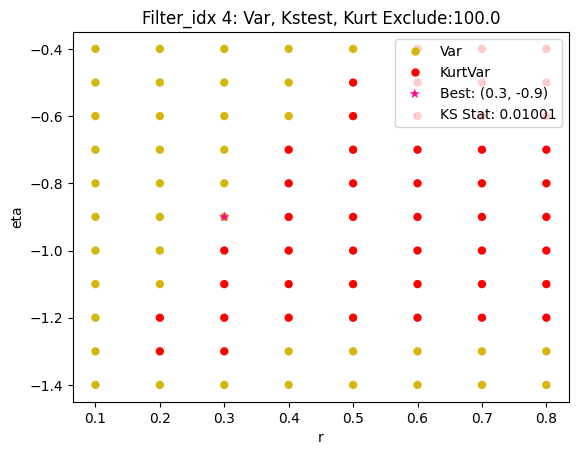

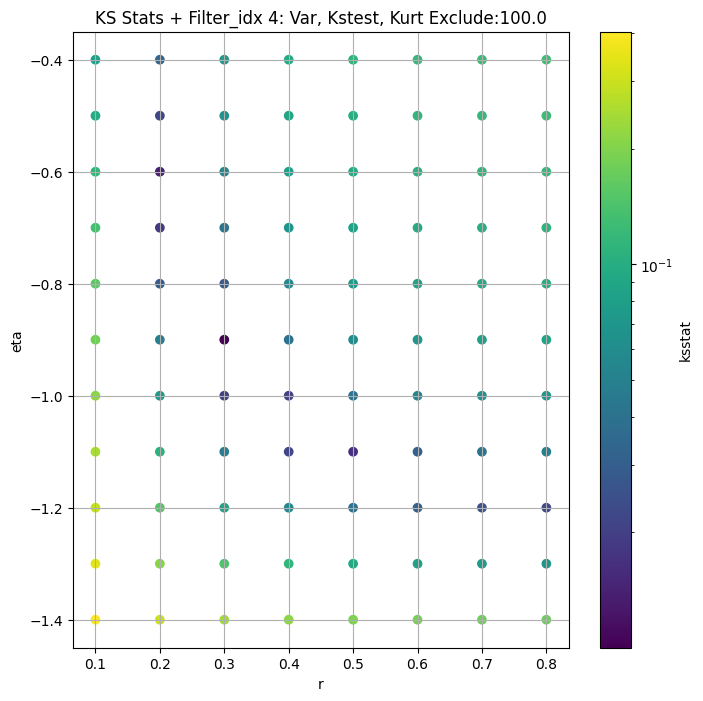

####
Filter_idx  5


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 0 0.013587828056360468 5.603066738768062


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 50 0.01242721548066883 5.176218043596685


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 100 0.012596716187834422 4.978757527734711


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 200 0.015488264666110377 4.6690791256344015
Number of samples: 100000, Without approximation : 196608000.0


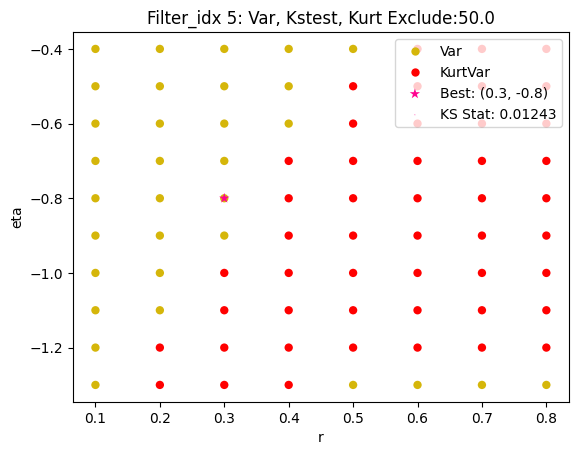

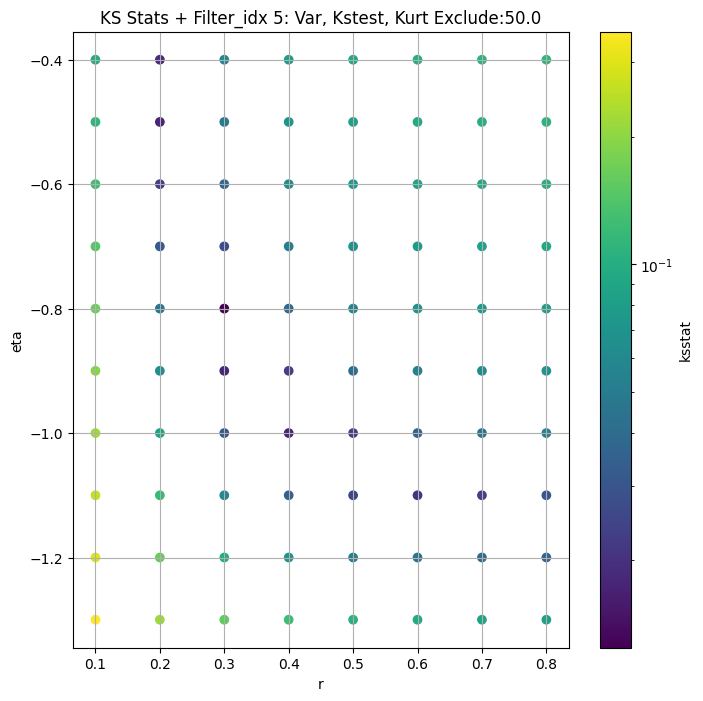

####
Filter_idx  6


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 0 0.005703851126021675 2.846655635276621


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 50 0.008401423012686815 2.538975162998015


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 100 0.007933471212198229 2.418004791698781


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 200 0.007099728377406633 2.2449093527091857
Number of samples: 100000, Without approximation : 196608000.0


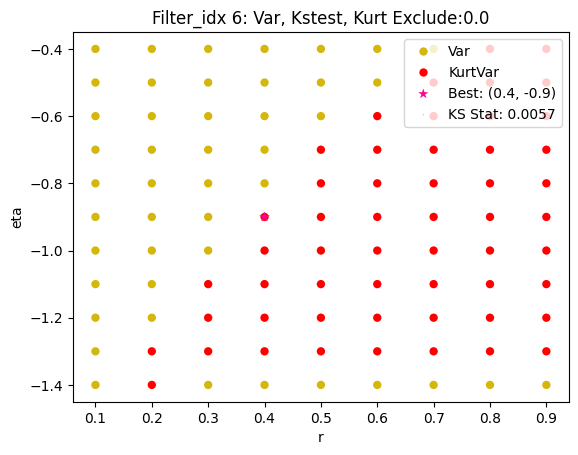

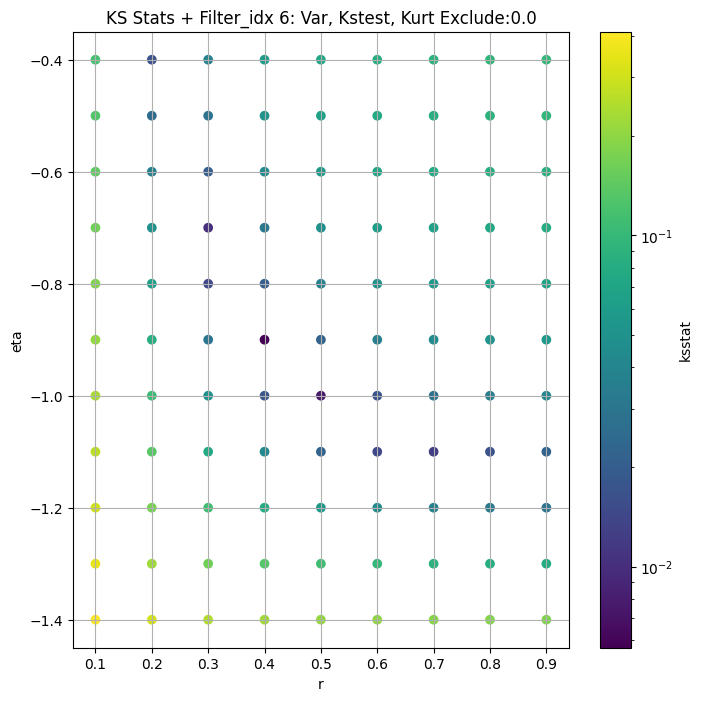

####
Filter_idx  7


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 0 0.006828228279413984 3.5449931841577373


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 50 0.007023394056851873 3.39623771595253


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 100 0.006719401702534267 3.330288584593084


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 200 0.006703515843518804 3.227344217082155
Number of samples: 100000, Without approximation : 196608000.0


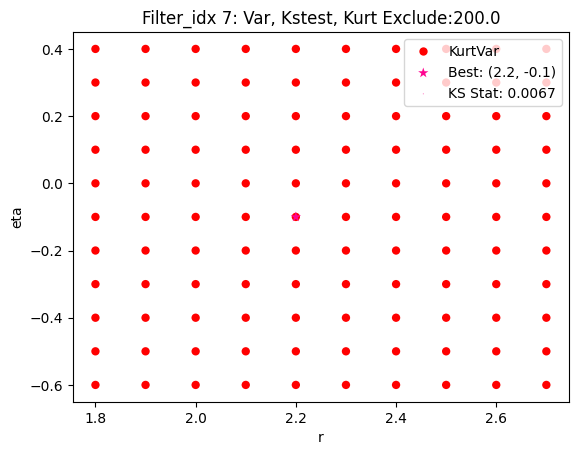

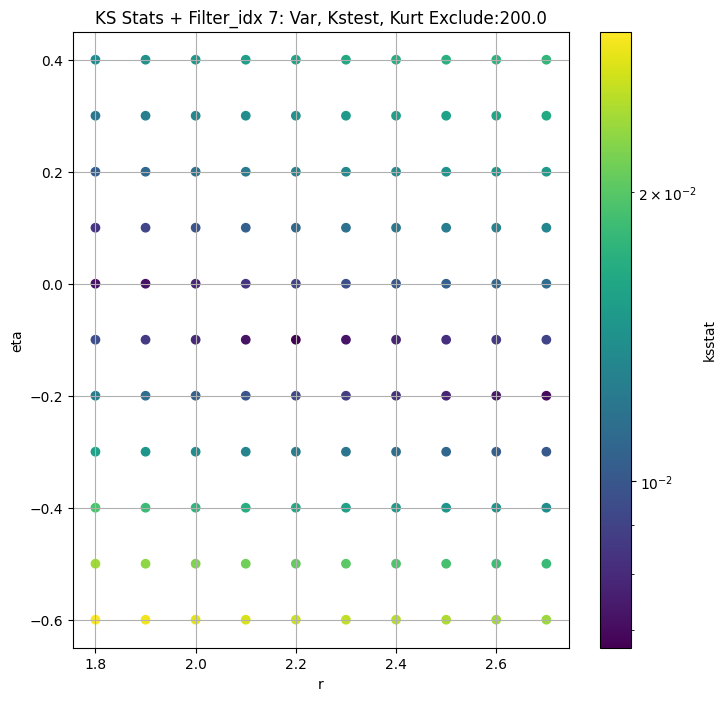

####
Filter_idx  8


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 0 0.010372112170069947 0.4226354638231319


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 50 0.009038889775142223 0.36946718763674274


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 100 0.008603328470062954 0.3532353606239595


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 200 0.009700118792288048 0.329854001881963
Number of samples: 100000, Without approximation : 196608000.0


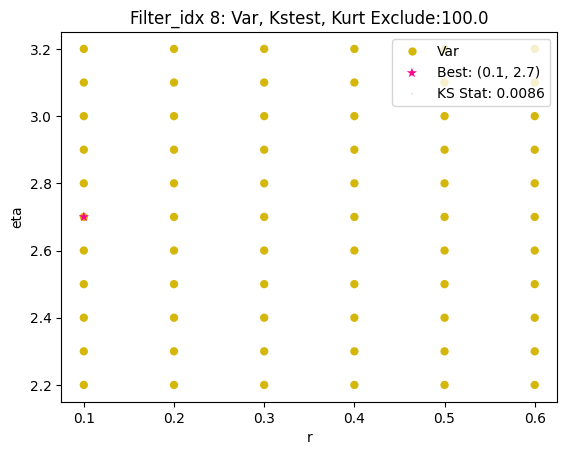

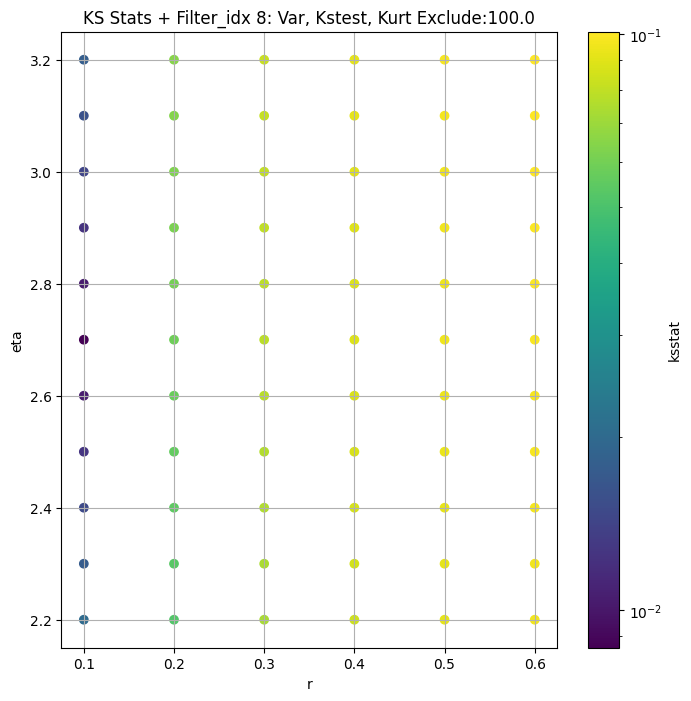

####
Filter_idx  9


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 0 0.015357999737117822 3.000422791004444


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 50 0.011592177085068434 2.5513608714714016


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 100 0.012211588218897007 2.3896170908544745


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 200 0.014887749703955871 2.170512115604834
Number of samples: 100000, Without approximation : 196608000.0


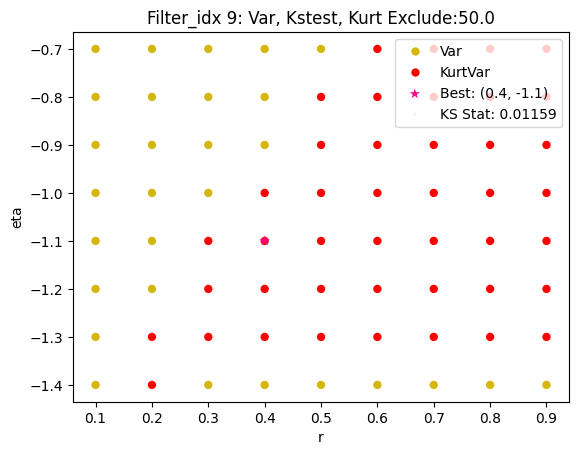

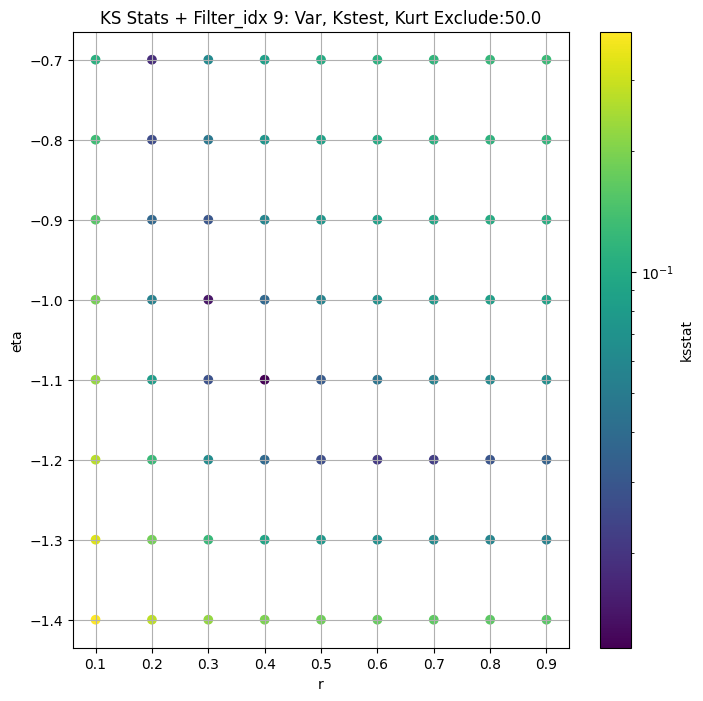

####
Filter_idx  10


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 0 0.008464779060364802 3.485964679620385


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 50 0.007544368570644666 3.171727962320305


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 100 0.006280317170591021 3.0310660669547396


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 200 0.0081100435423751 2.82468457757201
Number of samples: 100000, Without approximation : 196608000.0


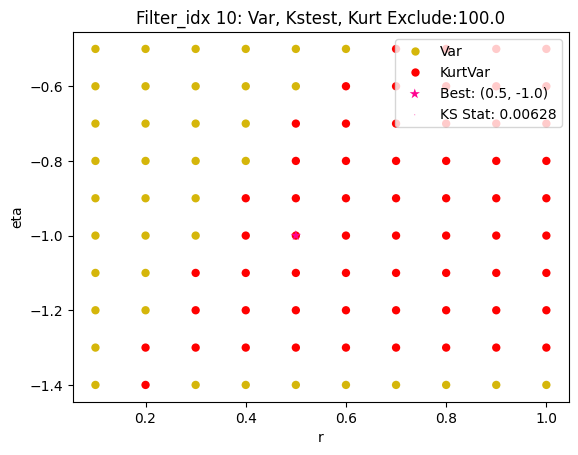

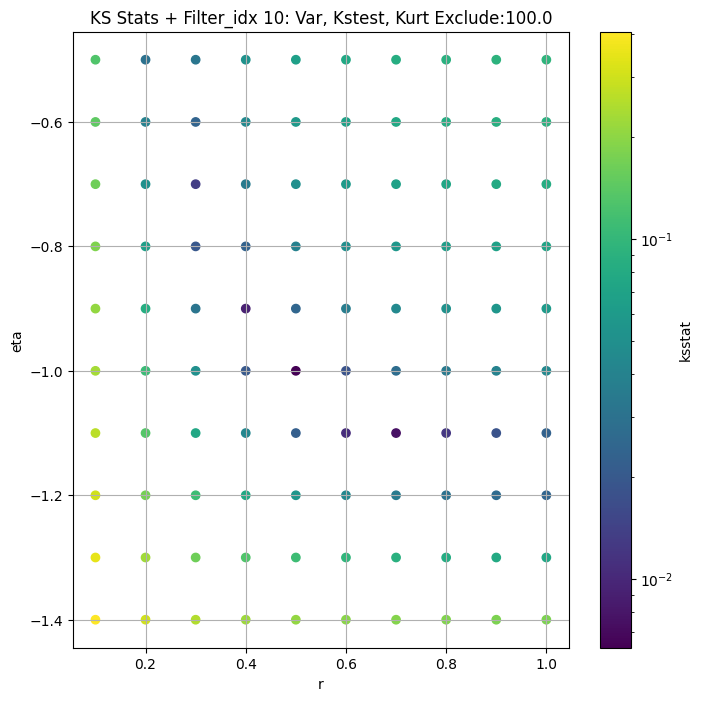

####
Filter_idx  11


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 0 0.011792287599474205 2.6060207746886097


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 50 0.012985979963542227 2.2626877322768695


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 100 0.0122619352168154 2.135216667391795


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 200 0.014164050656940985 1.9557529816965809
Number of samples: 100000, Without approximation : 196608000.0


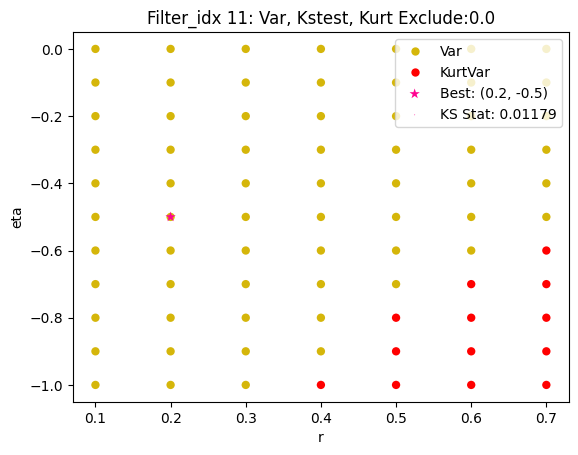

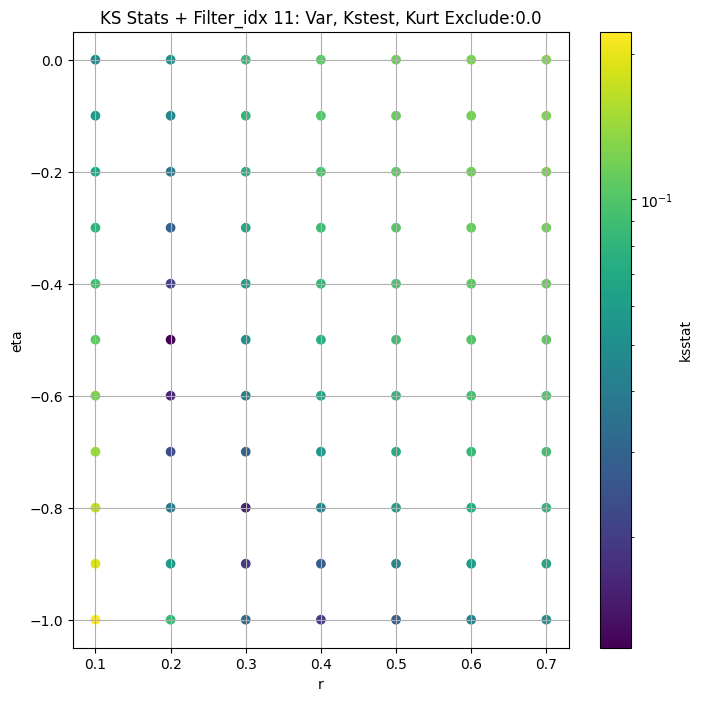

####
Filter_idx  12


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 0 0.011365783147195913 2.7016123979812185


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 50 0.01058649002234302 2.333798906619431


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 100 0.009893415313763199 2.2002059105272216


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 200 0.01220640504905357 2.014348192495963
Number of samples: 100000, Without approximation : 196608000.0


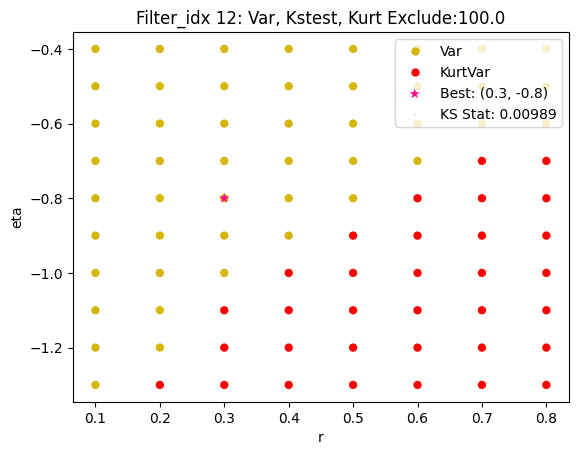

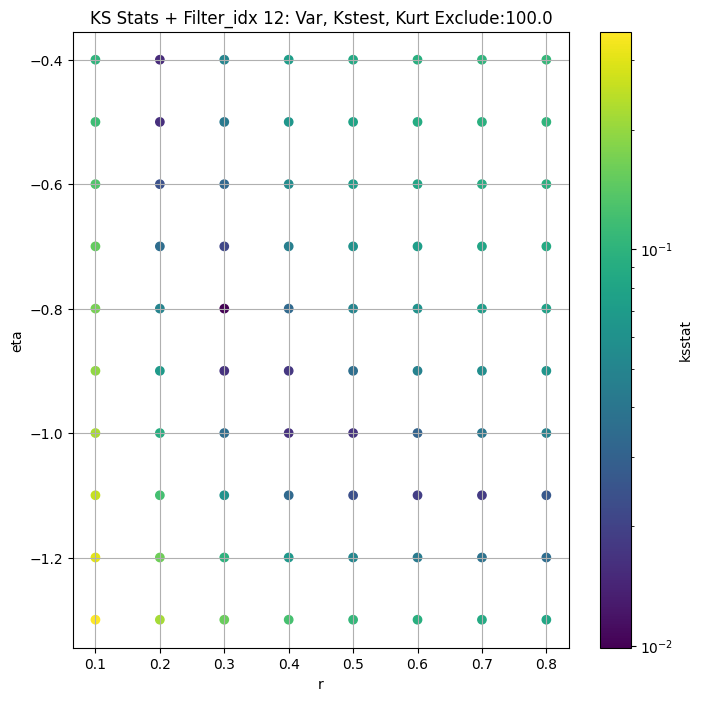

####
Filter_idx  13


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 0 0.011375074633441284 4.040795934156365


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 50 0.010793980187020422 3.5877850282307753


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 100 0.012502170480498953 3.4118759814187682


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 200 0.009517352197446816 3.159104902565461
Number of samples: 100000, Without approximation : 196608000.0


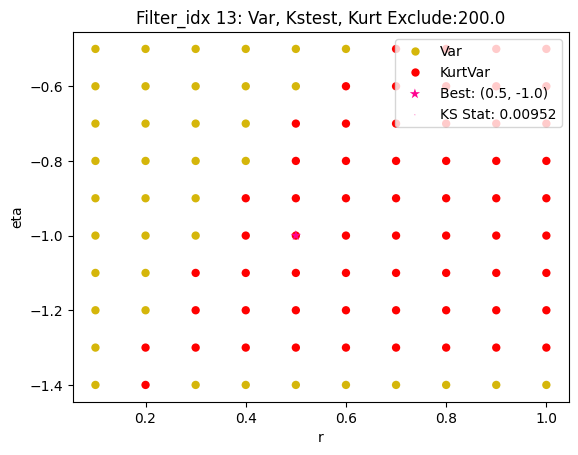

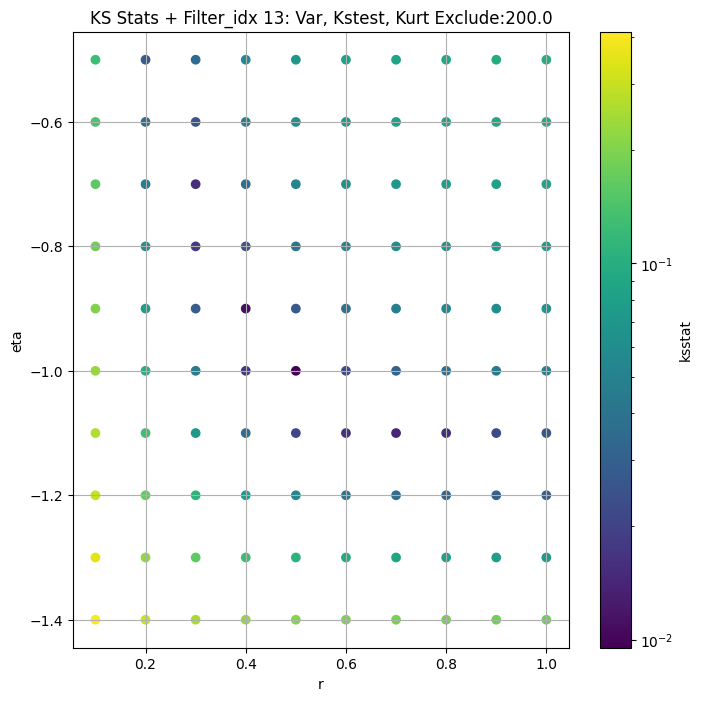

####
Filter_idx  14


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 0 0.008806215906623283 4.35515929710186


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 50 0.005985973123806443 3.935302306287966


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 100 0.008325518599179182 3.746252001248223


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 200 0.010099285870880048 3.469366822928795
Number of samples: 100000, Without approximation : 196608000.0


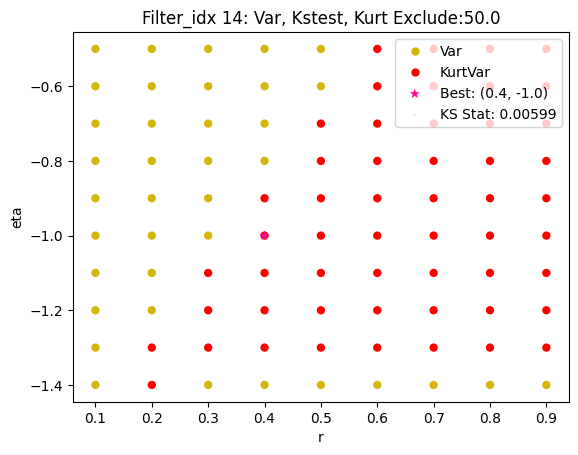

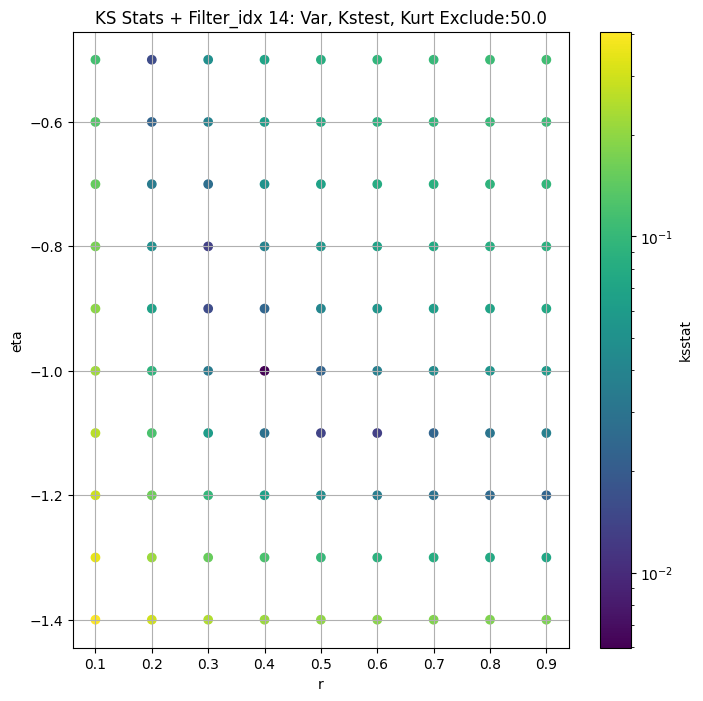

####
Filter_idx  15


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 0 0.01943744724433627 5.541140461143524


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 50 0.019400611562293224 5.369889187277045


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 100 0.01940725276843963 5.284717232374583


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 200 0.01962820560198797 5.15134986667295
Number of samples: 100000, Without approximation : 196608000.0


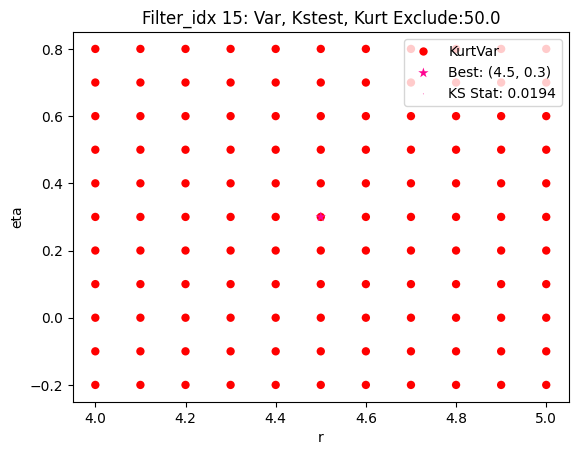

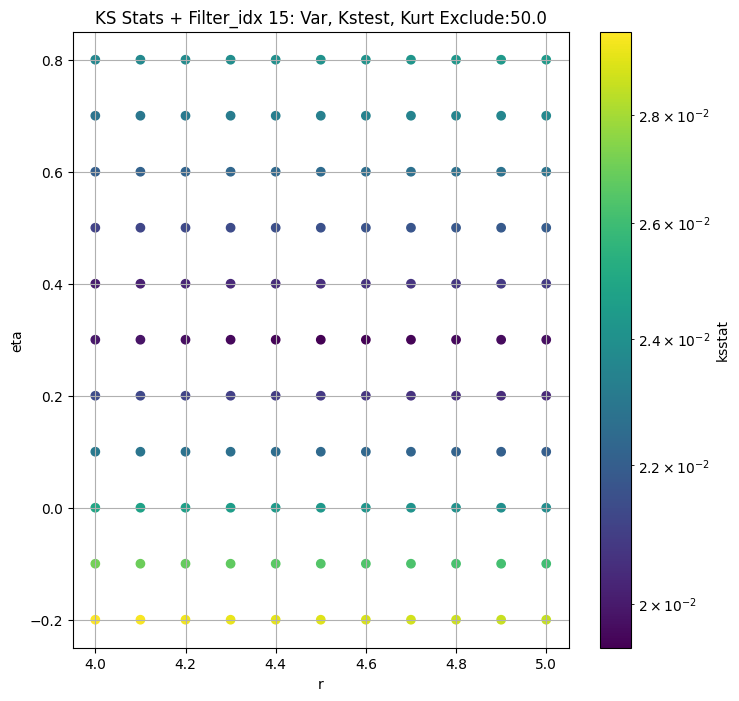

####
Filter_idx  16


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 0 0.012366996875441516 3.685564330396766


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 50 0.01341575095084041 3.2089710549718466


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 100 0.012334661988857548 3.0388773427352627


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 200 0.014235281310409631 2.8017564939292603
Number of samples: 100000, Without approximation : 196608000.0


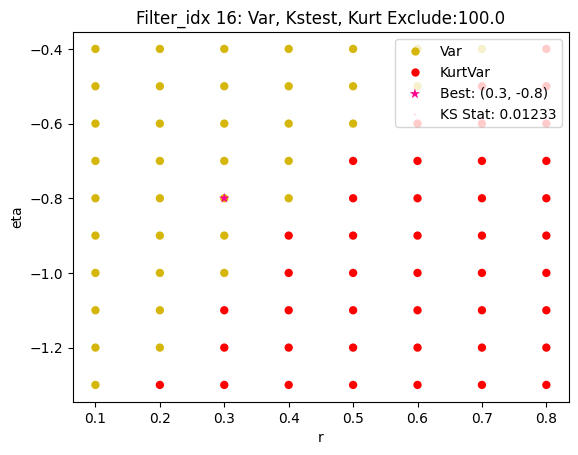

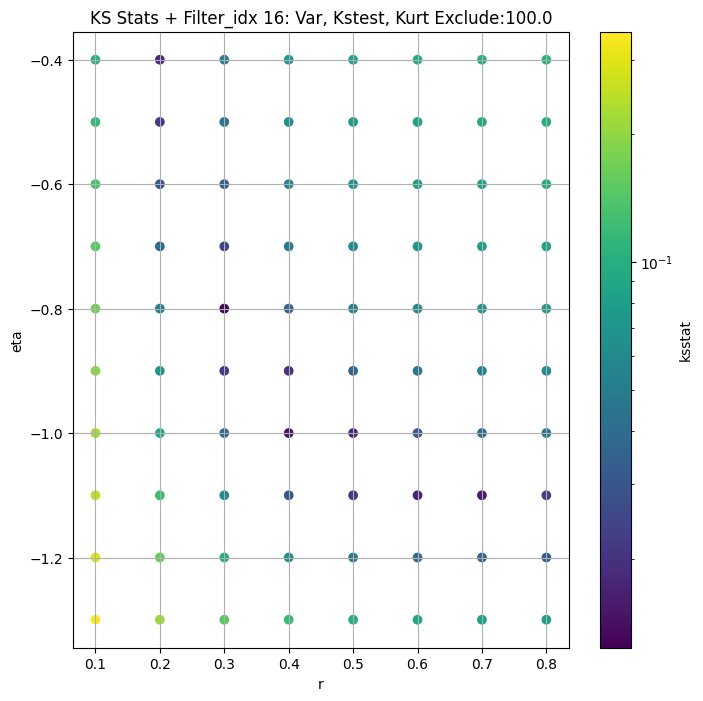

####
Filter_idx  17


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 0 0.01810279134437709 5.512060098087606


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 50 0.014873200980231926 5.146219847506675


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 100 0.012847890841177767 4.942115727230216


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 200 0.015457187261504385 4.6230127146411135
Number of samples: 100000, Without approximation : 196608000.0


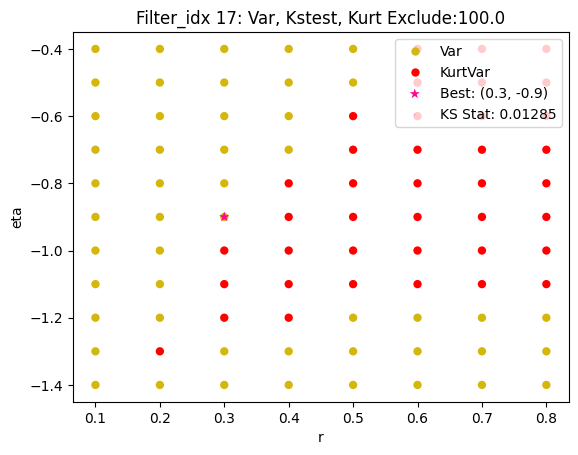

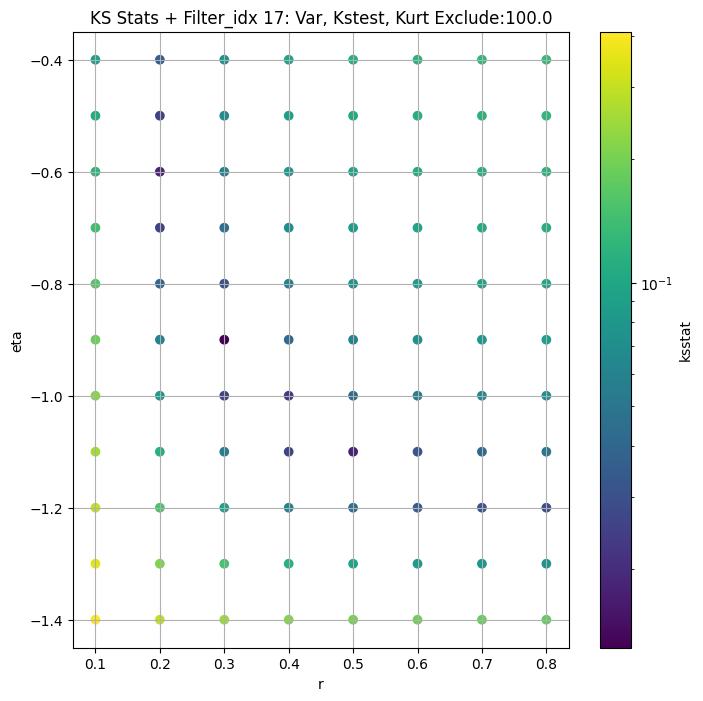

####
Filter_idx  18


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 0 0.00986722305601162 2.7819095130280544


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 50 0.009574090781739444 2.3658861923778622


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 100 0.009055094363758287 2.2218846847040954


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 200 0.009703752566946888 2.0257579077926353
Number of samples: 100000, Without approximation : 196608000.0


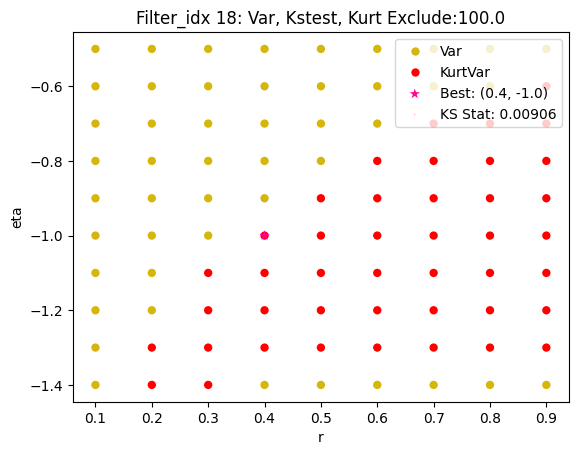

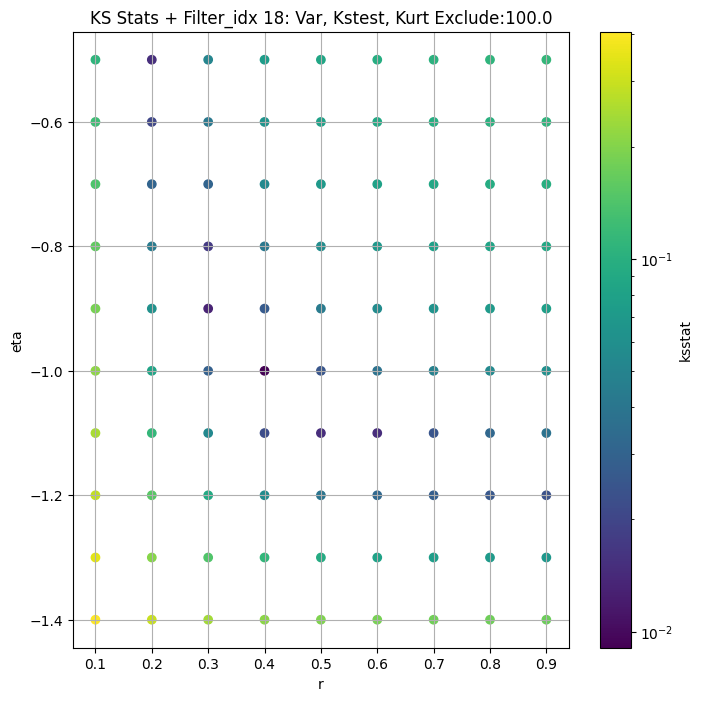

####
Filter_idx  19


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 0 0.021610317032869475 8.81050758335045


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 50 0.021627544274268606 8.554244680374586


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 100 0.021845527753790894 8.413143617322097


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 200 0.02202255341375392 8.186926282687265
Number of samples: 100000, Without approximation : 196608000.0


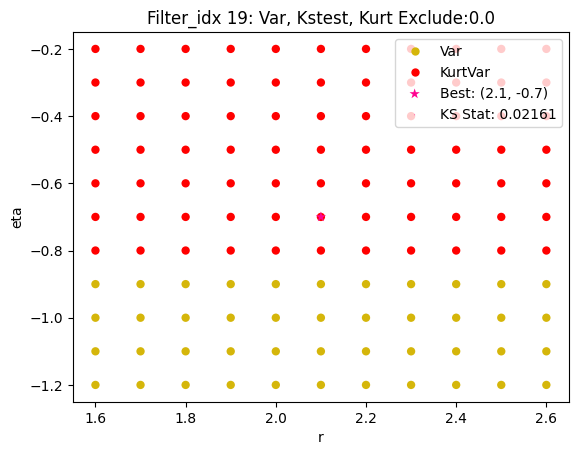

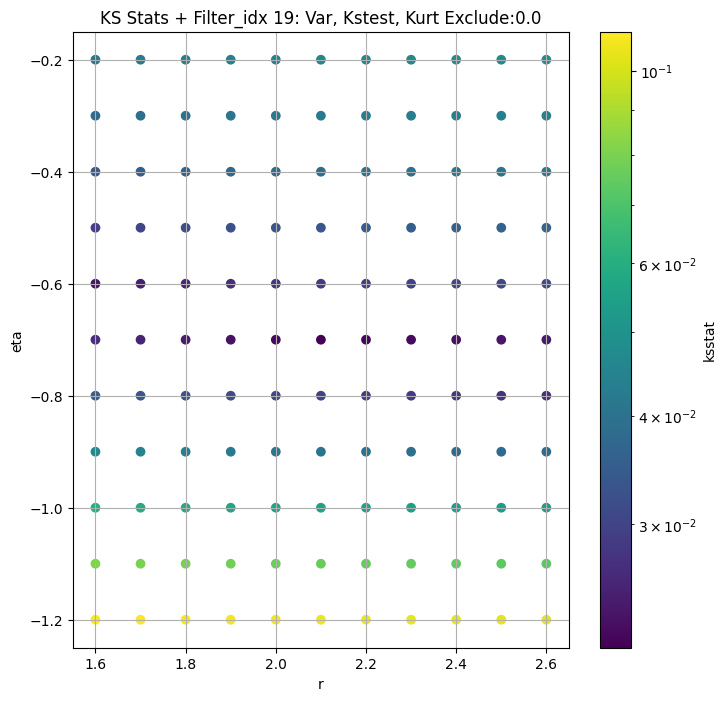

####
Filter_idx  20


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 0 0.007457507507313166 6.5114604403666325


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 50 0.009118223822629987 5.899504512046723


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 100 0.010573834931396742 5.614335926473939


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 200 0.008472526910690448 5.18816543856121
Number of samples: 100000, Without approximation : 196608000.0


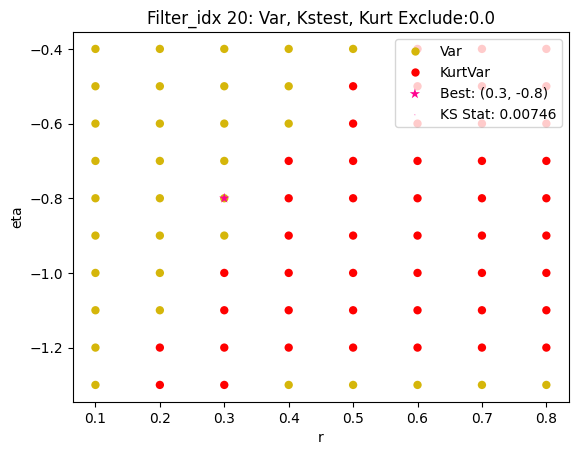

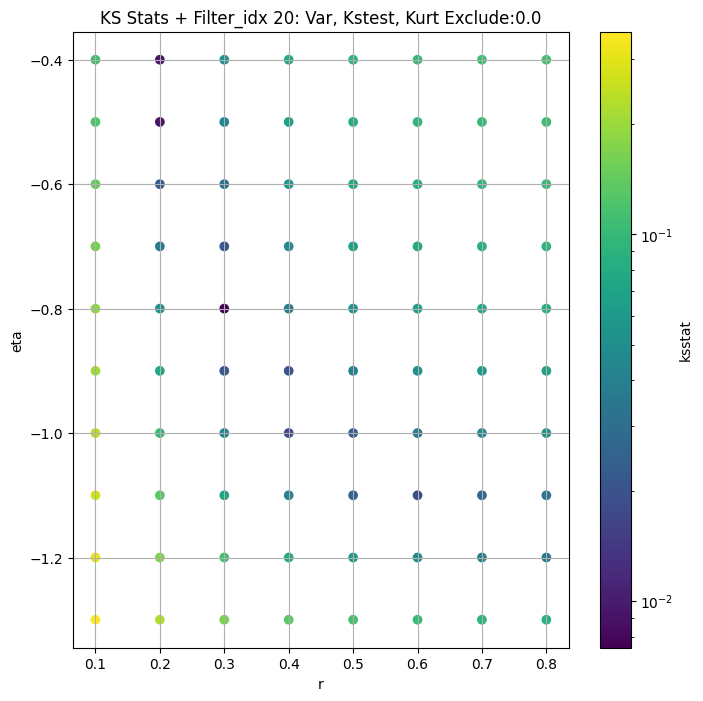

####
Filter_idx  21


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 0 0.025949683567903392 16.940987670424363


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 50 0.02620739686515061 16.369343246622492


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 100 0.026401586289987122 16.084409564393315


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 200 0.028929710715365098 15.640029300630593
Number of samples: 100000, Without approximation : 196608000.0


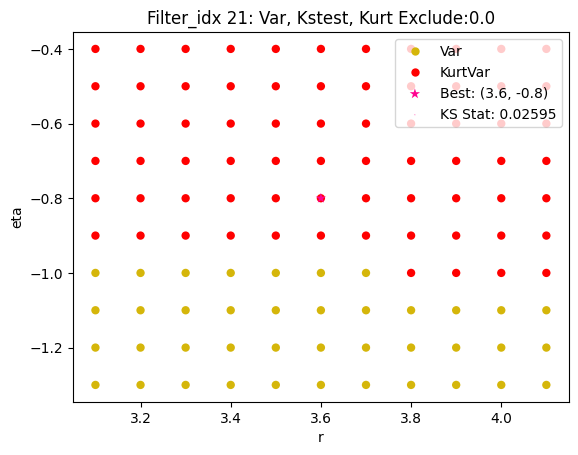

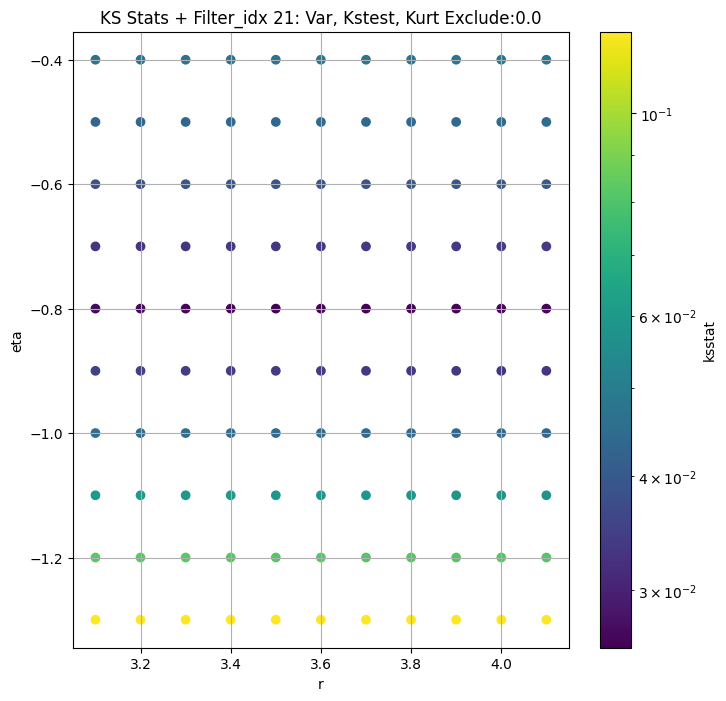

####
Filter_idx  22


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 0 0.008181127884008599 4.190189072064269


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 50 0.006945991661347475 3.78867657529266


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 100 0.009292241614529573 3.599355085320618


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 200 0.009911965033172598 3.3266938424596497
Number of samples: 100000, Without approximation : 196608000.0


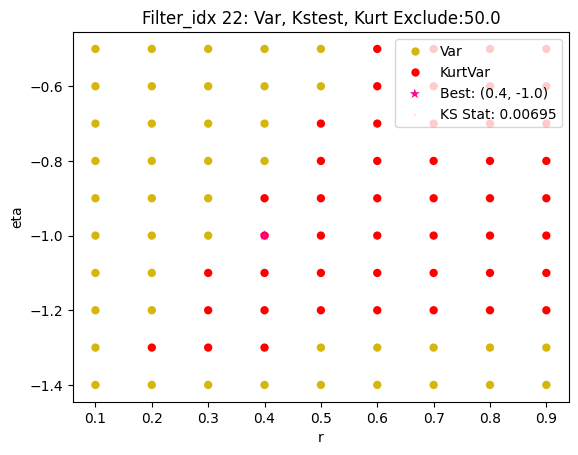

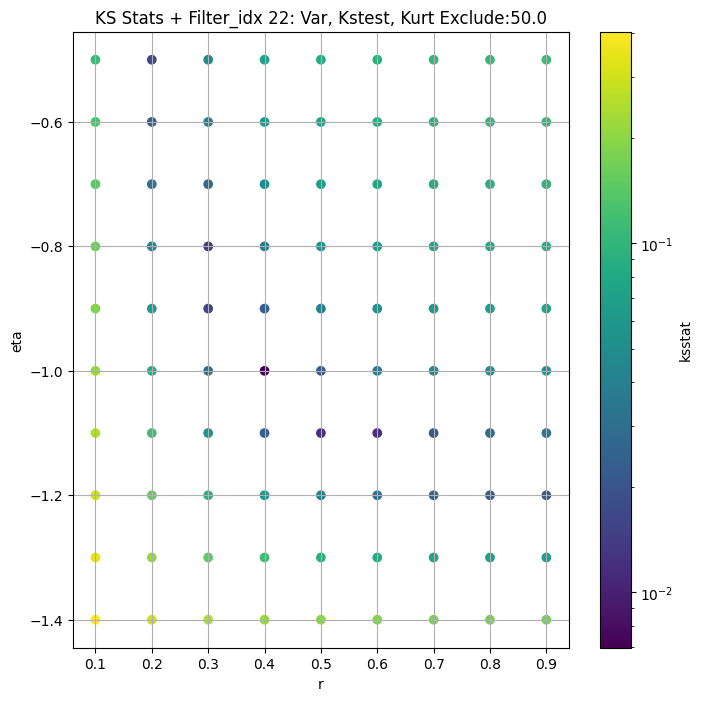

####
Filter_idx  23


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 0 0.008681934284973214 3.1143944590416934


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 50 0.009790686080246094 2.7637995154881123


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 100 0.009225319897159134 2.629051660319697


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 200 0.00965647746075015 2.4314672419332557
Number of samples: 100000, Without approximation : 196608000.0


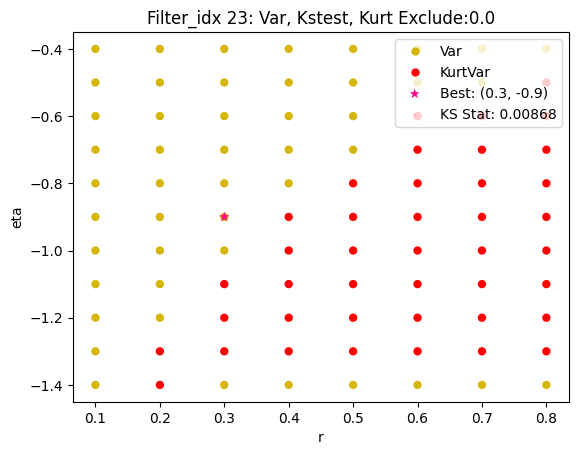

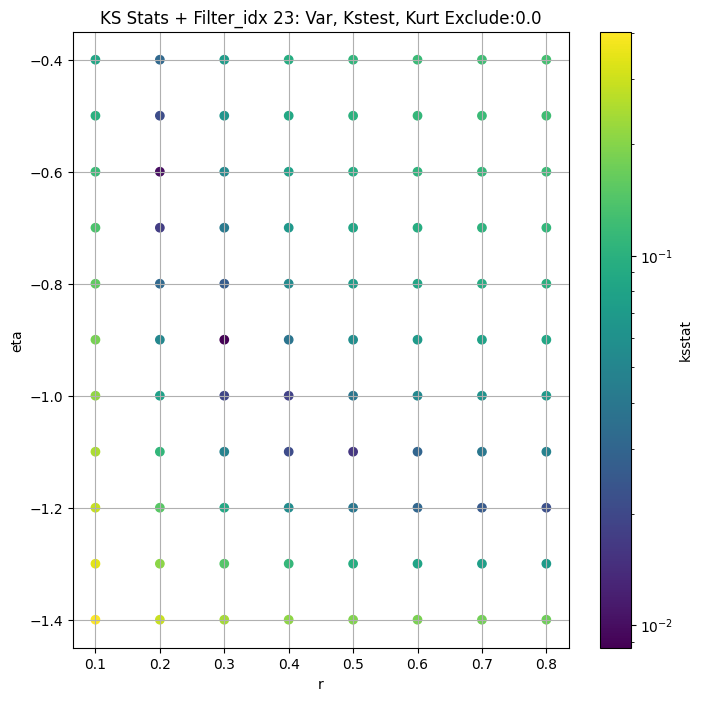

####
Filter_idx  24


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 0 0.010867777481238461 3.638220124930815


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 50 0.013518086904224513 3.1523382473182964


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 100 0.011651590355998498 2.9537947119746715


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 200 0.012430902993024628 2.6761941007963514
Number of samples: 100000, Without approximation : 196608000.0


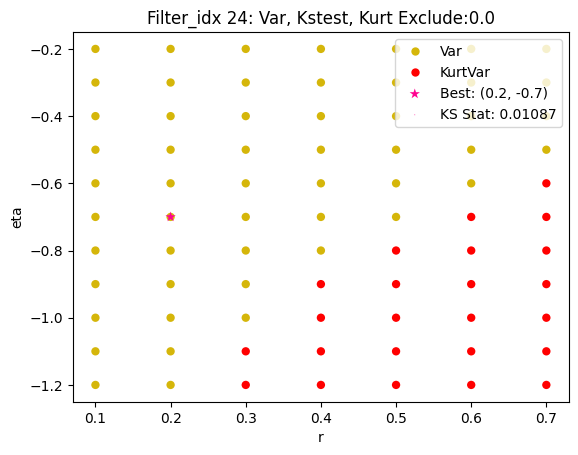

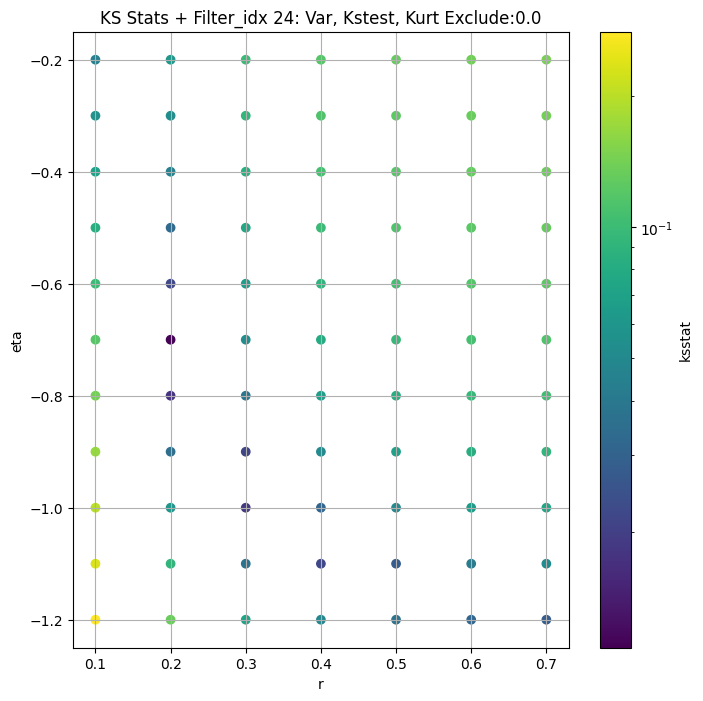

####
Filter_idx  25


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 0 0.008913847507116102 5.047052985853809


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 50 0.010975971825660902 4.455330230708685


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 100 0.01392163914135014 4.206298438769095


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 200 0.013266595130001724 3.858175682311349
Number of samples: 100000, Without approximation : 196608000.0


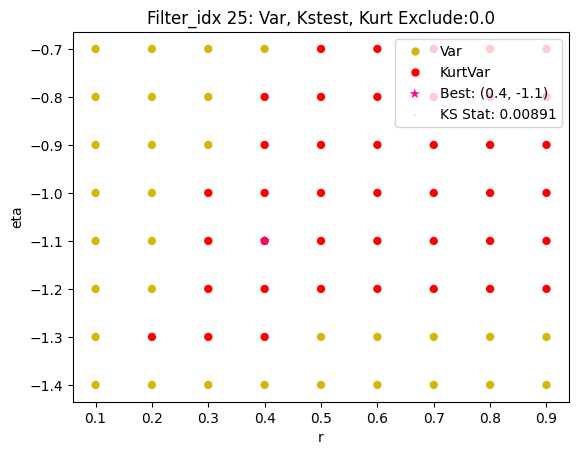

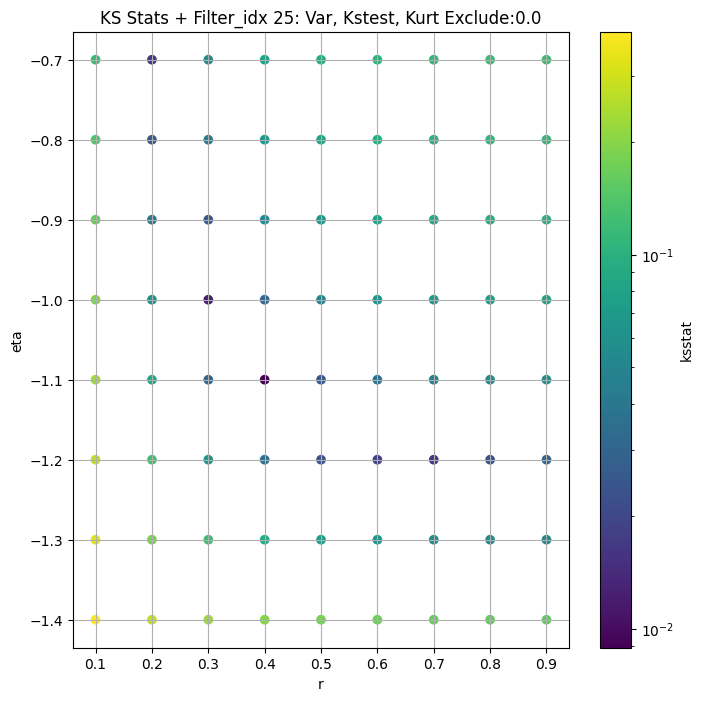

####
Filter_idx  26


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 0 0.009932919173884946 3.6602117946603467


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 50 0.012789696344941814 3.345636714197064


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 100 0.013870579045370257 3.2166087058191604


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 200 0.01389800068531033 3.026032882547474
Number of samples: 100000, Without approximation : 196608000.0


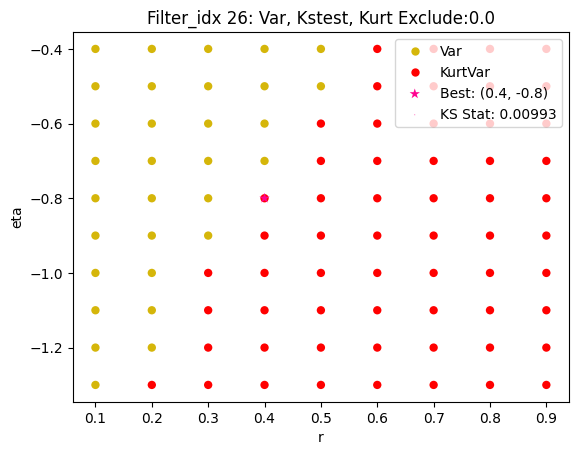

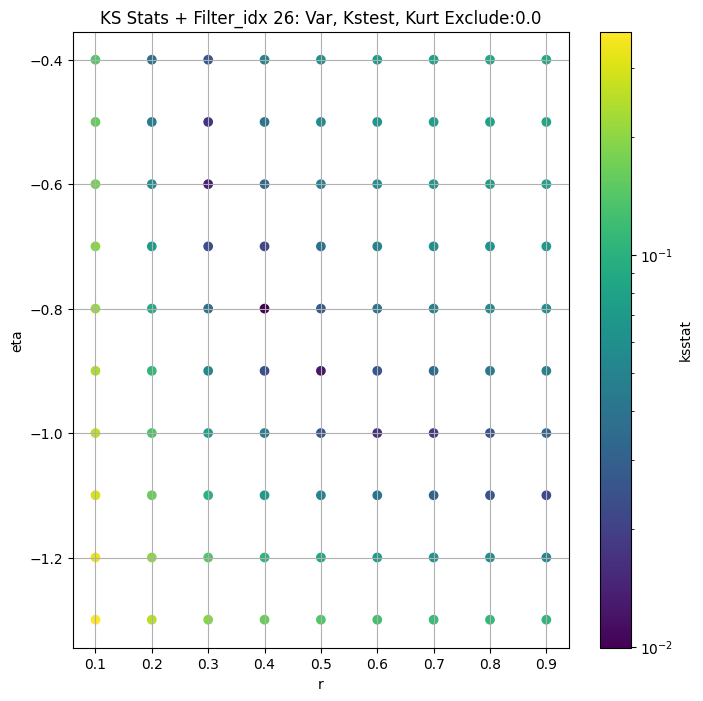

####
Filter_idx  27


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 0 0.017415270735012117 3.254640355051365


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 50 0.013035117463242929 2.7889635309225795


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 100 0.011358993303765996 2.61369934151101


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 200 0.013783886024906697 2.374295937466964
Number of samples: 100000, Without approximation : 196608000.0


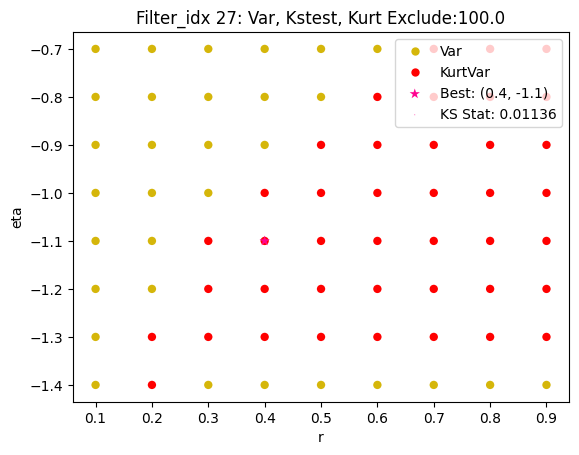

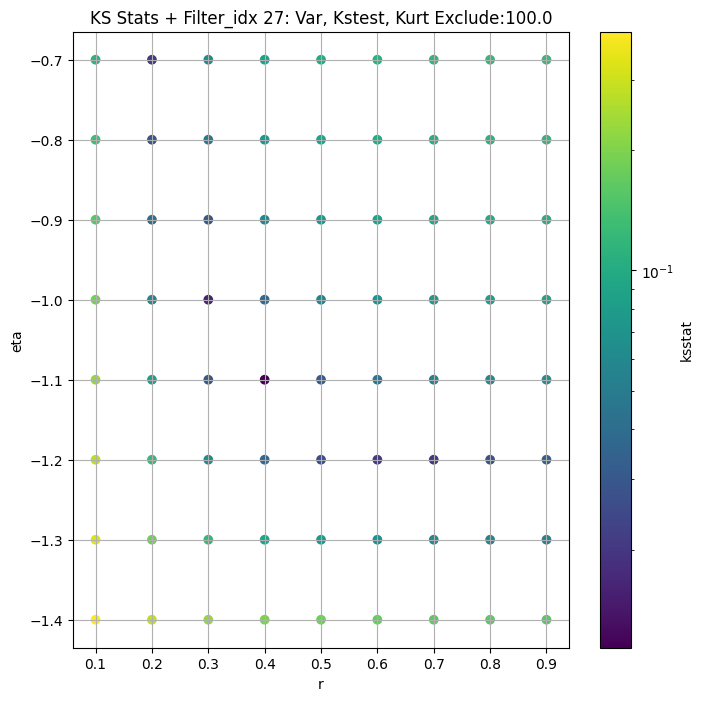

####
Filter_idx  28


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 0 0.0067589689319951796 3.895680326926129


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 50 0.01282499307633761 3.3320335137934696


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 100 0.009707719554153504 3.1247451983590144


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 200 0.009894124400724236 2.8343452986608746
Number of samples: 100000, Without approximation : 196608000.0


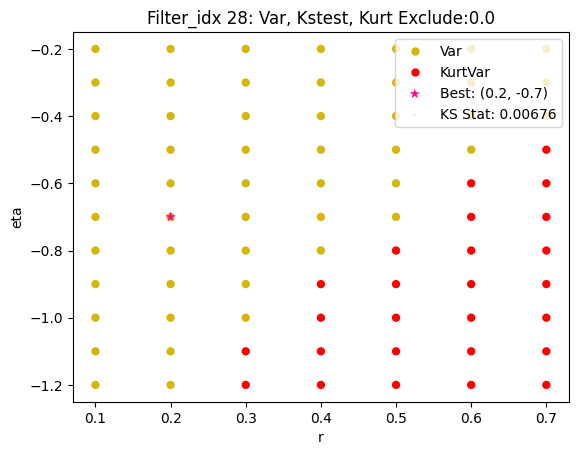

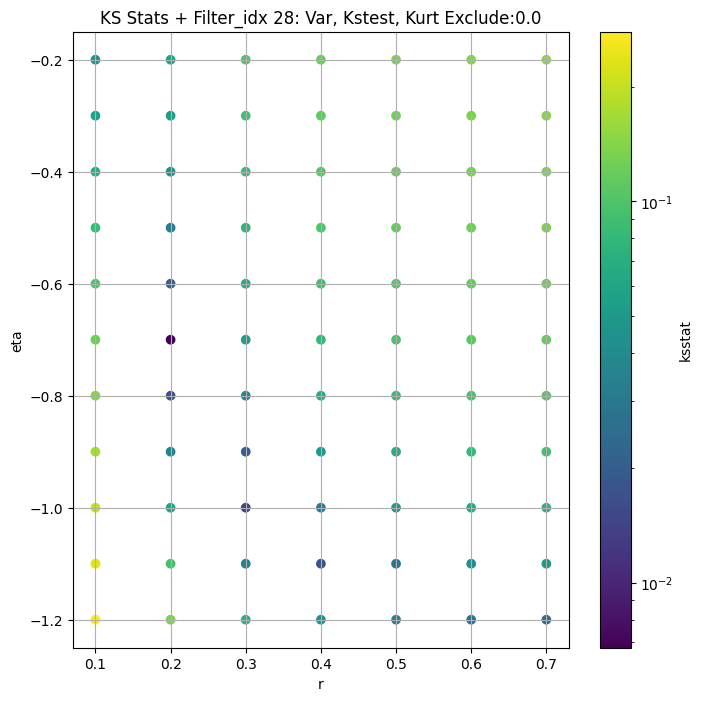

####
Filter_idx  29


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 0 0.018259263964444883 2.239753603079227


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 50 0.01846880211859231 1.9800767798141468


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 100 0.017695994358968792 1.871379851469368


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 200 0.017368004158586248 1.7144724422319957
Number of samples: 100000, Without approximation : 196608000.0


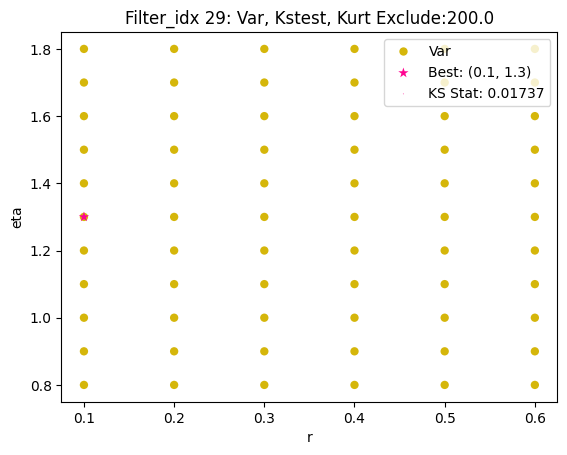

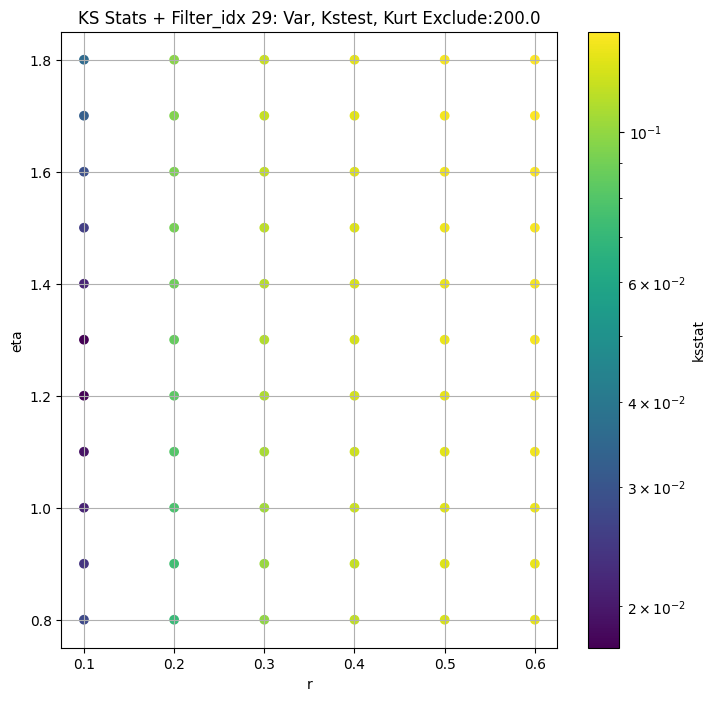

####
Filter_idx  30


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 0 0.011606941399995296 2.929029328316167


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 50 0.012024490486492456 2.5257992994060294


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 100 0.01157466121588041 2.3626928428513625


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 200 0.013169900012571012 2.136078214260093
Number of samples: 100000, Without approximation : 196608000.0


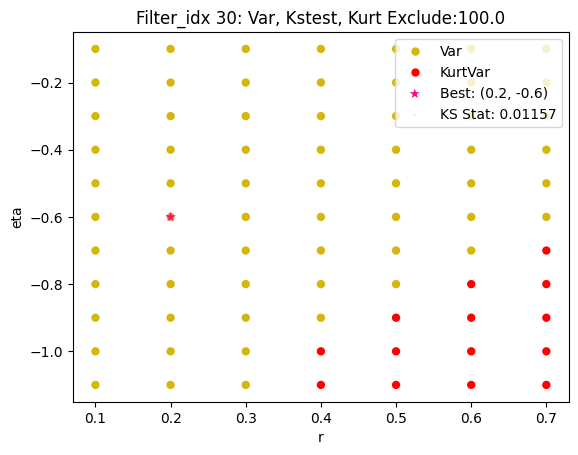

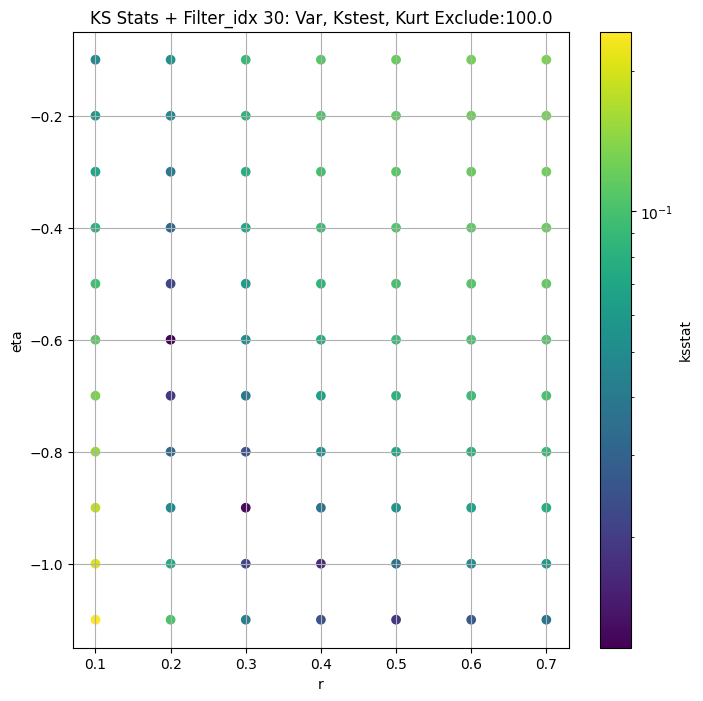

####
Filter_idx  31


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 0 0.012172381994461912 4.122970071977911


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 50 0.012761537383488952 3.8586942162095585


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 100 0.013168565400978688 3.746834418933566


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 200 0.013004805921178766 3.5732761036470095
Number of samples: 100000, Without approximation : 196608000.0


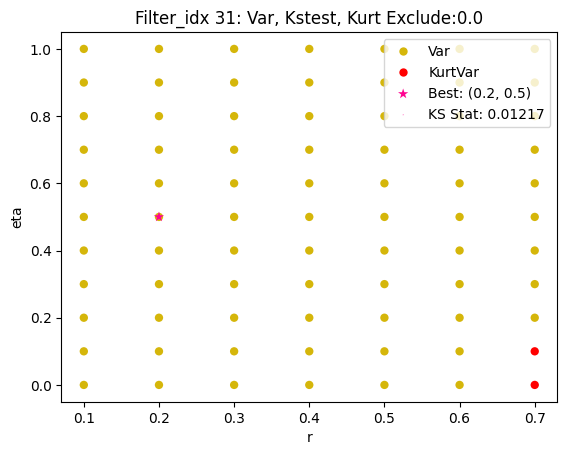

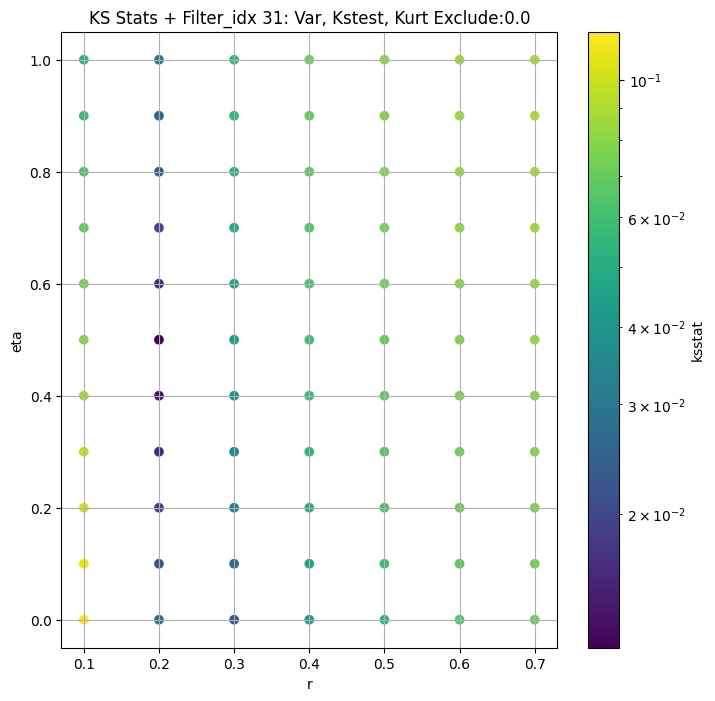

####
Filter_idx  32


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 0 0.007915995500424766 3.016518217170903


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 50 0.006983258858519803 2.6903410728508006


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 100 0.00850631728813911 2.5601107287962113


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 200 0.009801158181179659 2.370286676482524
Number of samples: 100000, Without approximation : 196608000.0


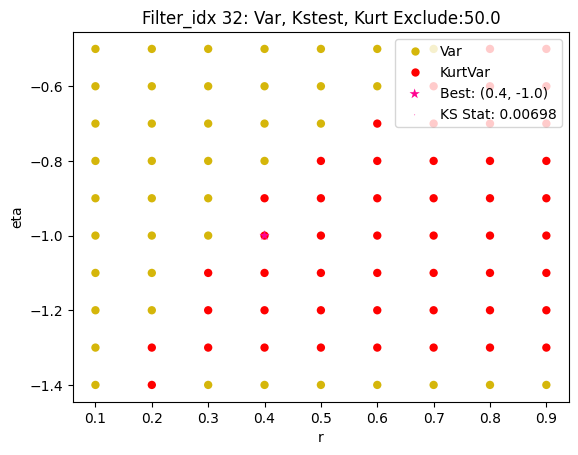

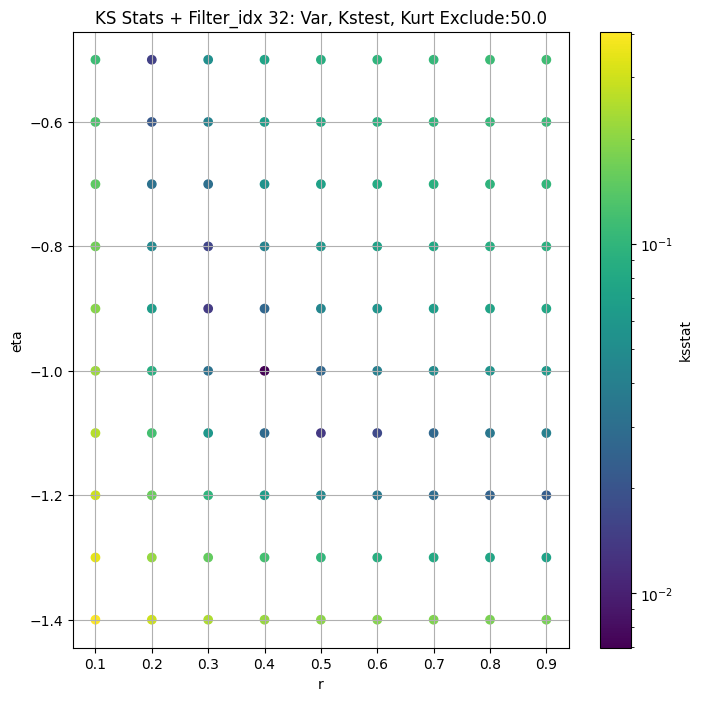

####
Filter_idx  33


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 0 0.012736367916212465 2.58507661663736


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 50 0.010032811629223204 2.238428800598162


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 100 0.011540574195696152 2.105233886218333


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 200 0.00967900416295342 1.9232853770035812
Number of samples: 100000, Without approximation : 196608000.0


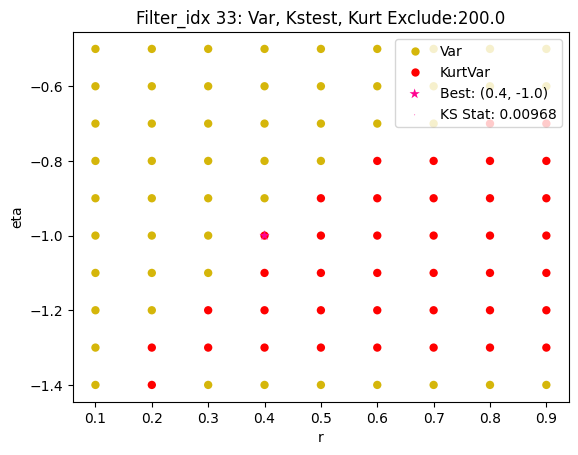

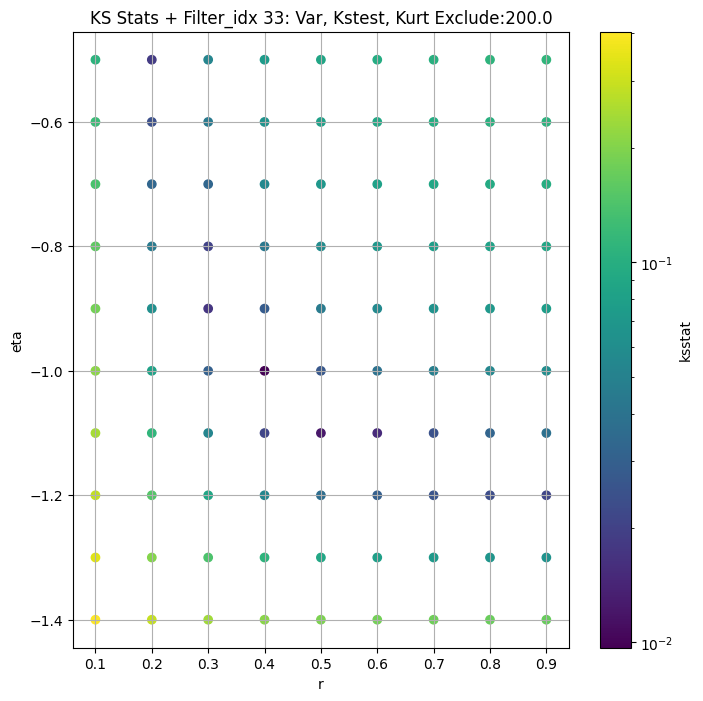

####
Filter_idx  34


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 0 0.009828366188787796 3.145228949590133


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 50 0.013418051689304211 2.70168958940406


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 100 0.011635858979474278 2.53221320794042


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 200 0.009213511355291137 2.2942735603272144
Number of samples: 100000, Without approximation : 196608000.0


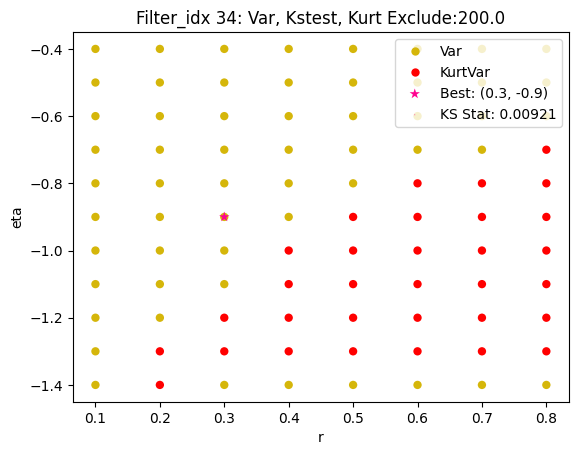

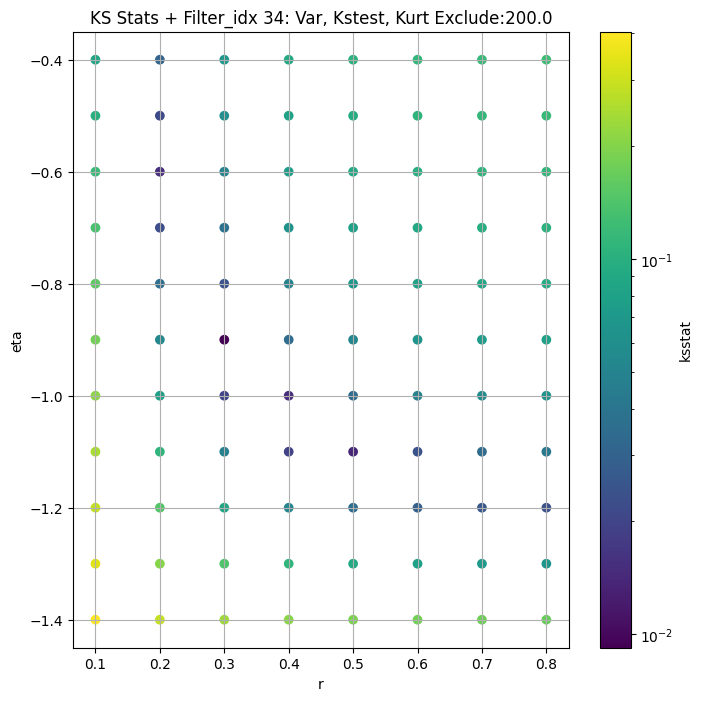

####
Filter_idx  35


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 0 0.007658946767844482 13.84805788323212


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 50 0.008600468831813993 13.469112087947366


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 100 0.009820536842445562 13.251630537536299


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 200 0.011653242451100887 12.90750874476366
Number of samples: 100000, Without approximation : 196608000.0


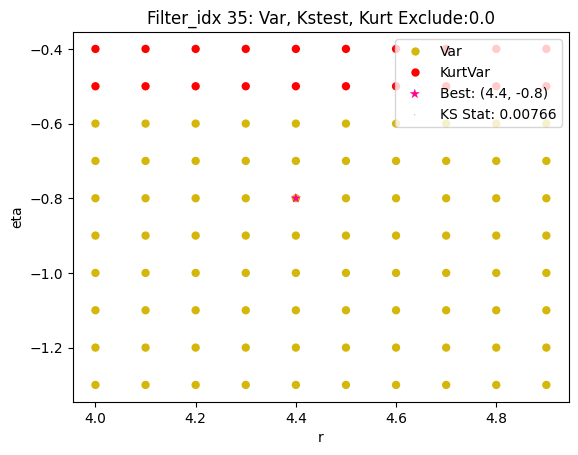

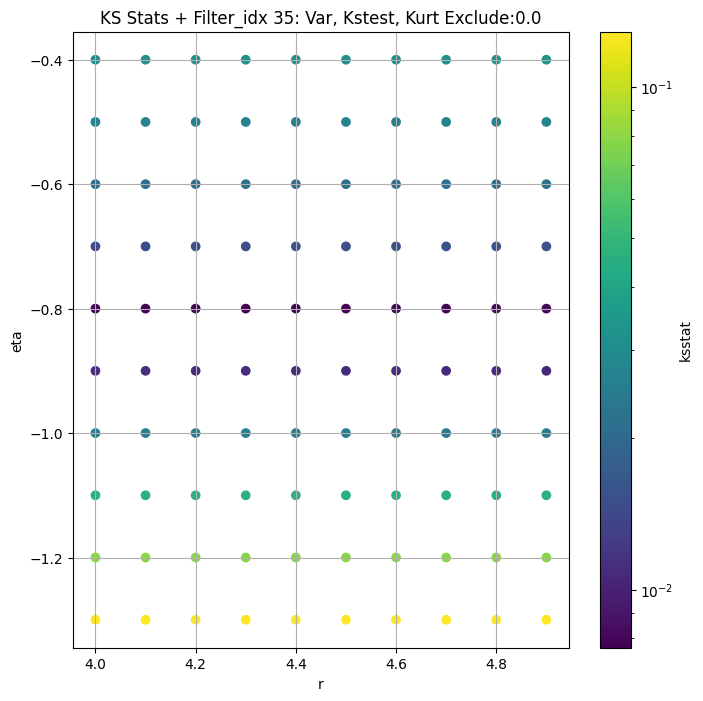

####
Filter_idx  36


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 0 0.007254045015997565 7.040786253131293


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 50 0.007557766580901126 6.81719771844464


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 100 0.0077648656287238604 6.715780505280026


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 200 0.009133811202274578 6.555083249490708
Number of samples: 100000, Without approximation : 196608000.0


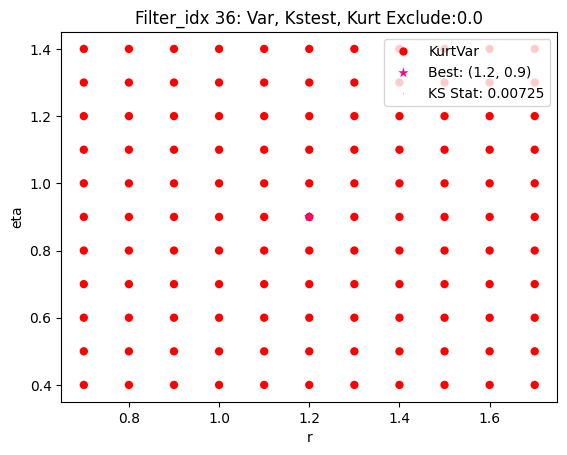

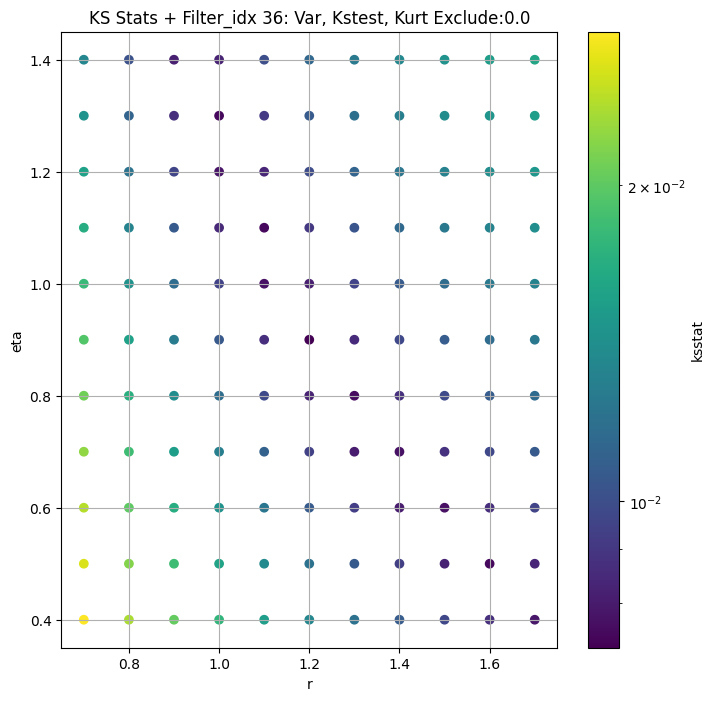

####
Filter_idx  37


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 0 0.02056194396131006 15.200028728462916


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 50 0.021486513077426356 14.688876096413253


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 100 0.023115751228361764 14.426241398401519


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 200 0.02381511608048456 14.017733670177453
Number of samples: 100000, Without approximation : 196608000.0


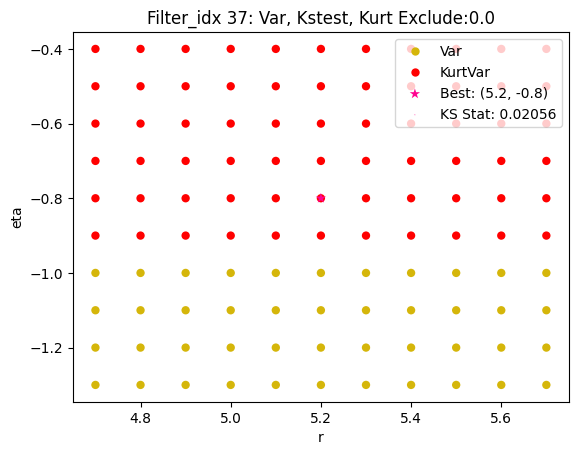

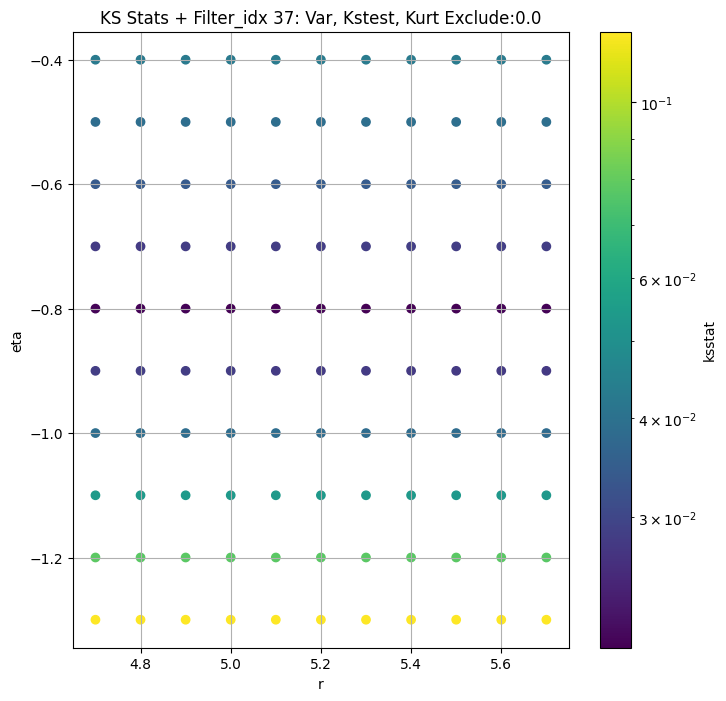

####
Filter_idx  38


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 0 0.01002787043052017 6.32019143295072


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 50 0.012811546746819558 5.794936895028381


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 100 0.014317620226179995 5.552774354418197


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 200 0.01175372560734278 5.191027248289876
Number of samples: 100000, Without approximation : 196608000.0


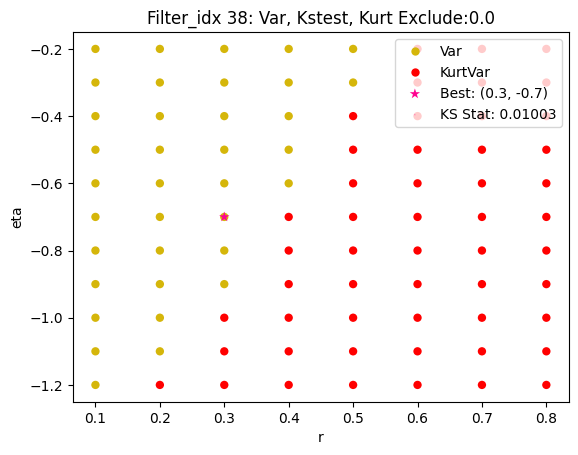

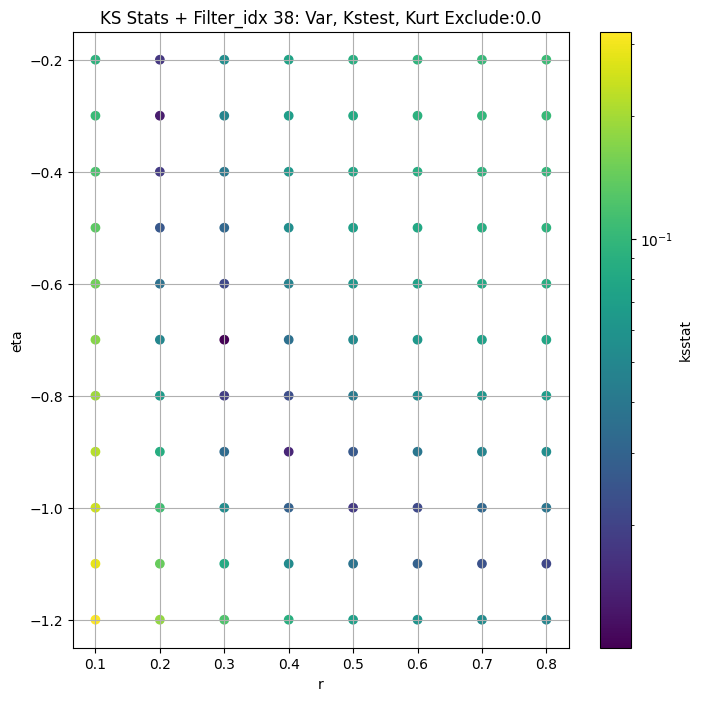

####
Filter_idx  39


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 0 0.013079391136171181 4.7153702362393375


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 50 0.012089152428418015 4.391781818982652


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 100 0.012709705452500497 4.256091552153781


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 200 0.013190606682249917 4.049582631842661
Number of samples: 100000, Without approximation : 196608000.0


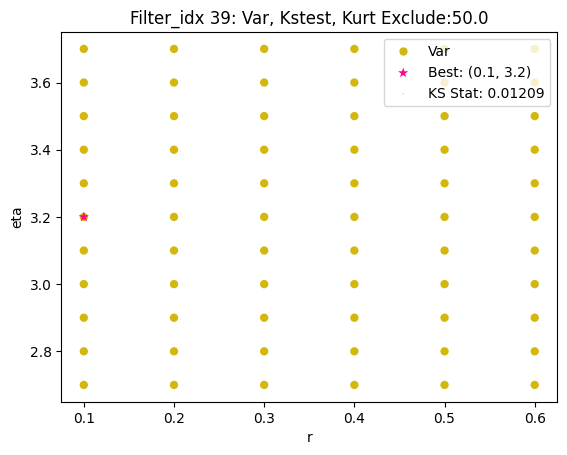

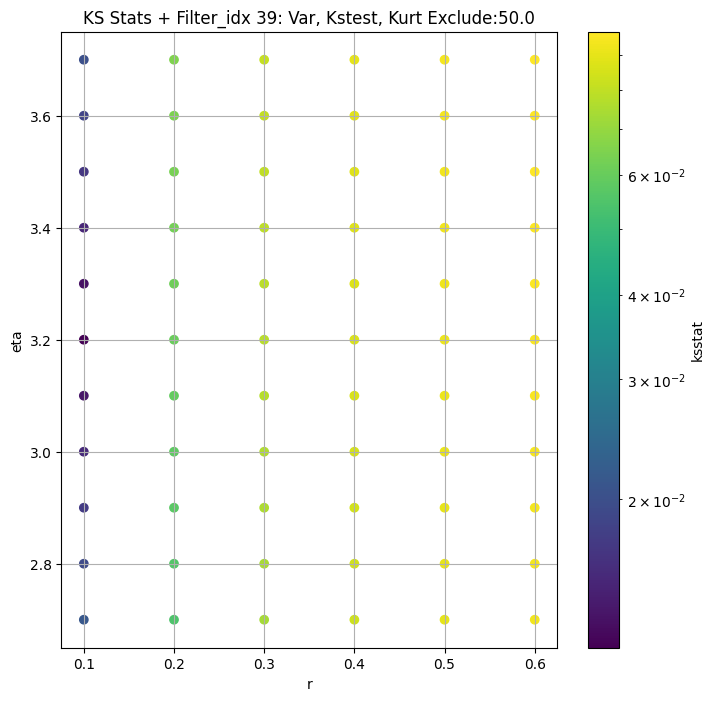

####
Filter_idx  40


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 0 0.029995395346414155 5.621045718093805


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 50 0.029995660364928622 5.44610671941782


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 100 0.029995686116898623 5.367712274866881


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 200 0.029998239465483356 5.242801356105279
Number of samples: 100000, Without approximation : 196608000.0


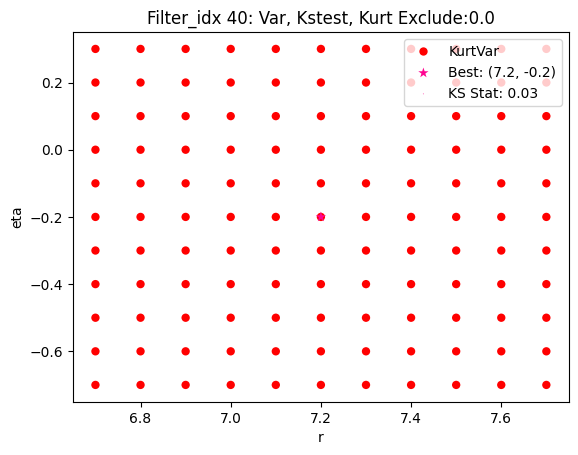

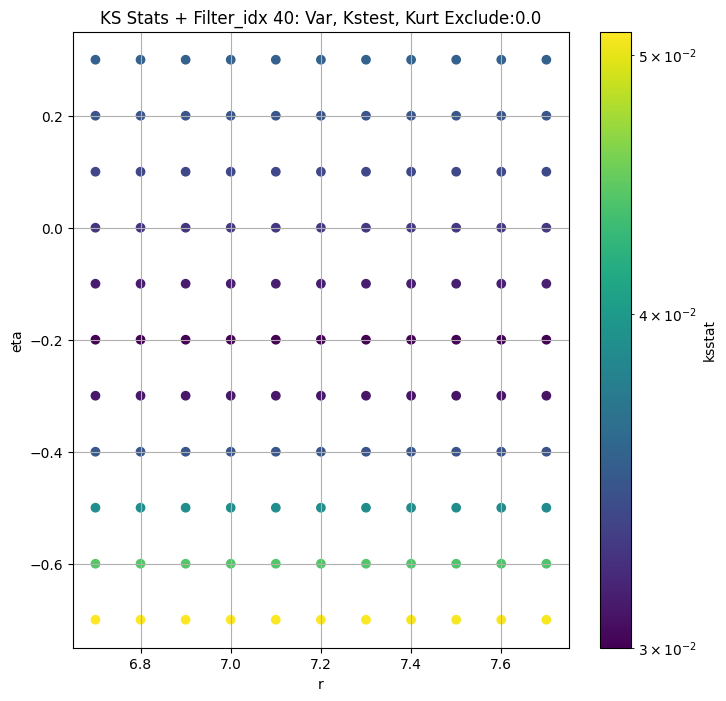

####
Filter_idx  41


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 0 0.007018769454424478 3.005167781922227


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 50 0.008104292791096424 2.593211531395669


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 100 0.008489266141630092 2.439005180491382


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 200 0.010162520990515664 2.2283825758655795
Number of samples: 100000, Without approximation : 196608000.0


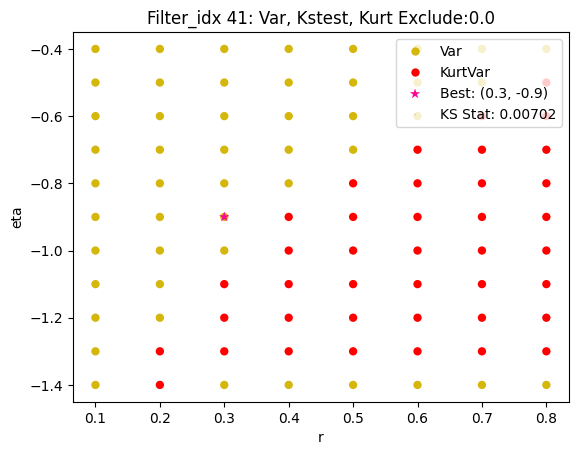

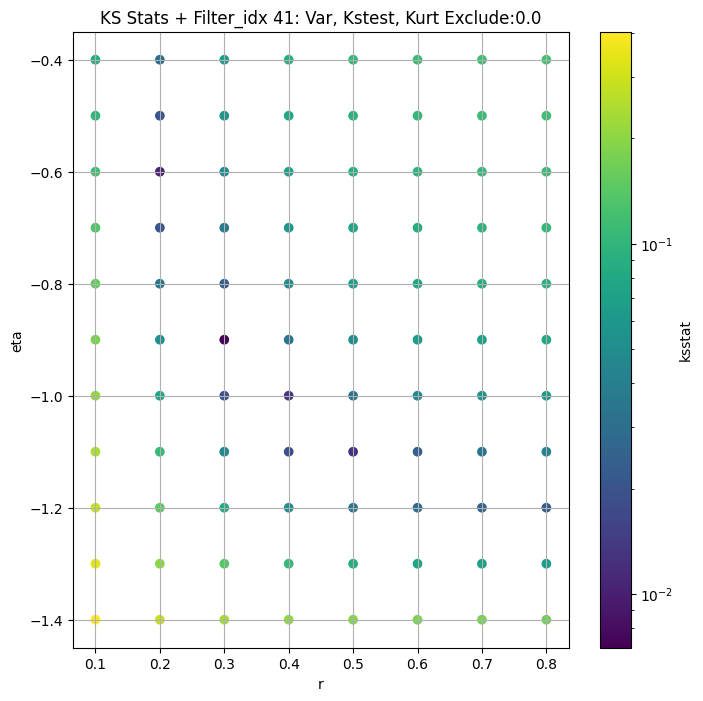

####
Filter_idx  42


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 0 0.011743725144282458 7.697337580804665


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 50 0.013102330188311084 6.922669176053803


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 100 0.011719675339974922 6.547793064205199


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 200 0.01307437514955928 5.983682372920219
Number of samples: 100000, Without approximation : 196608000.0


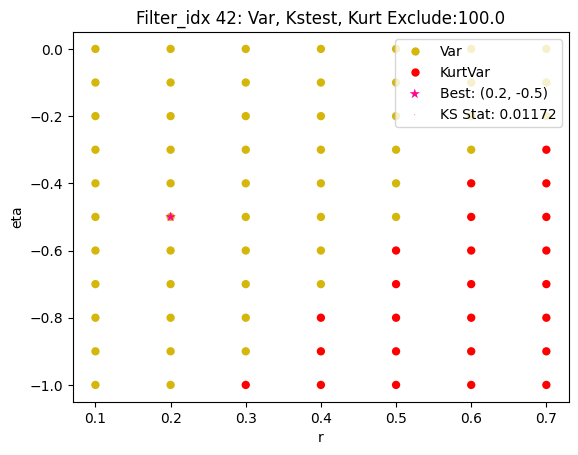

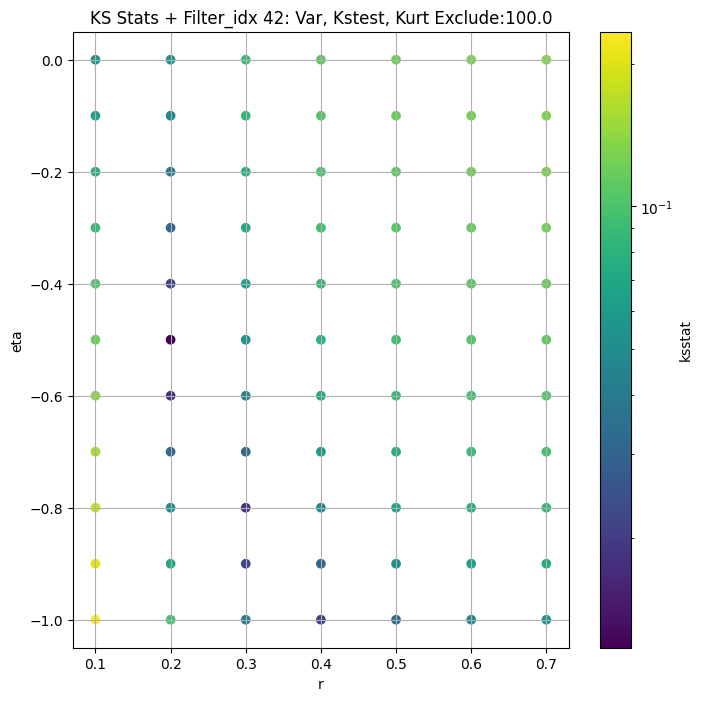

####
Filter_idx  43


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 0 0.007367478764263802 2.7609431928221473


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 50 0.010644164200841522 2.519659866493037


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 100 0.008639835319159683 2.4083114339180116


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 200 0.007911076907704206 2.243353011499737
Number of samples: 100000, Without approximation : 196608000.0


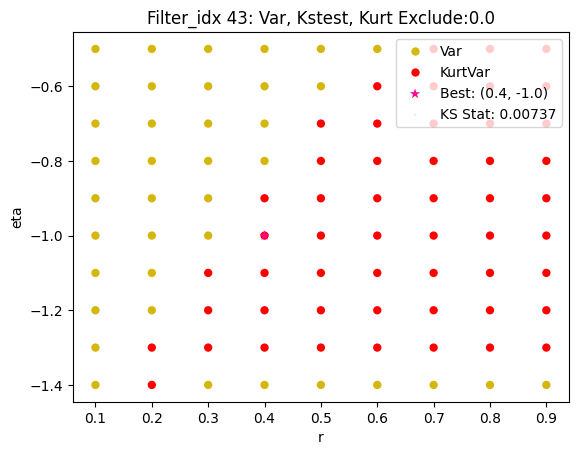

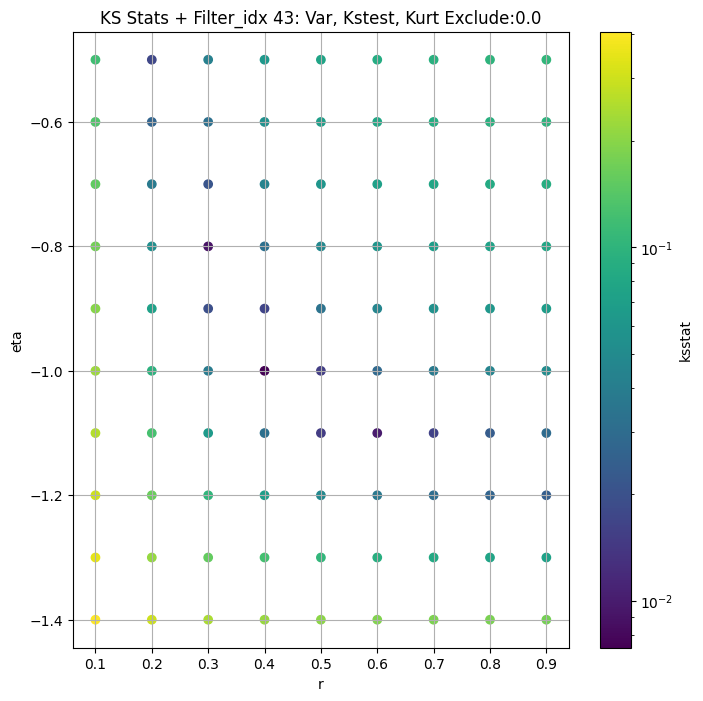

####
Filter_idx  44


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 0 0.009312901134278295 6.248442544266474


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 50 0.0067834023562839685 5.612621677556628


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 100 0.009262493871652705 5.327378089232825


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 200 0.008261852142562698 4.905587034148577
Number of samples: 100000, Without approximation : 196608000.0


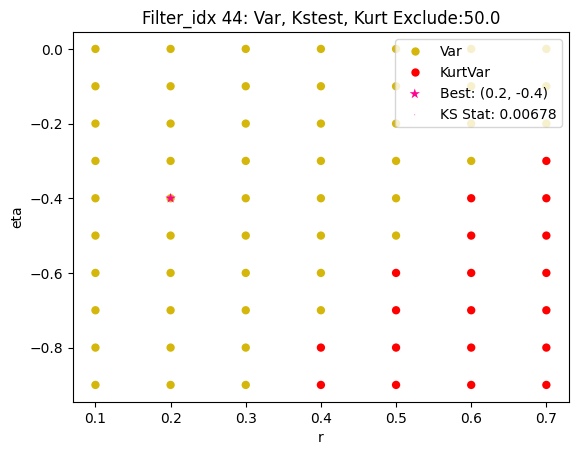

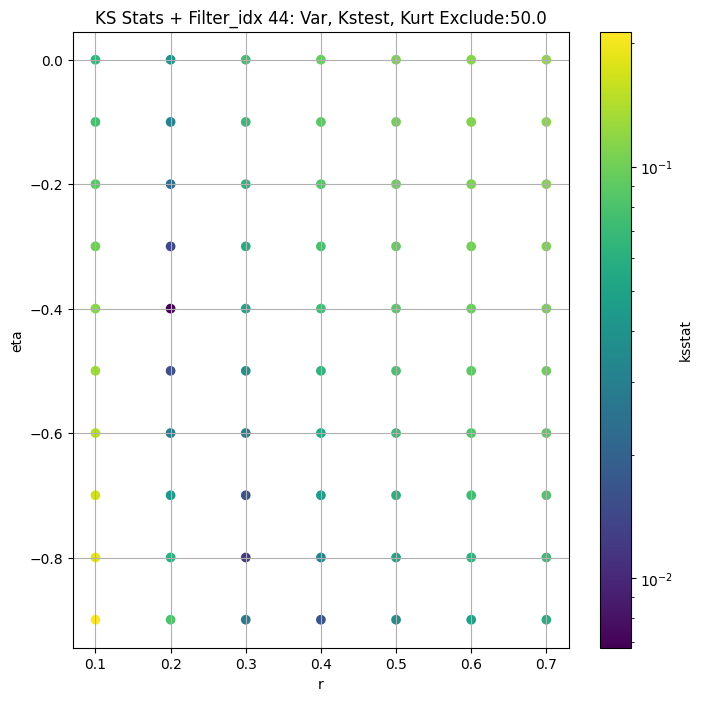

####
Filter_idx  45


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 0 0.019657275723571233 3.3127519106531587


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 50 0.019439287132227423 3.014880425708489


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 100 0.019870368023370277 2.9032161129763345


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 200 0.01984424494111603 2.7324992197968725
Number of samples: 100000, Without approximation : 196608000.0


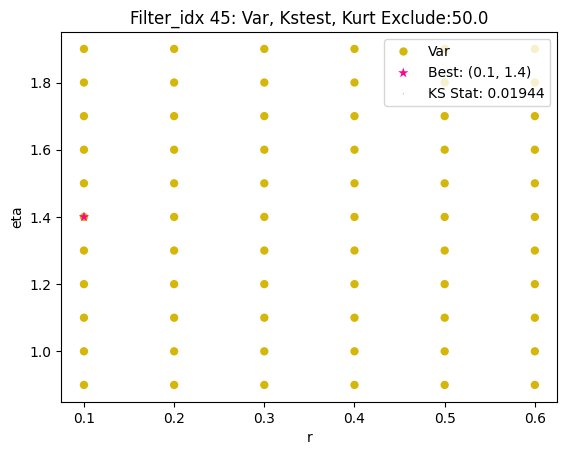

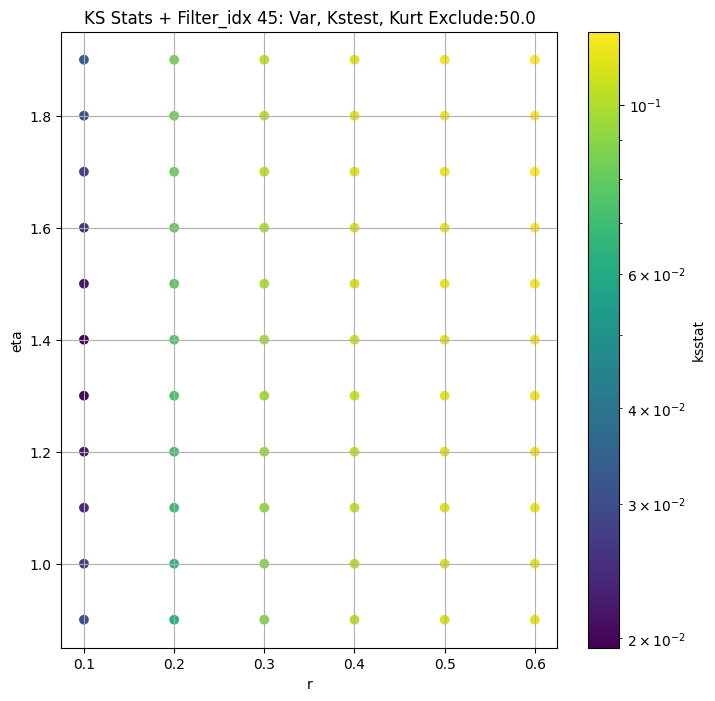

####
Filter_idx  46


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 0 0.011091319330863963 2.4564696872703986


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 50 0.011101090127370261 2.293512587411293


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 100 0.01076129602959297 2.2255661690073505


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 200 0.011071646479940411 2.121041085565547
Number of samples: 100000, Without approximation : 196608000.0


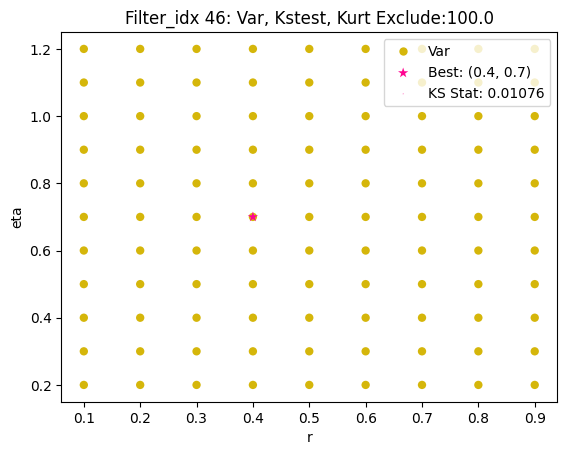

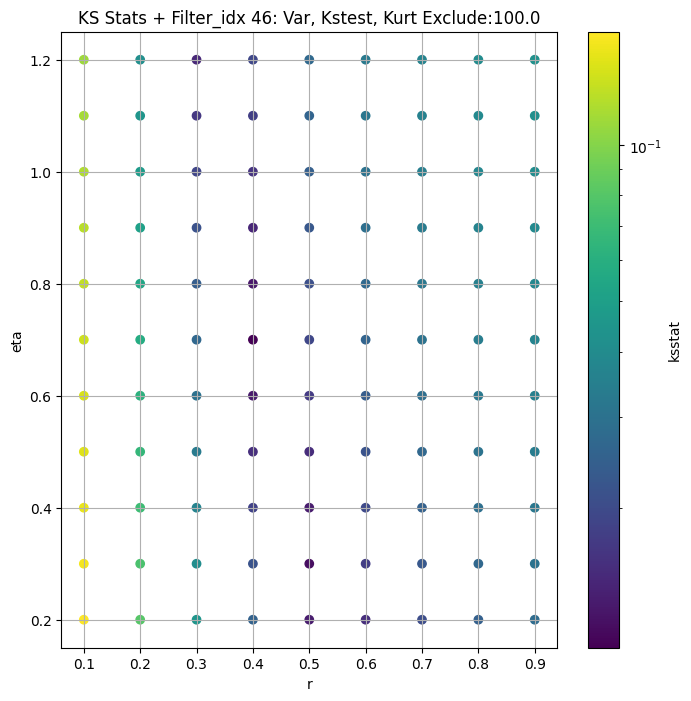

####
Filter_idx  47


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 0 0.007712589290080729 4.659488571959296


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 50 0.01121064919089726 4.2859428985805375


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 100 0.009986160835683822 4.113658366991194


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 200 0.007297722951287985 3.8435933749254763
Number of samples: 100000, Without approximation : 196608000.0


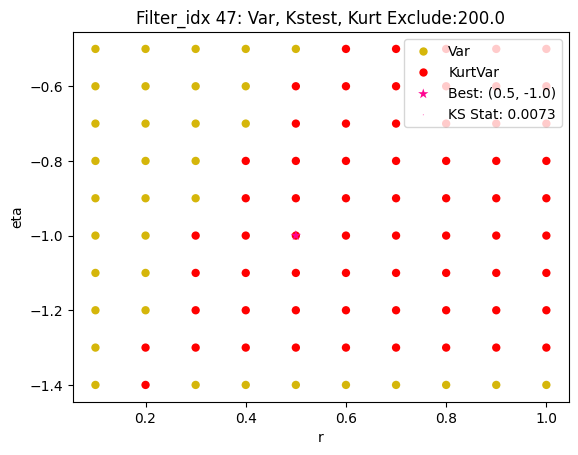

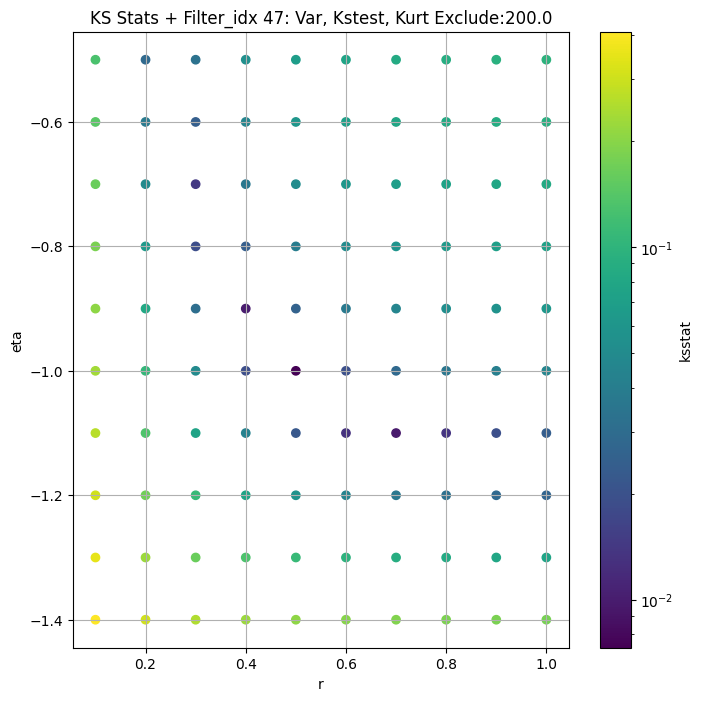

####
Filter_idx  48


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 0 0.012114977607162625 2.924931701551067


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 50 0.012694385998755775 2.607658057187236


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 100 0.011412237419225812 2.4635886728412206


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 200 0.014352801693800266 2.2583805575490814
Number of samples: 100000, Without approximation : 196608000.0


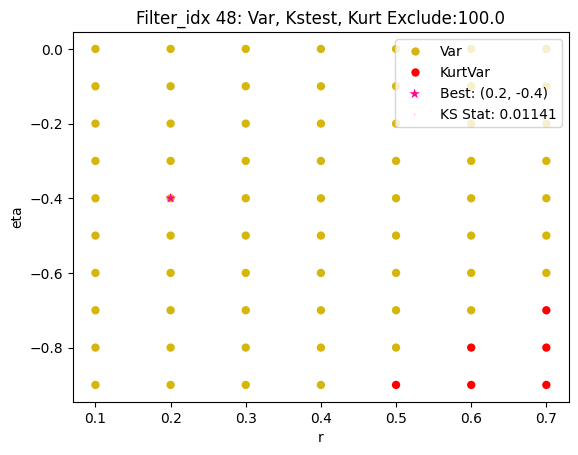

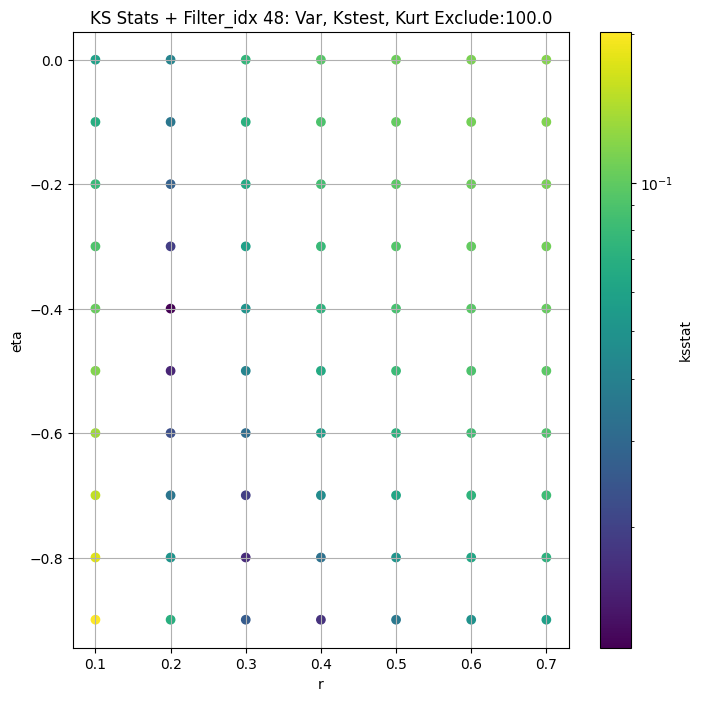

####
Filter_idx  49


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 0 0.0073091707165852116 5.523211620377323


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 50 0.008338328201184297 4.975472564231762


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 100 0.009883795926194483 4.743648622161137


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 200 0.011817914359680826 4.403955888330956
Number of samples: 100000, Without approximation : 196608000.0


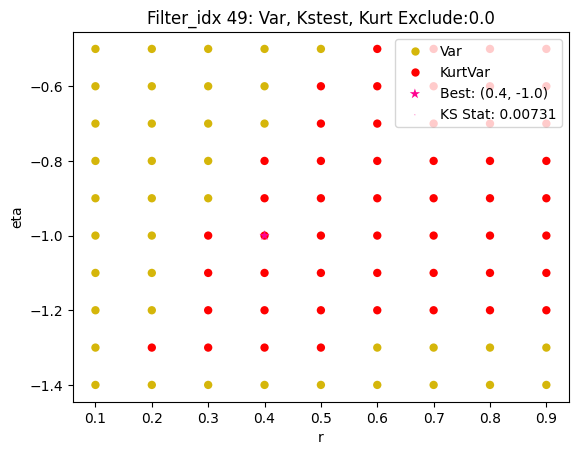

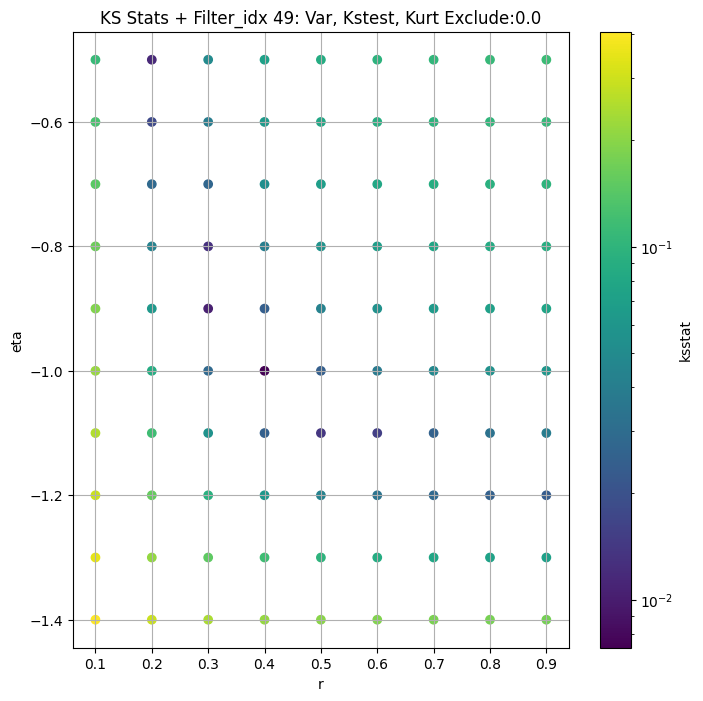

####
Filter_idx  50


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 0 0.00966863542487556 3.382892563601956


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 50 0.009749094100518219 2.9921964120688904


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 100 0.009759717664925116 2.836225144283794


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 200 0.010852361812944189 2.615335534421469
Number of samples: 100000, Without approximation : 196608000.0


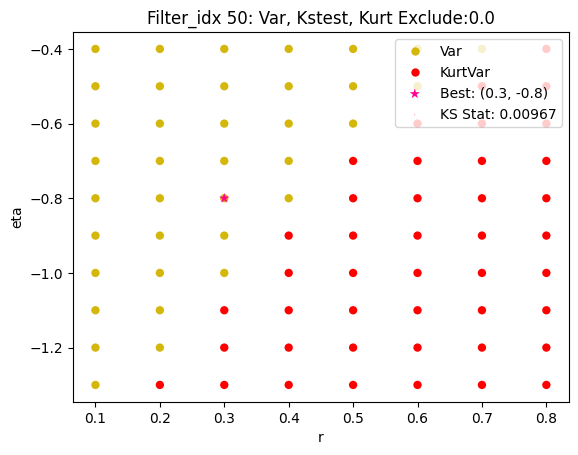

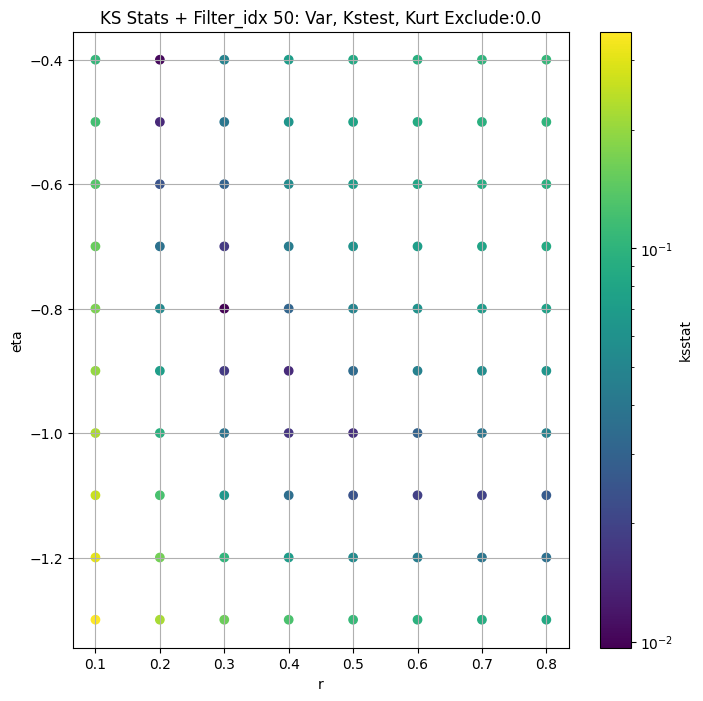

####
Filter_idx  51


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
51 0 0.01988894596493318 7.367633166373575


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
51 50 0.02191560724619429 7.195633905319169


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
51 100 0.022976036619912543 7.107988167269349


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
51 200 0.024706951715557368 6.967483749043263
Number of samples: 100000, Without approximation : 196608000.0


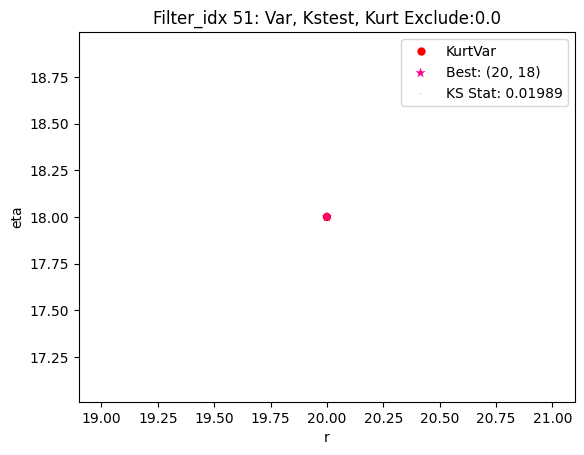

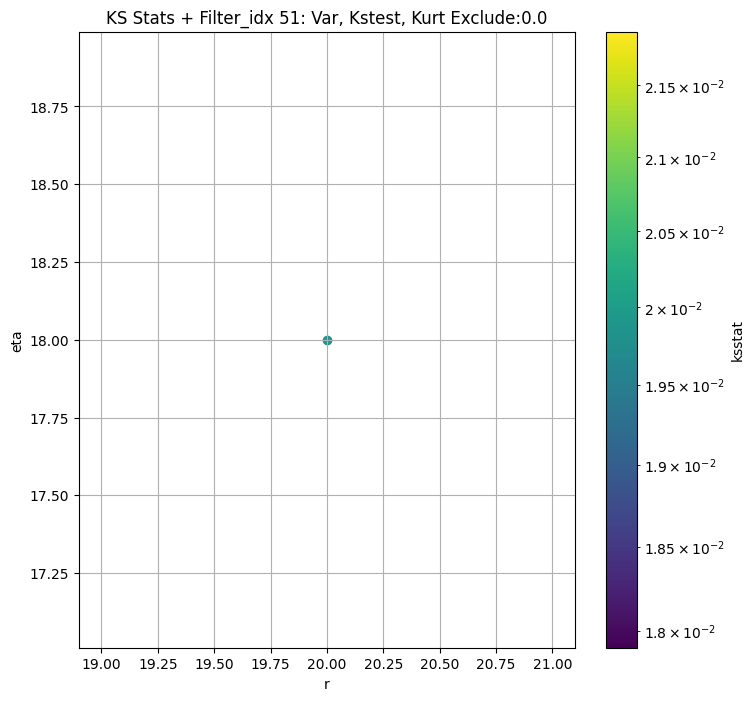

####
Filter_idx  52


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 0 0.03040673685470785 5.293439327262451


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 50 0.030406580937077377 5.098804472821172


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 100 0.03040649083911562 5.022346925461932


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 200 0.030406480510448808 4.901824688273953
Number of samples: 100000, Without approximation : 196608000.0


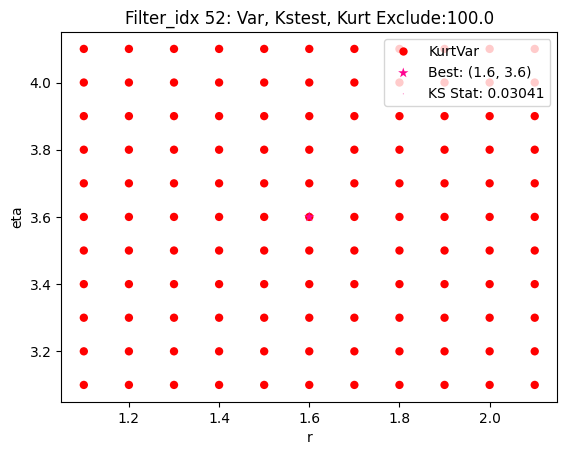

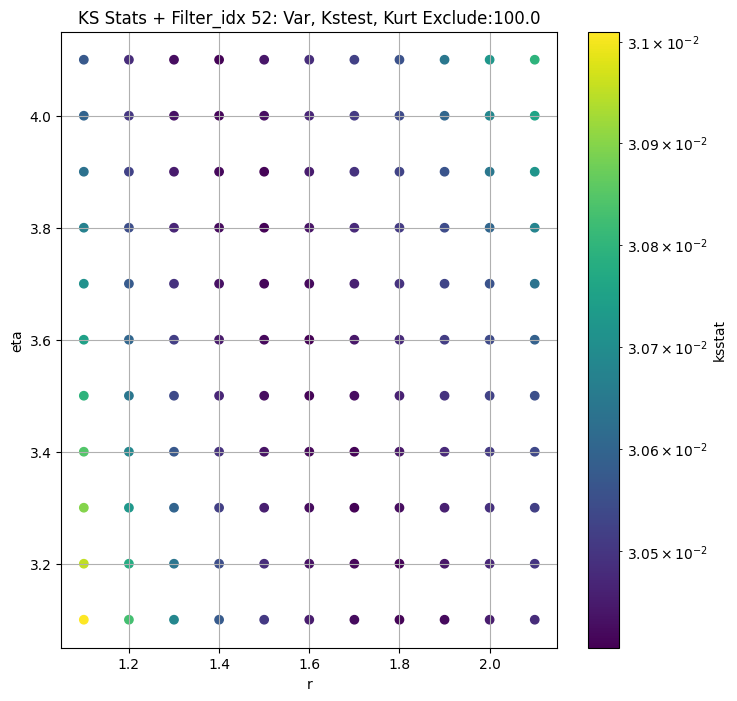

####
Filter_idx  53


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
53 0 0.020680026429025666 1.5622172467296105


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
53 50 0.022156837916825295 1.5078455251858935


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
53 100 0.022776978937502995 1.4838520112478044


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
53 200 0.023146766934563967 1.4461214048512885
Number of samples: 100000, Without approximation : 196608000.0


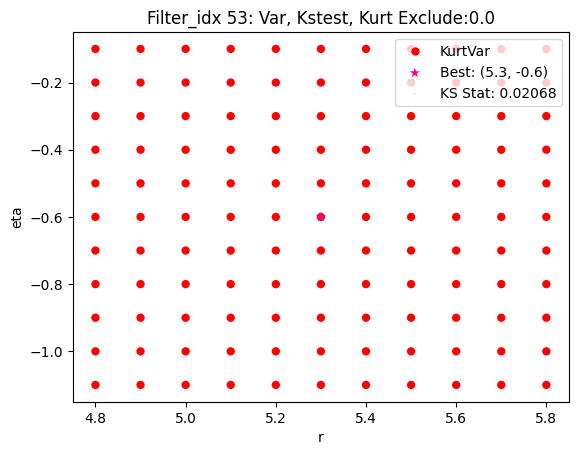

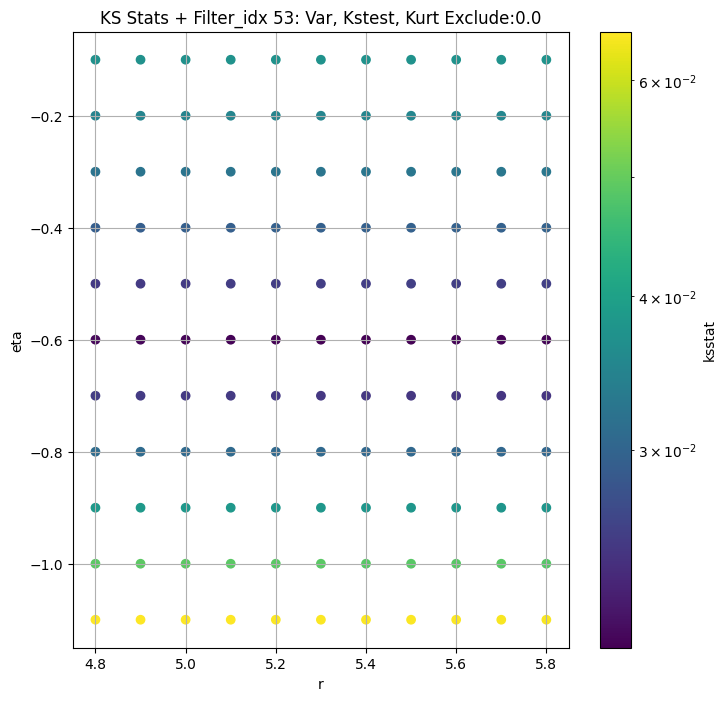

####
Filter_idx  54


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 0 0.012609207511781295 4.515233129819939


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 50 0.01545794074236656 3.9512831977269762


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 100 0.012902760629201482 3.7163356135703247


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 200 0.010471551680152846 3.3940421066944073
Number of samples: 100000, Without approximation : 196608000.0


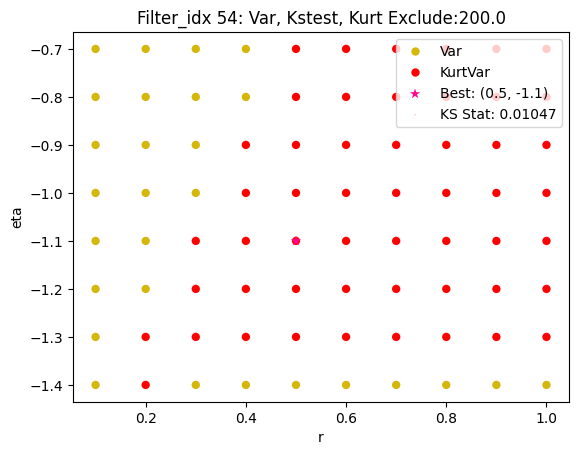

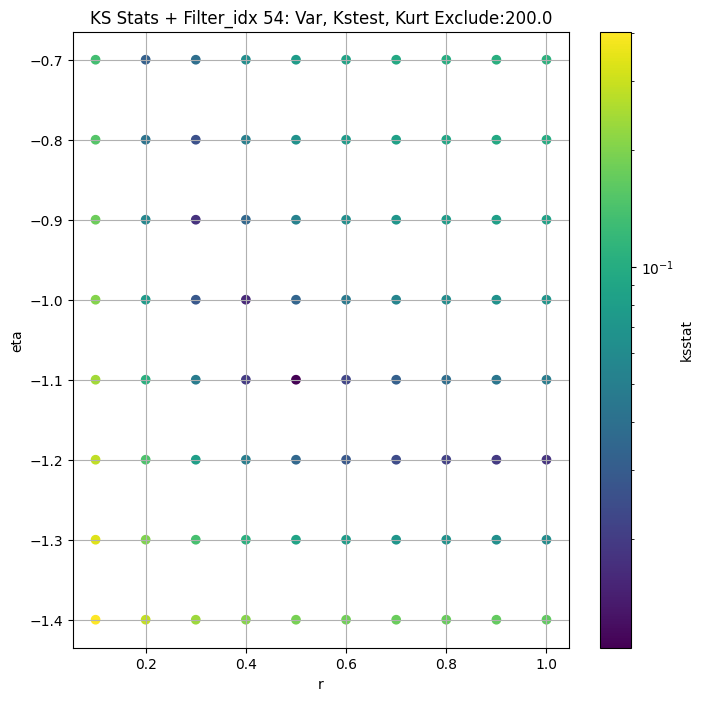

####
Filter_idx  55


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 0 0.008833585405076283 2.991251654518789


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 50 0.010010190528738527 2.5302323818170875


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 100 0.0089120607498131 2.390229410488475


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 200 0.009670392123375171 2.1976439787564437
Number of samples: 100000, Without approximation : 196608000.0


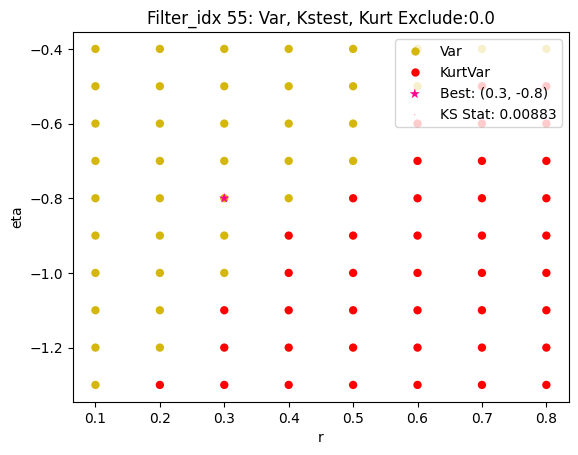

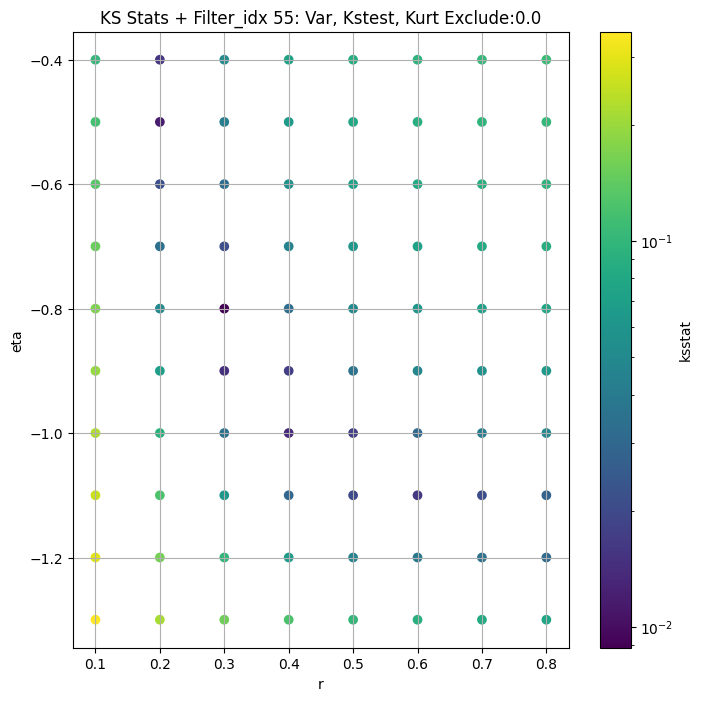

####
Filter_idx  56


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 0 0.014141151421445675 6.187806388625462


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 50 0.01355685208943791 5.593582952502383


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 100 0.011162440796885331 5.3181644606882195


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 200 0.013877481260284097 4.905418029373902
Number of samples: 100000, Without approximation : 196608000.0


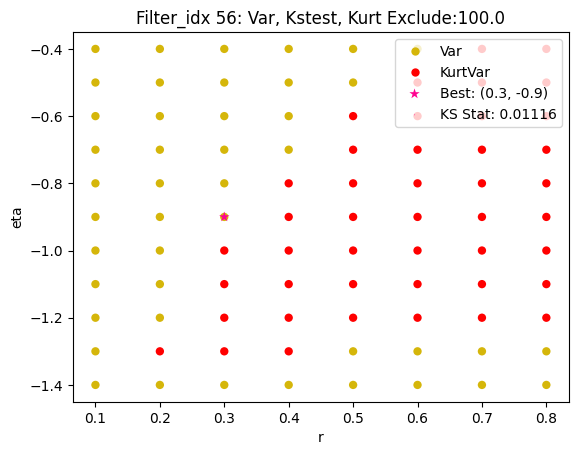

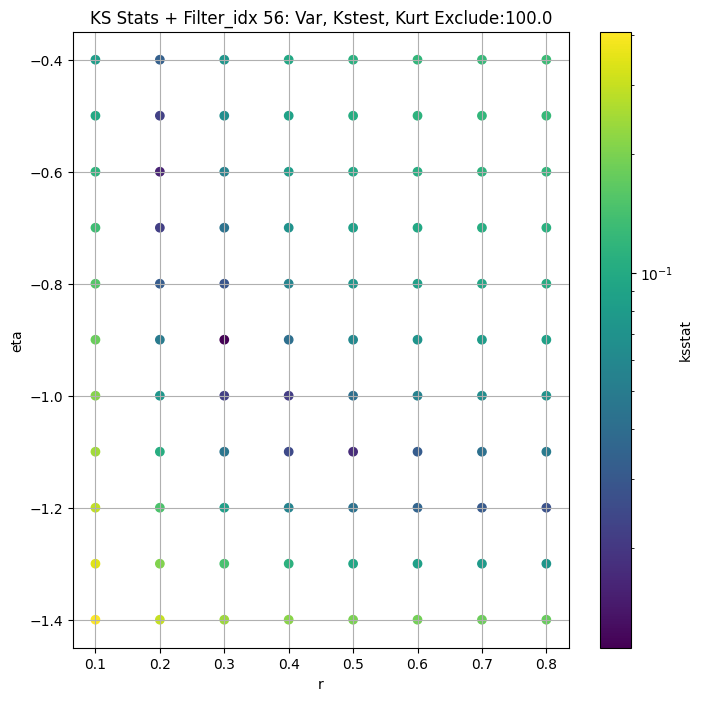

####
Filter_idx  57


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 0 0.006669033258864754 3.1663944371820065


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 50 0.006855848037819412 2.8033482085927357


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 100 0.0064176515410336865 2.6591514798304288


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 200 0.008224909577847689 2.457075121129111
Number of samples: 100000, Without approximation : 196608000.0


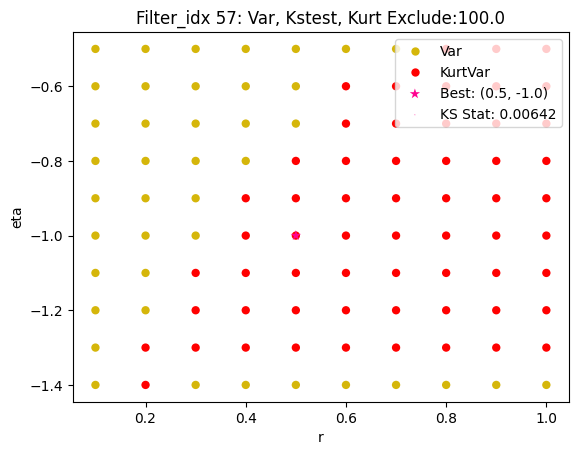

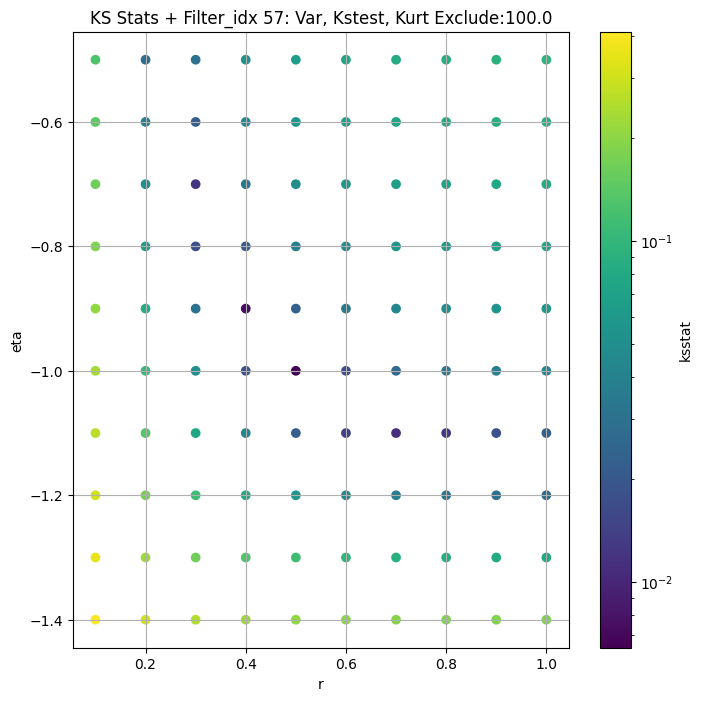

####
Filter_idx  58


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 0 0.018604252592723136 2.952385493545897


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 50 0.0175135570293799 2.8466233105345027


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 100 0.017007092452823933 2.8002074666918215


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 200 0.016298297003757845 2.7281259511644875
Number of samples: 100000, Without approximation : 196608000.0


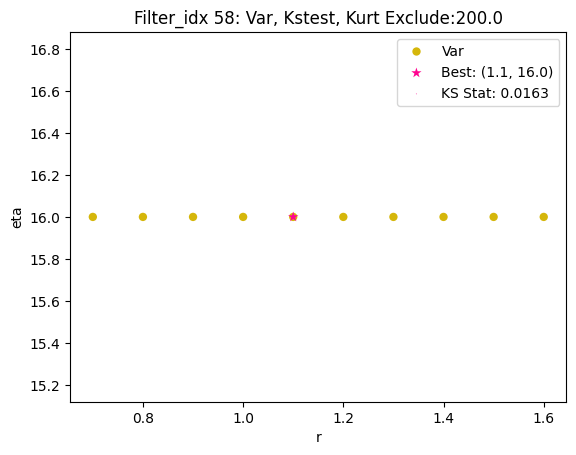

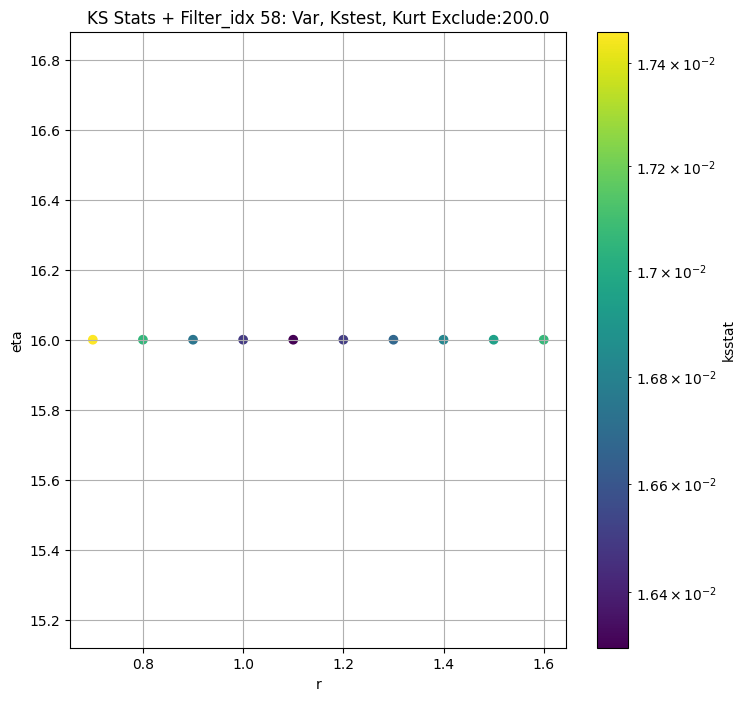

####
Filter_idx  59


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 0 0.007151464387810447 7.331521449818652


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 50 0.0056480097285973585 6.831544240547153


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 100 0.005117761789944469 6.58503789576765


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 200 0.007591300706794923 6.205107798729714
Number of samples: 100000, Without approximation : 196608000.0


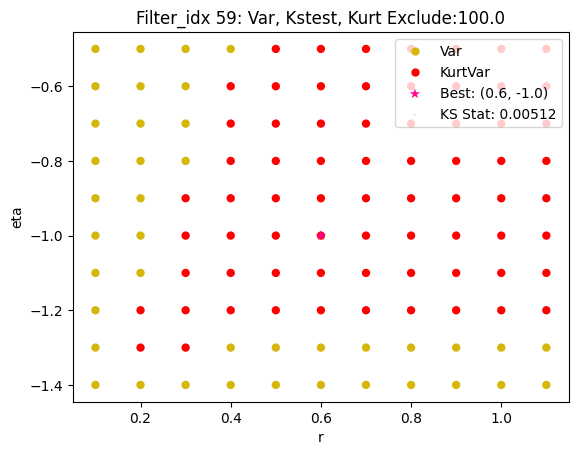

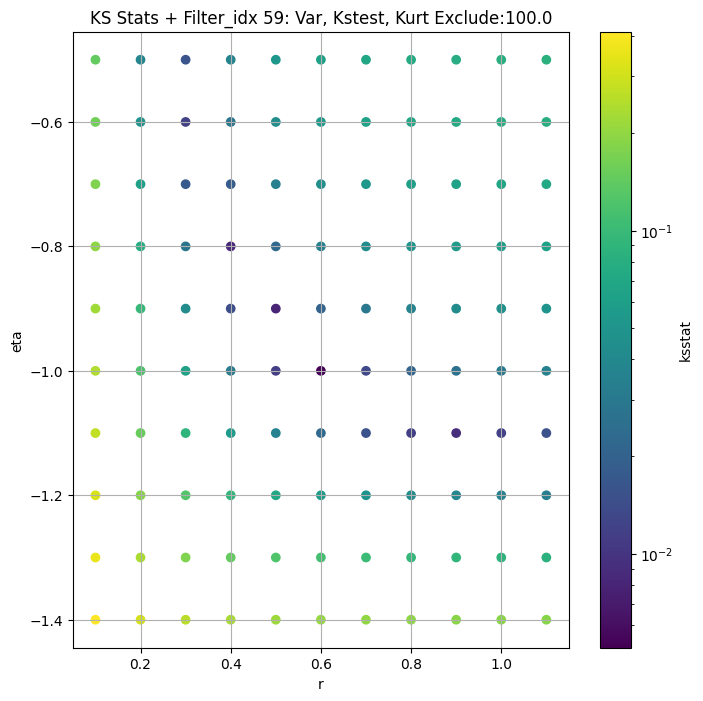

####
Filter_idx  60


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 0 0.007884870083906759 0.9083998213826714


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 50 0.0067315338368033745 0.8015402114318937


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 100 0.007792227049030653 0.764460871218104


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 200 0.008564962266098472 0.7114294669527323
Number of samples: 100000, Without approximation : 196608000.0


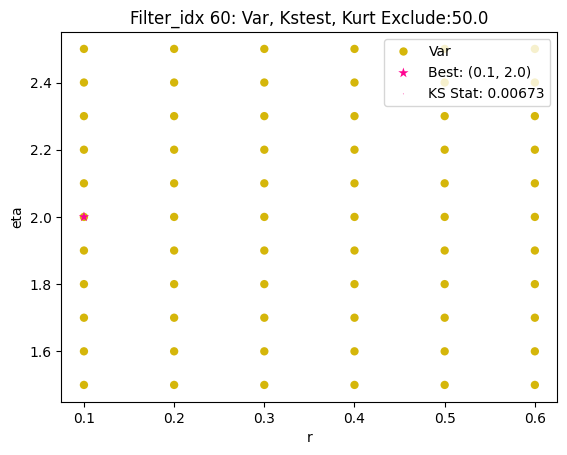

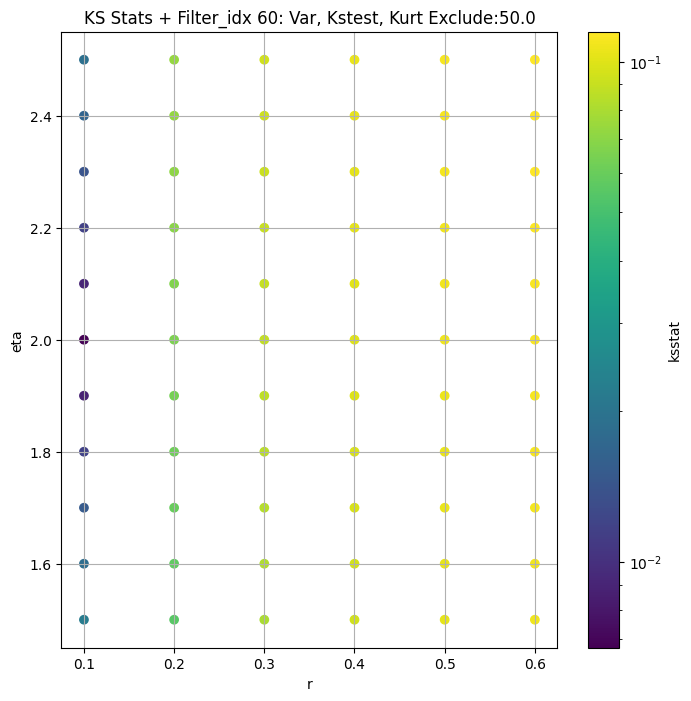

####
Filter_idx  61


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 0 0.011178623441964963 2.831790664803961


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 50 0.012011172120669156 2.540592122936473


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 100 0.012066872899149095 2.4028619730783647


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 200 0.01264012559036326 2.203160601236682
Number of samples: 100000, Without approximation : 196608000.0


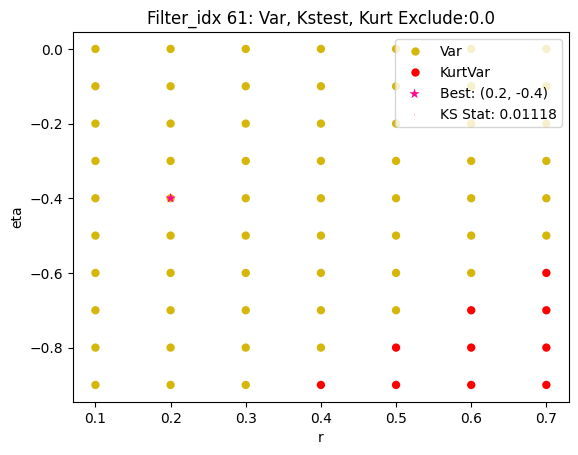

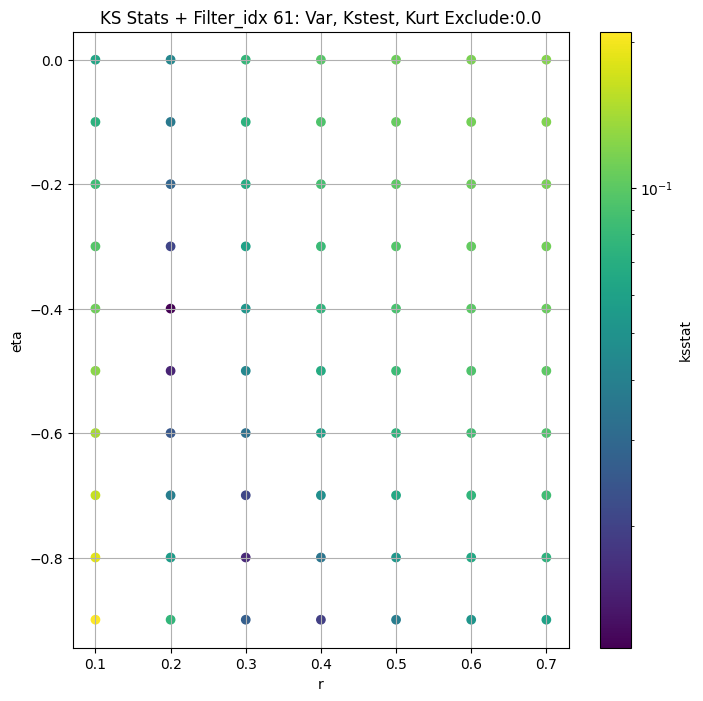

####
Filter_idx  62


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 0 0.02023733931170879 5.812720664852087


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 50 0.02098363677552395 5.419244646629248


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 100 0.020003995252517837 5.20559514123655


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 200 0.019099110787103357 4.8735121285742435
Number of samples: 100000, Without approximation : 196608000.0


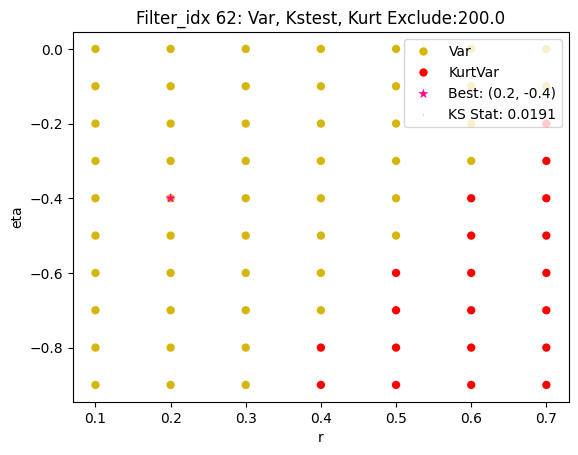

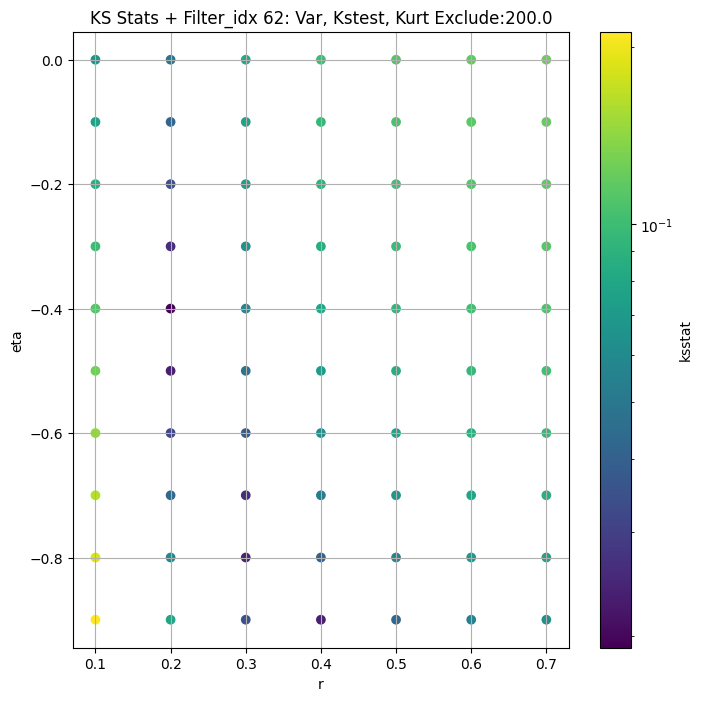

####
Filter_idx  63


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 0 0.00973528193938844 2.6454210809616843


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 50 0.010082323582605135 2.2982685765544058


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 100 0.0092118067034207 2.1740105872453954


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 200 0.011387603709036132 2.00151539329958
Number of samples: 100000, Without approximation : 196608000.0


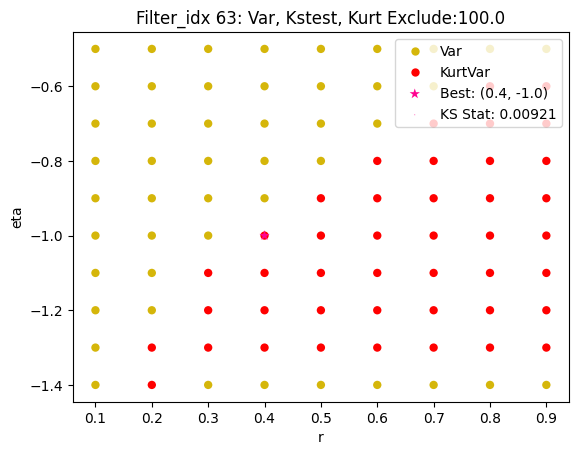

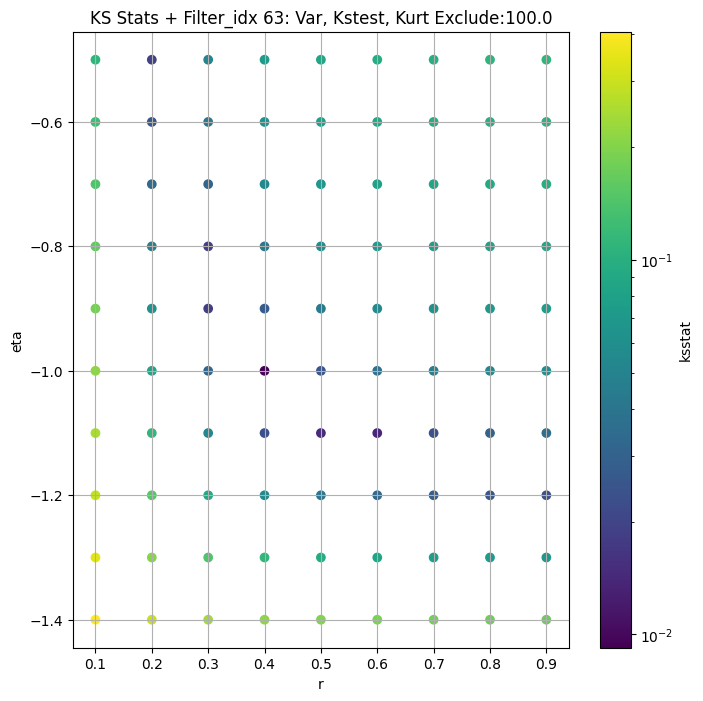

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,
0,5.722945,3.941295,15.222635,59.391348,5.931396,391.685447,196608000.0,dual_color,0.007873,0.2,-0.3,1.892508e-04,0.0,5.722945,0.000097
1,6.533414,5.498173,8.526413,3.136300,0.137287,80.026759,196608000.0,misc,0.027652,0.3,9.0,3.905950e-05,200.0,6.104103,0.000097
2,7.159568,4.921619,20.682040,85.591074,7.076928,476.156391,196608000.0,dual_color,0.006579,0.3,-0.9,1.784140e-01,0.0,7.159568,0.000097
3,4.838522,3.290435,11.411586,48.853143,6.976516,333.181233,196608000.0,single_edge,0.005482,0.3,-0.9,1.205743e-01,0.0,4.838522,0.000097
4,8.759626,6.083474,18.486370,34.242134,7.774326,295.723662,196608000.0,dual_color,0.010011,0.3,-0.9,1.919591e-01,100.0,7.703118,0.000097
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59,7.331521,5.420855,13.697990,22.008065,4.583866,237.169119,196608000.0,dual_color,0.005118,0.6,-1.0,5.591574e+00,100.0,6.585038,0.000097
60,0.908400,0.631226,2.939074,103.870175,5.770326,500.142442,196608000.0,misc,0.006732,0.1,2.0,8.902061e-17,50.0,0.801540,0.000097
61,2.831791,1.875037,6.085772,40.461455,7.221174,309.068150,196608000.0,misc,0.011179,0.2,-0.4,1.307920e-04,0.0,2.831791,0.000097


In [12]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()} ", group)
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

## Optimization

In [13]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 0, 0.0 + 100 = 100, ksstat: 0.008901110988857985, var: 4.937812881908325


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 0, 0.0 + 75 = 75, ksstat: 0.008304510369503415, var: 5.046823557066536


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 0, 0.0 + 50 = 50, ksstat: 0.007642909715015189, var: 5.171239635391533


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 0, 0.0 + 25 = 25, ksstat: 0.00775037585871019, var: 5.321335741044003


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 0, 0.0 + 0 = 0, ksstat: 0.007339905886508735, var: 5.722945063258994
Number of samples: 100000, Without approximation : 196608000.0


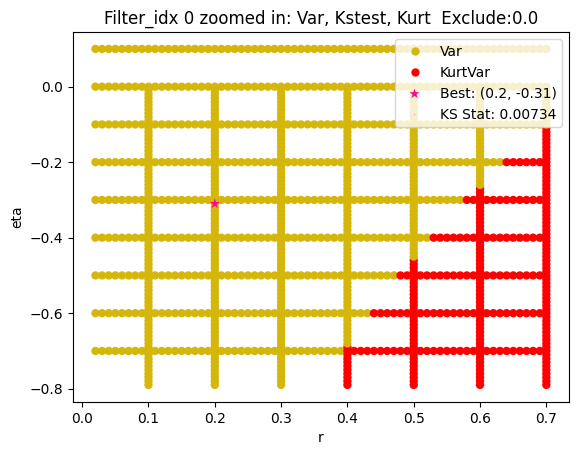

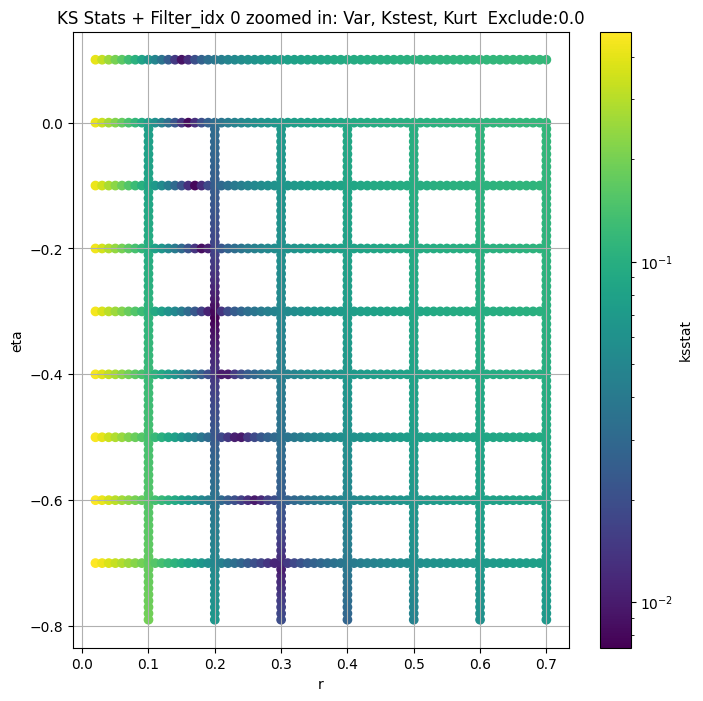

Filter_idx 1


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 1, 200.0 + 100 = 300, ksstat: 0.0276402183250804, var: 5.980893648927049


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 1, 200.0 + 75 = 275, ksstat: 0.027645847678618662, var: 6.010083425164465


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 1, 200.0 + 50 = 250, ksstat: 0.027654952989053627, var: 6.040276443156822


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 1, 200.0 + 25 = 225, ksstat: 0.027652147727025733, var: 6.071567671722729


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 1, 200.0 + 0 = 200, ksstat: 0.02765207437532924, var: 6.1041026192380015


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 1, 200.0 + -25 = 175, ksstat: 0.027654775615420957, var: 6.138111736689712


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 1, 200.0 + -50 = 150, ksstat: 0.02766028626694117, var: 6.173868773667864


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 1, 200.0 + -75 = 125, ksstat: 0.027668515427387352, var: 6.211752935178006


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 1, 200.0 + -100 = 100, ksstat: 0.02767903649503034, var: 6.252357616831734
Number of samples: 100000, Without approximation : 196608000.0


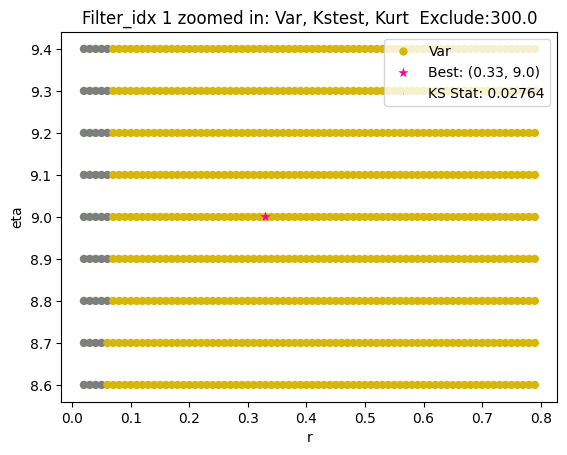

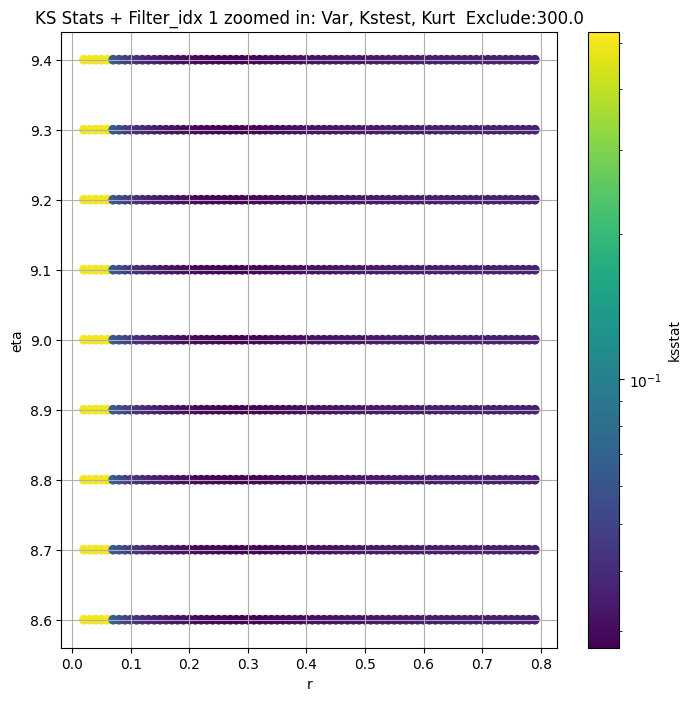

Filter_idx 2


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 2, 0.0 + 100 = 100, ksstat: 0.007445488624093444, var: 6.021584361857979


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 2, 0.0 + 75 = 75, ksstat: 0.007413622028399125, var: 6.174457302086821


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 2, 0.0 + 50 = 50, ksstat: 0.0069399456204943255, var: 6.3503583542742374


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 2, 0.0 + 25 = 25, ksstat: 0.005977469752640685, var: 6.565236872560209


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 2, 0.0 + 0 = 0, ksstat: 0.006166670463927215, var: 7.1595676114240385
Number of samples: 100000, Without approximation : 196608000.0


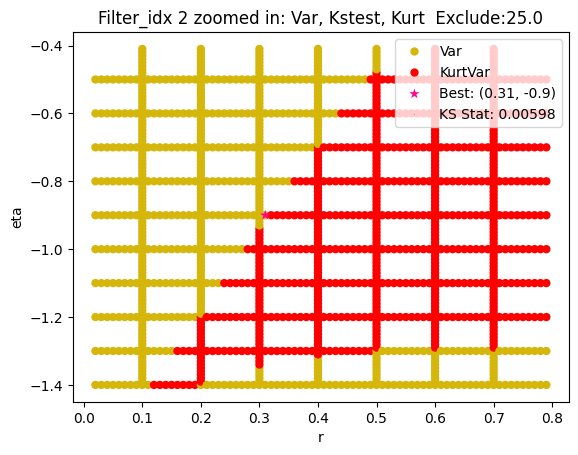

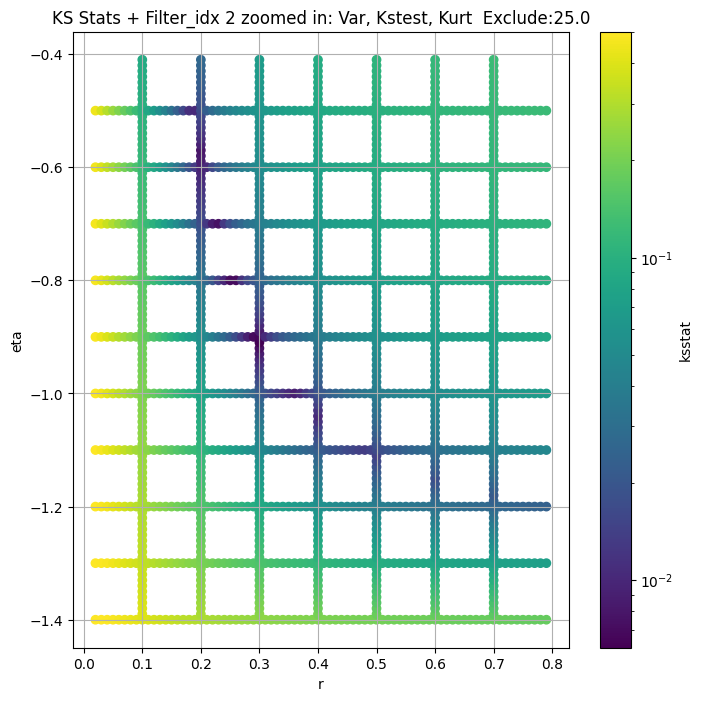

Filter_idx 3


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 3, 0.0 + 100 = 100, ksstat: 0.006520182875889777, var: 4.090690627663553


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 3, 0.0 + 75 = 75, ksstat: 0.005875173730493455, var: 4.196549173616109


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 3, 0.0 + 50 = 50, ksstat: 0.0049183727880980355, var: 4.3200768860396614


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 3, 0.0 + 25 = 25, ksstat: 0.004377010494341249, var: 4.474196197381665


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 3, 0.0 + 0 = 0, ksstat: 0.004860023949291525, var: 4.838522315826807
Number of samples: 100000, Without approximation : 196608000.0


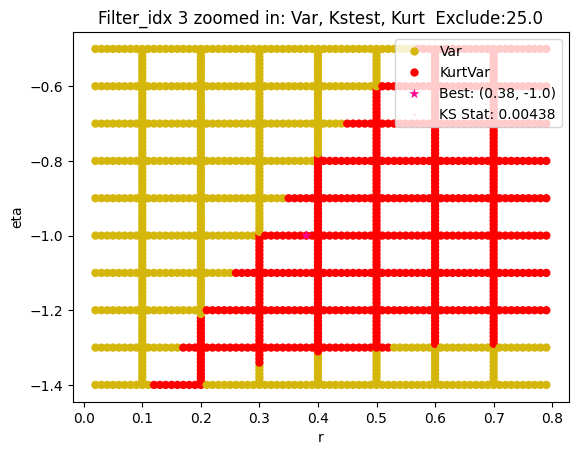

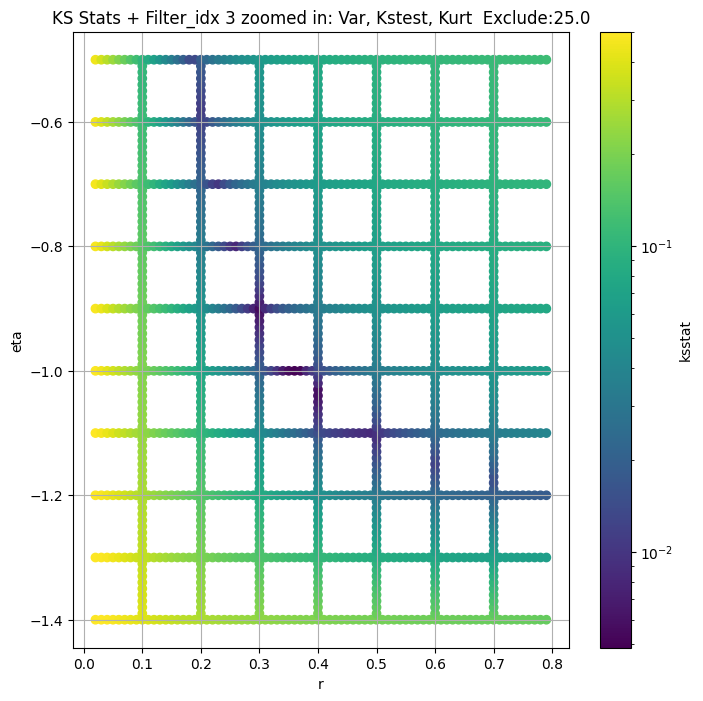

Filter_idx 4


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + 100 = 200, ksstat: 0.009100313516964054, var: 7.147288232864539


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + 75 = 175, ksstat: 0.009042919931604554, var: 7.273494906745728


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + 50 = 150, ksstat: 0.008980966159400472, var: 7.407244063377581


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + 25 = 125, ksstat: 0.008371872187881269, var: 7.549831443176587


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + 0 = 100, ksstat: 0.008932920727238114, var: 7.703117686415404


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + -25 = 75, ksstat: 0.008512479741585421, var: 7.8701359254782135


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + -50 = 50, ksstat: 0.008369523996045403, var: 8.055954842394957


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + -75 = 25, ksstat: 0.007749057282212313, var: 8.27261540096063


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + -100 = 0, ksstat: 0.007590112697752671, var: 8.75962554271881
Number of samples: 100000, Without approximation : 196608000.0


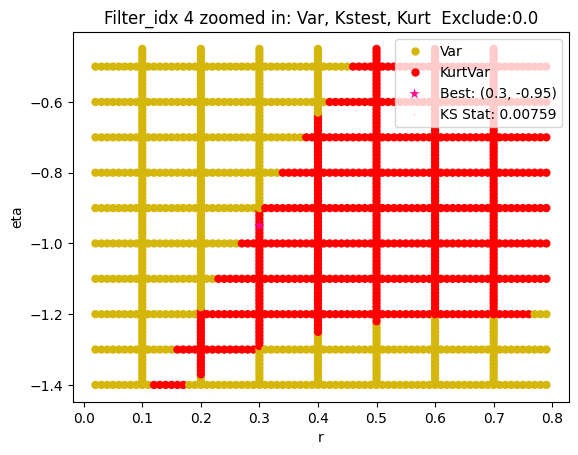

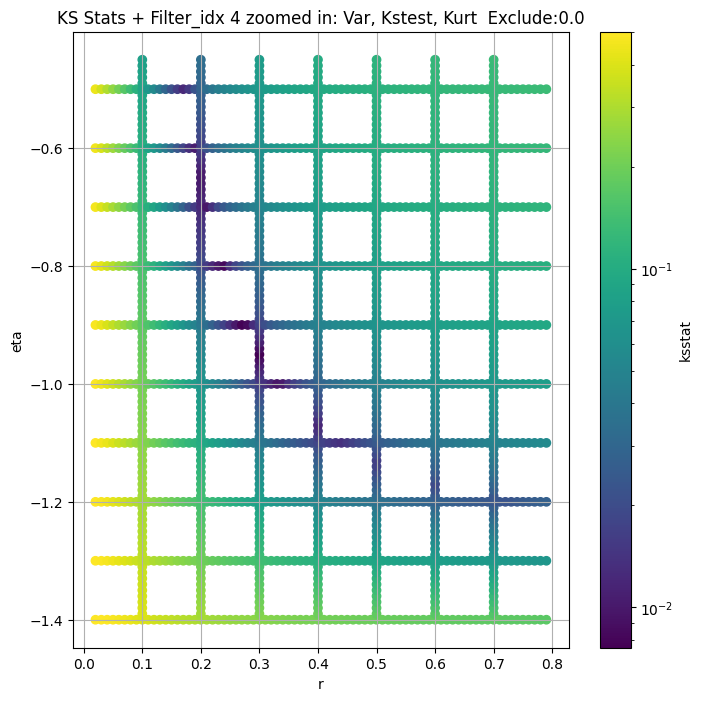

Filter_idx 5


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 5, 50.0 + 100 = 150, ksstat: 0.012452931096701758, var: 4.8138884333999545


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 5, 50.0 + 75 = 125, ksstat: 0.012804517764042067, var: 4.893292774852825


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 5, 50.0 + 50 = 100, ksstat: 0.012243802286823535, var: 4.978757527734711


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 5, 50.0 + 25 = 75, ksstat: 0.011778331544289089, var: 5.072029924267398


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 5, 50.0 + 0 = 50, ksstat: 0.011706041196174133, var: 5.176218043596685


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 5, 50.0 + -25 = 25, ksstat: 0.011810853321608084, var: 5.2987576774921274


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 5, 50.0 + -50 = 0, ksstat: 0.011784866105639447, var: 5.603066738768062
Number of samples: 100000, Without approximation : 196608000.0


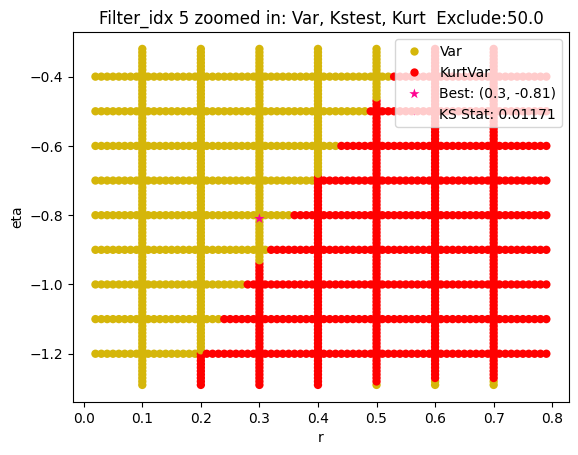

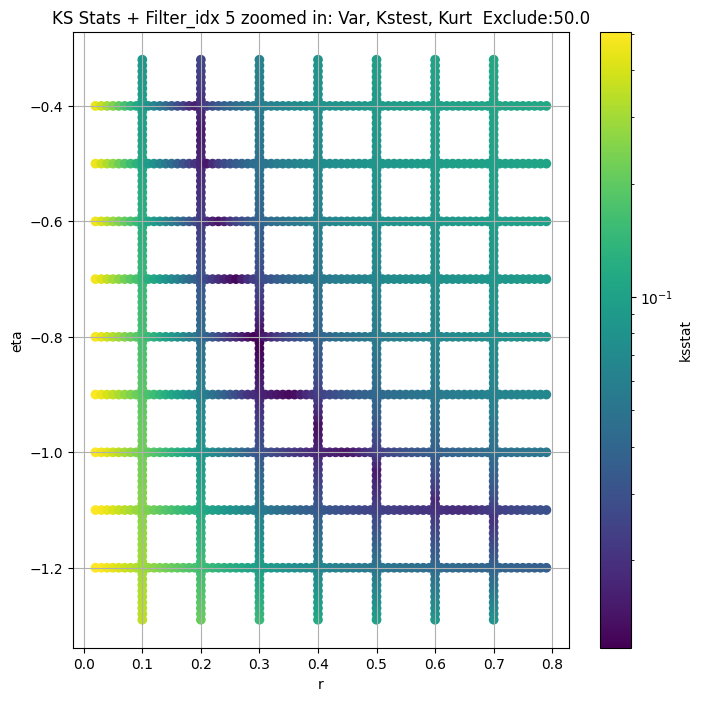

Filter_idx 6


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 6, 0.0 + 100 = 100, ksstat: 0.00577742070564935, var: 2.418004791698781


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 6, 0.0 + 75 = 75, ksstat: 0.005597376037111634, var: 2.473733985204394


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 6, 0.0 + 50 = 50, ksstat: 0.005698774775207915, var: 2.538975162998015


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 6, 0.0 + 25 = 25, ksstat: 0.0054445441989715015, var: 2.621154250311483


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 6, 0.0 + 0 = 0, ksstat: 0.005703851126021675, var: 2.846655635276621
Number of samples: 100000, Without approximation : 196608000.0


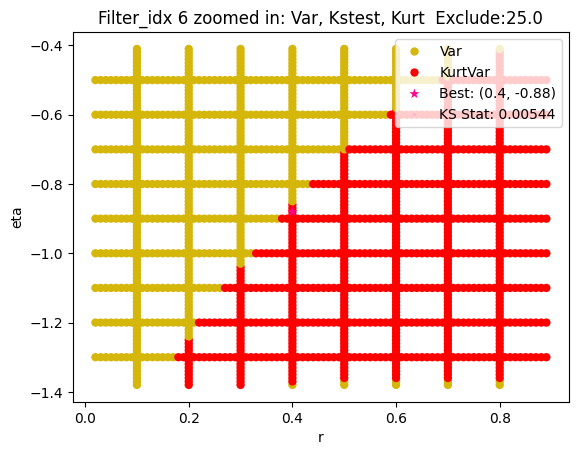

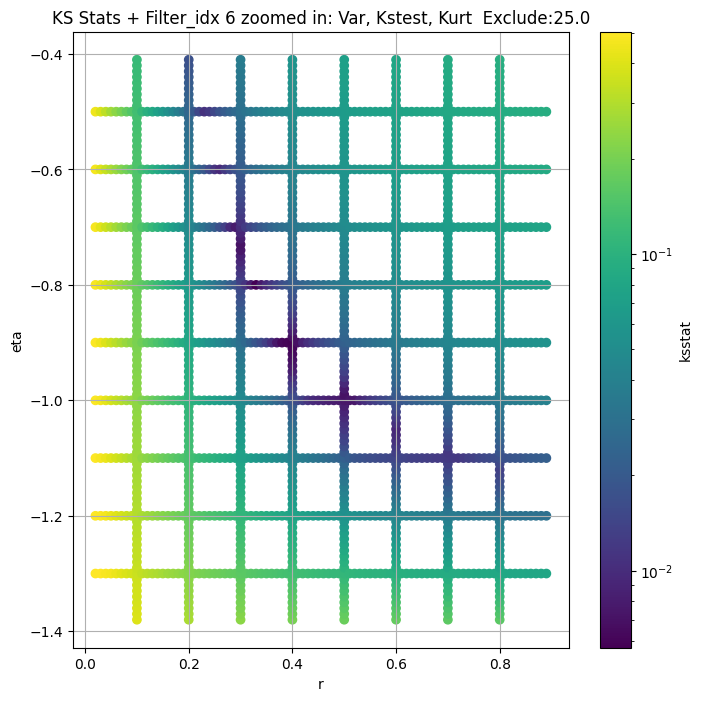

Filter_idx 7


  0%|          | 0/486 [00:00<?, ?it/s]

Finding Minimum after computing 486 CDFs
filter_idx 7, 200.0 + 100 = 300, ksstat: 0.007136308209625519, var: 3.143430958796775


  0%|          | 0/486 [00:00<?, ?it/s]

Finding Minimum after computing 486 CDFs
filter_idx 7, 200.0 + 75 = 275, ksstat: 0.006831898040494333, var: 3.1631609669476317


  0%|          | 0/486 [00:00<?, ?it/s]

Finding Minimum after computing 486 CDFs
filter_idx 7, 200.0 + 50 = 250, ksstat: 0.006821861592117673, var: 3.1836611897483014


  0%|          | 0/486 [00:00<?, ?it/s]

Finding Minimum after computing 486 CDFs
filter_idx 7, 200.0 + 25 = 225, ksstat: 0.006697695869913589, var: 3.205021124331712


  0%|          | 0/486 [00:00<?, ?it/s]

Finding Minimum after computing 486 CDFs
filter_idx 7, 200.0 + 0 = 200, ksstat: 0.006703515843518804, var: 3.227344217082155


  0%|          | 0/486 [00:00<?, ?it/s]

Finding Minimum after computing 486 CDFs
filter_idx 7, 200.0 + -25 = 175, ksstat: 0.006736050642633218, var: 3.250787516397213


  0%|          | 0/486 [00:00<?, ?it/s]

Finding Minimum after computing 486 CDFs
filter_idx 7, 200.0 + -50 = 150, ksstat: 0.00666336517175653, var: 3.2755562924126926


  0%|          | 0/486 [00:00<?, ?it/s]

Finding Minimum after computing 486 CDFs
filter_idx 7, 200.0 + -75 = 125, ksstat: 0.006677520186434693, var: 3.3019270134204133


  0%|          | 0/486 [00:00<?, ?it/s]

Finding Minimum after computing 486 CDFs
filter_idx 7, 200.0 + -100 = 100, ksstat: 0.006708785307162235, var: 3.330288584593084
Number of samples: 100000, Without approximation : 196608000.0


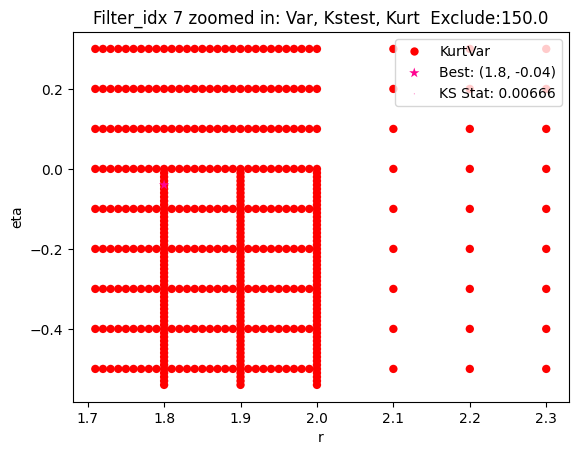

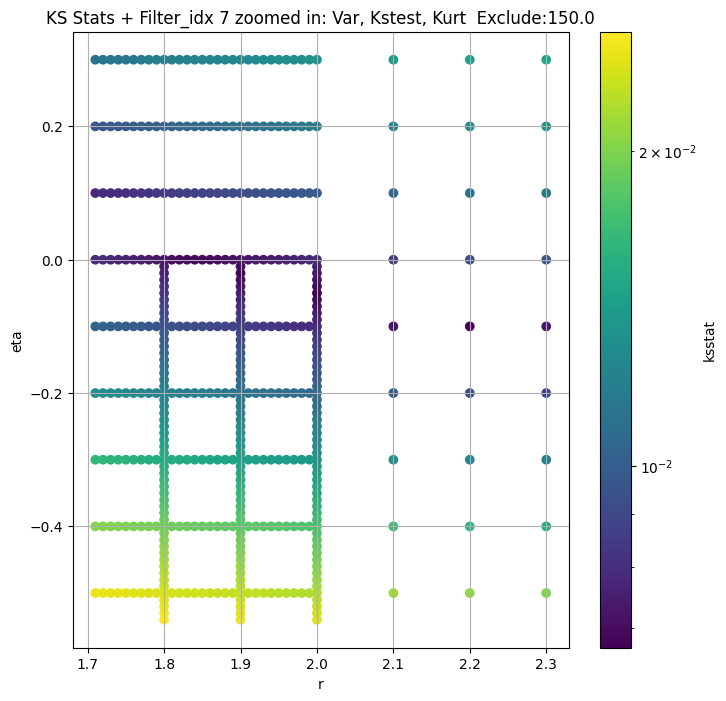

Filter_idx 8


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 100.0 + 100 = 200, ksstat: 0.009478714867163007, var: 0.329854001881963


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 100.0 + 75 = 175, ksstat: 0.009044840838563606, var: 0.3350047906502489


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 100.0 + 50 = 150, ksstat: 0.008662890433615567, var: 0.340550026234864


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 100.0 + 25 = 125, ksstat: 0.009142702349035747, var: 0.3465815551081547


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 100.0 + 0 = 100, ksstat: 0.008603328470062954, var: 0.3532353606239595


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 100.0 + -25 = 75, ksstat: 0.00883975144294702, var: 0.3607306766030687


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 100.0 + -50 = 50, ksstat: 0.009038889775142223, var: 0.36946718763674274


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 100.0 + -75 = 25, ksstat: 0.008675781526023663, var: 0.38040588334273917


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 100.0 + -100 = 0, ksstat: 0.010131371390220578, var: 0.4226354638231319
Number of samples: 100000, Without approximation : 196608000.0


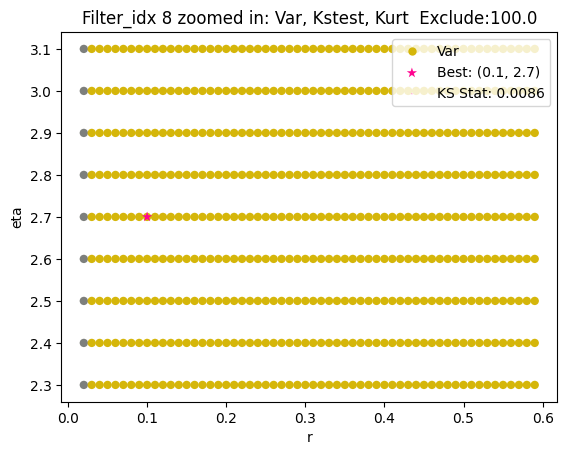

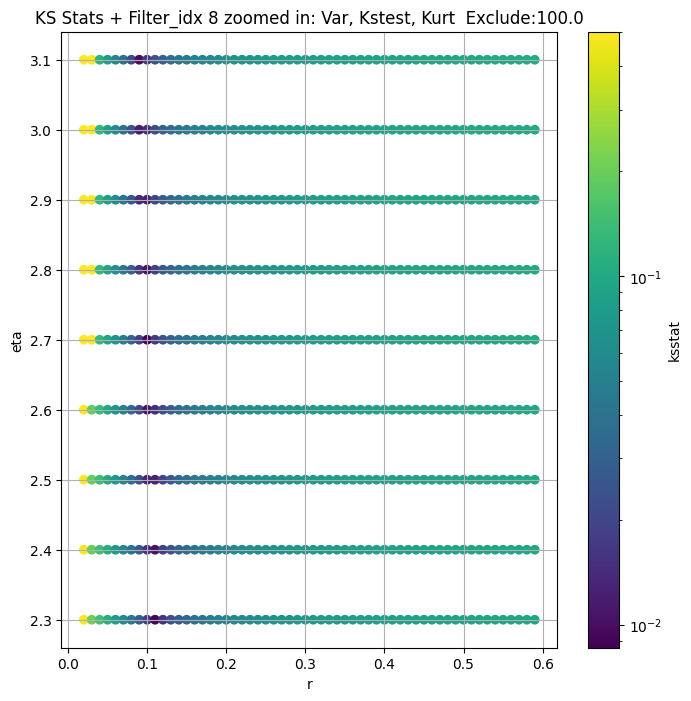

Filter_idx 9


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 9, 50.0 + 100 = 150, ksstat: 0.011266584738528151, var: 2.2689979244472385


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 9, 50.0 + 75 = 125, ksstat: 0.010934698578544455, var: 2.325800312200799


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 9, 50.0 + 50 = 100, ksstat: 0.011415765081022378, var: 2.3896170908544745


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 9, 50.0 + 25 = 75, ksstat: 0.011853655096715765, var: 2.463157852364811


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 9, 50.0 + 0 = 50, ksstat: 0.011592177085068434, var: 2.5513608714714016


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 9, 50.0 + -25 = 25, ksstat: 0.011767448491622146, var: 2.6661811682022396


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 9, 50.0 + -50 = 0, ksstat: 0.009903013347202116, var: 3.000422791004444
Number of samples: 100000, Without approximation : 196608000.0


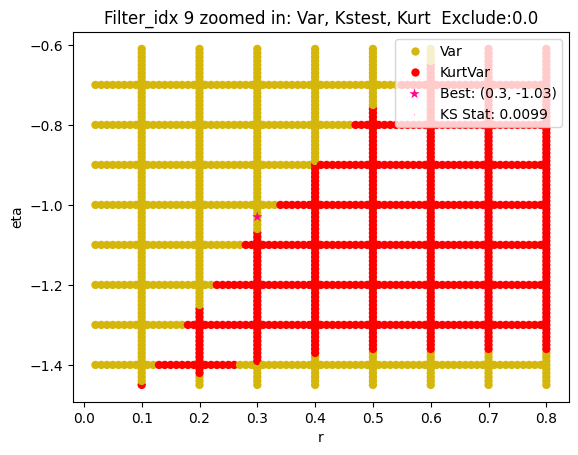

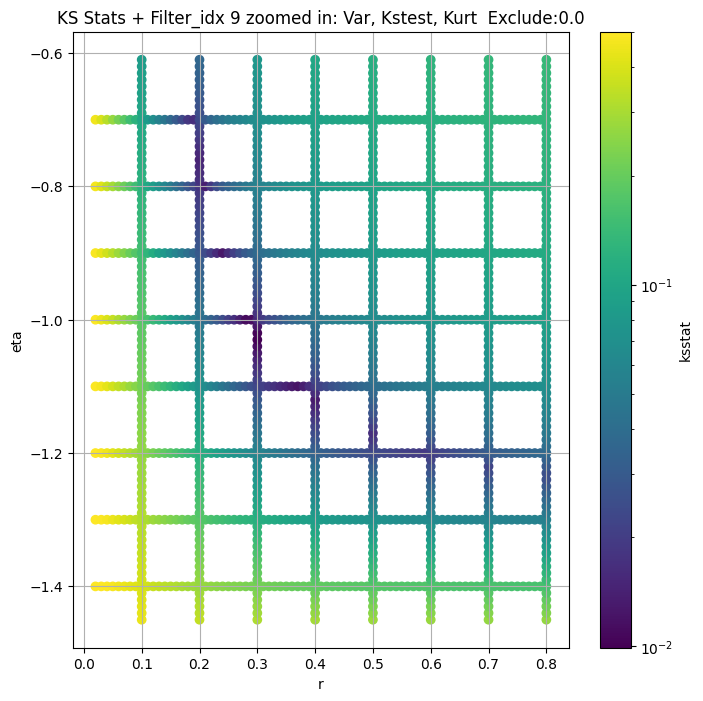

Filter_idx 10


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 10, 100.0 + 100 = 200, ksstat: 0.006036429181434988, var: 2.82468457757201


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 10, 100.0 + 75 = 175, ksstat: 0.005849128067778583, var: 2.8704321325327804


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 10, 100.0 + 50 = 150, ksstat: 0.005622039081358554, var: 2.9195086647177777


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 10, 100.0 + 25 = 125, ksstat: 0.005537038705232644, var: 2.9726882795342653


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 10, 100.0 + 0 = 100, ksstat: 0.005414607082477929, var: 3.0310660669547396


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 10, 100.0 + -25 = 75, ksstat: 0.0052655731549345886, var: 3.0963511809394846


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 10, 100.0 + -50 = 50, ksstat: 0.0046059959856998844, var: 3.171727962320305


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 10, 100.0 + -75 = 25, ksstat: 0.004849895788227587, var: 3.2645931770857044


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 10, 100.0 + -100 = 0, ksstat: 0.0041852308726121334, var: 3.485964679620385
Number of samples: 100000, Without approximation : 196608000.0


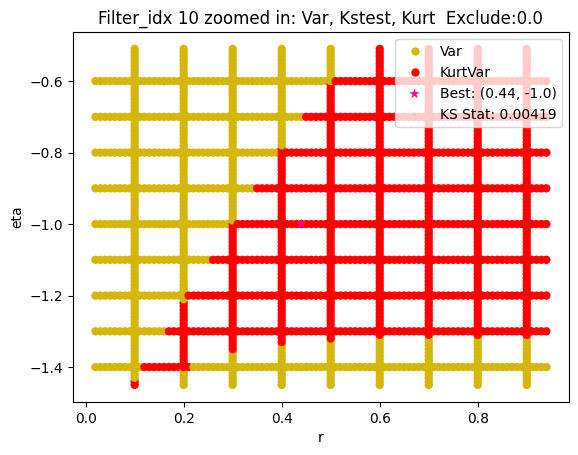

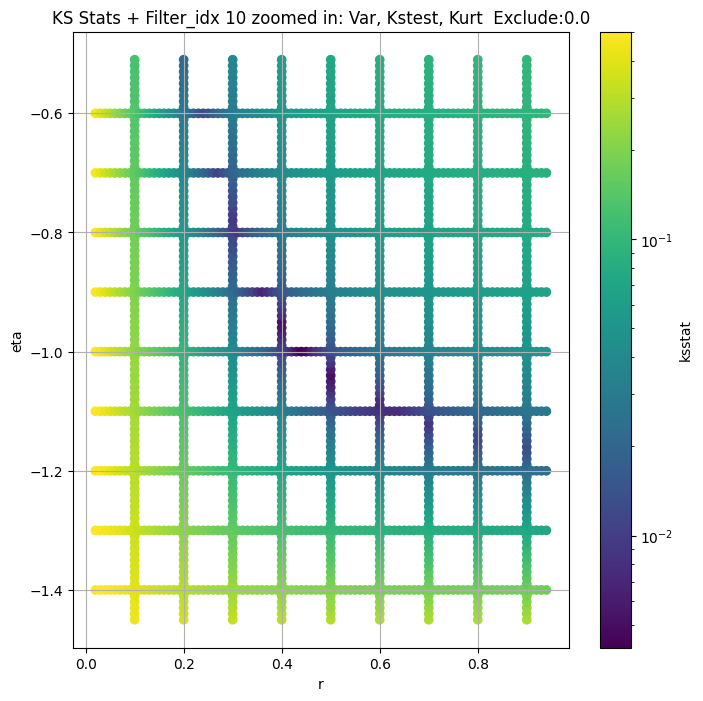

Filter_idx 11


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 11, 0.0 + 100 = 100, ksstat: 0.011372752046272194, var: 2.135216667391795


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 11, 0.0 + 75 = 75, ksstat: 0.011331268038333286, var: 2.193722517029618


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 11, 0.0 + 50 = 50, ksstat: 0.011342569717958884, var: 2.2626877322768695


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 11, 0.0 + 25 = 25, ksstat: 0.011288659690131875, var: 2.350347130490987


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 11, 0.0 + 0 = 0, ksstat: 0.01168883119016595, var: 2.6060207746886097
Number of samples: 100000, Without approximation : 196608000.0


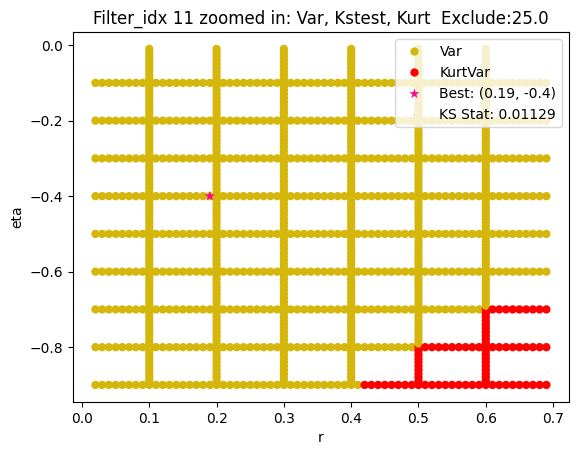

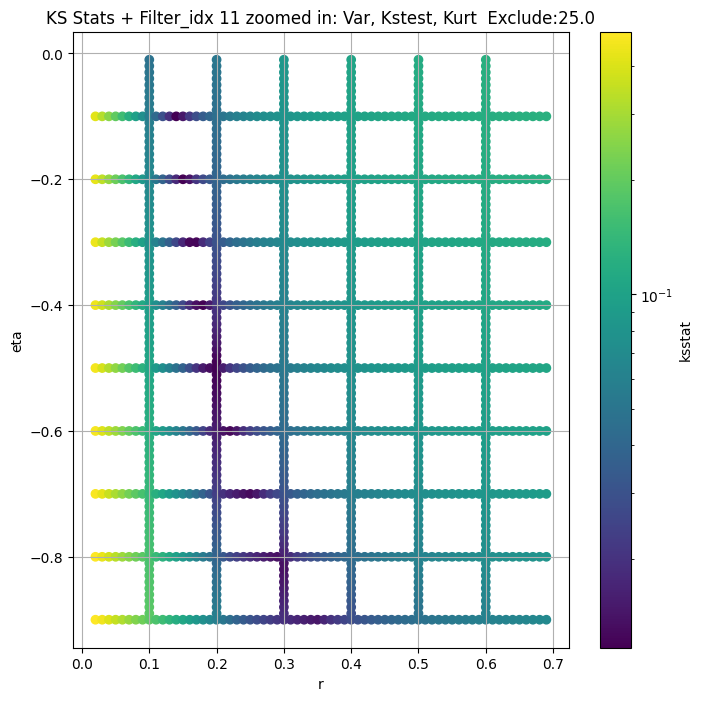

Filter_idx 12


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 12, 100.0 + 100 = 200, ksstat: 0.010550387900316593, var: 2.014348192495963


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 12, 100.0 + 75 = 175, ksstat: 0.009780696716638865, var: 2.0547247684171084


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 12, 100.0 + 50 = 150, ksstat: 0.009493120764936025, var: 2.098539369817335


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 12, 100.0 + 25 = 125, ksstat: 0.009683895967480538, var: 2.146625985331689


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 12, 100.0 + 0 = 100, ksstat: 0.009821299714624643, var: 2.2002059105272216


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 12, 100.0 + -25 = 75, ksstat: 0.009725816103934914, var: 2.261319364559273


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 12, 100.0 + -50 = 50, ksstat: 0.009480954837960354, var: 2.333798906619431


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 12, 100.0 + -75 = 25, ksstat: 0.00921009277419682, var: 2.42673556088601


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 12, 100.0 + -100 = 0, ksstat: 0.008947068634317601, var: 2.7016123979812185
Number of samples: 100000, Without approximation : 196608000.0


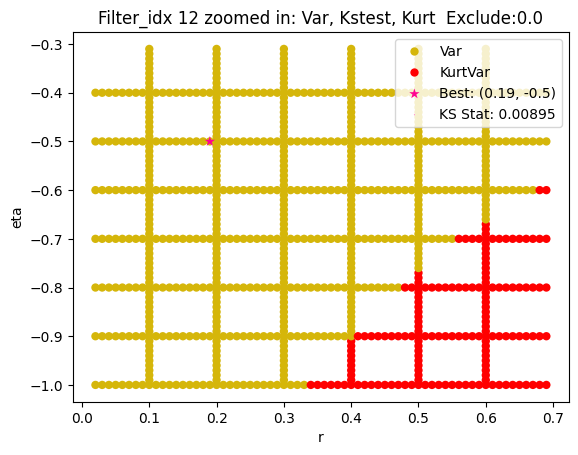

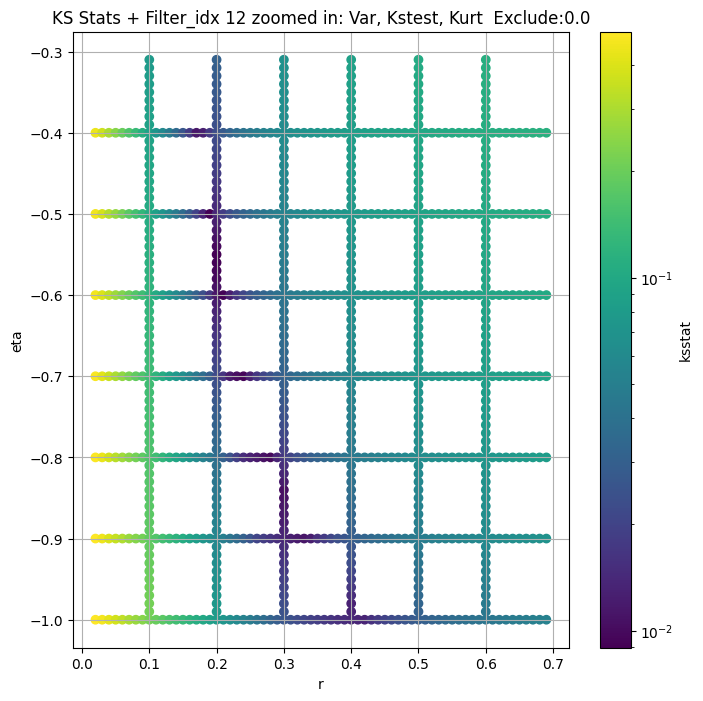

Filter_idx 13


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 13, 200.0 + 100 = 300, ksstat: 0.009422318759402692, var: 2.967968001565452


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 13, 200.0 + 75 = 275, ksstat: 0.009213966166009613, var: 3.0119017946129403


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 13, 200.0 + 50 = 250, ksstat: 0.009306758997488451, var: 3.058177001513249


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 13, 200.0 + 25 = 225, ksstat: 0.009384672413115414, var: 3.1071098868084426


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 13, 200.0 + 0 = 200, ksstat: 0.009517352197446816, var: 3.159104902565461


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 13, 200.0 + -25 = 175, ksstat: 0.00950288937276017, var: 3.2147033638178173


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 13, 200.0 + -50 = 150, ksstat: 0.008925517822097273, var: 3.27461207840954


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 13, 200.0 + -75 = 125, ksstat: 0.008425415811402548, var: 3.3398445454026096


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 13, 200.0 + -100 = 100, ksstat: 0.008625340883248539, var: 3.4118759814187682
Number of samples: 100000, Without approximation : 196608000.0


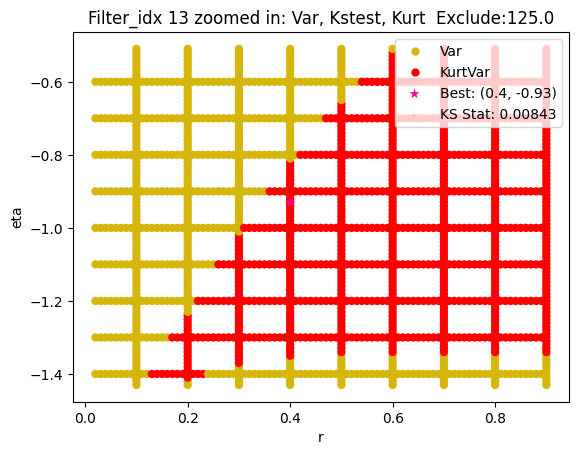

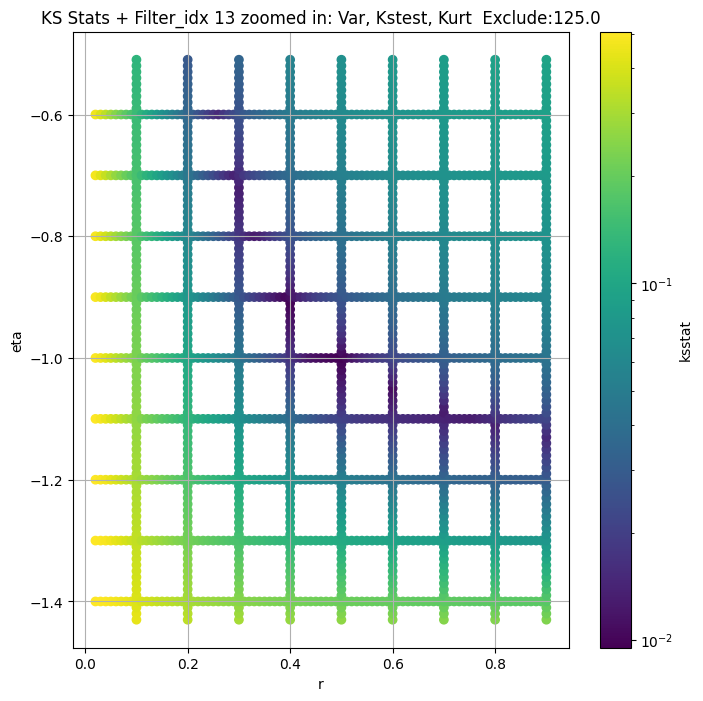

Filter_idx 14


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 14, 50.0 + 100 = 150, ksstat: 0.006838365482834063, var: 3.596551260693856


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 14, 50.0 + 75 = 125, ksstat: 0.006867537012014174, var: 3.6679096465805676


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 14, 50.0 + 50 = 100, ksstat: 0.006556137928266842, var: 3.746252001248223


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 14, 50.0 + 25 = 75, ksstat: 0.006223275267398749, var: 3.8339519789768977


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 14, 50.0 + 0 = 50, ksstat: 0.005985973123806443, var: 3.935302306287966


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 14, 50.0 + -25 = 25, ksstat: 0.005555234384410301, var: 4.0599529929207385


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 14, 50.0 + -50 = 0, ksstat: 0.00636553270746415, var: 4.35515929710186
Number of samples: 100000, Without approximation : 196608000.0


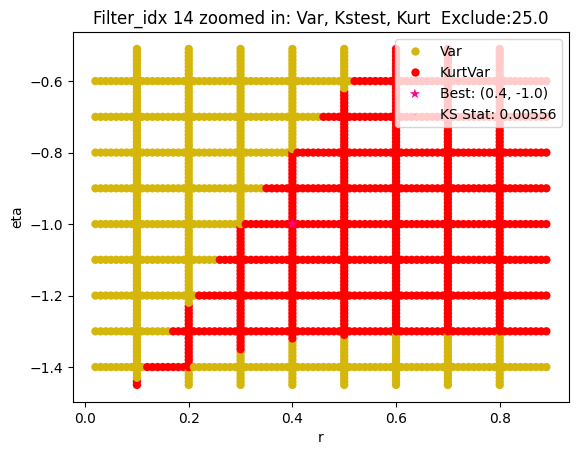

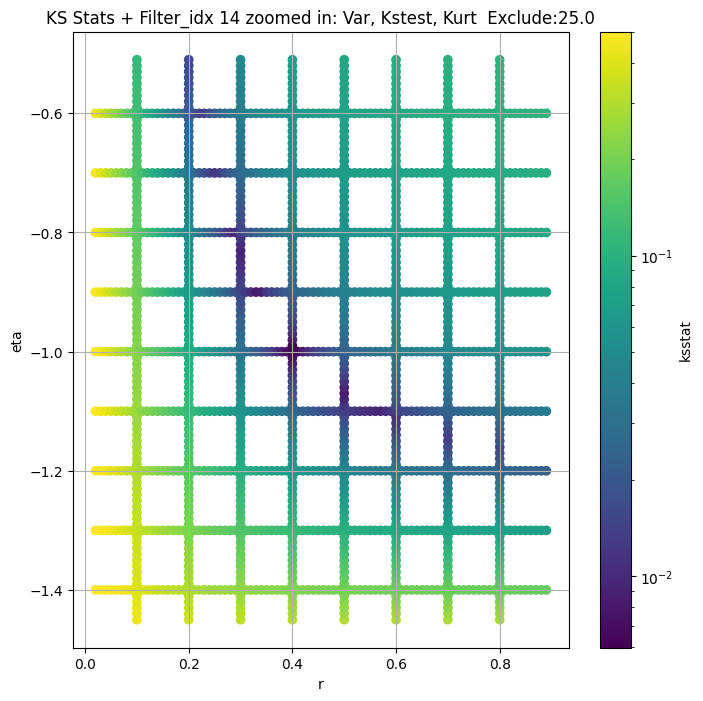

Filter_idx 15


  0%|          | 0/81 [00:00<?, ?it/s]

Finding Minimum after computing 81 CDFs
filter_idx 15, 50.0 + 100 = 150, ksstat: 0.01961226678196132, var: 5.21391515533129


  0%|          | 0/81 [00:00<?, ?it/s]

Finding Minimum after computing 81 CDFs
filter_idx 15, 50.0 + 75 = 125, ksstat: 0.019569327691955962, var: 5.248019769253551


  0%|          | 0/81 [00:00<?, ?it/s]

Finding Minimum after computing 81 CDFs
filter_idx 15, 50.0 + 50 = 100, ksstat: 0.019484228815144333, var: 5.284717232374583


  0%|          | 0/81 [00:00<?, ?it/s]

Finding Minimum after computing 81 CDFs
filter_idx 15, 50.0 + 25 = 75, ksstat: 0.01954706049738486, var: 5.3248453256873844


  0%|          | 0/81 [00:00<?, ?it/s]

Finding Minimum after computing 81 CDFs
filter_idx 15, 50.0 + 0 = 50, ksstat: 0.019400611562293224, var: 5.369889187277045


  0%|          | 0/81 [00:00<?, ?it/s]

Finding Minimum after computing 81 CDFs
filter_idx 15, 50.0 + -25 = 25, ksstat: 0.01966454993657818, var: 5.423546918560626


  0%|          | 0/81 [00:00<?, ?it/s]

Finding Minimum after computing 81 CDFs
filter_idx 15, 50.0 + -50 = 0, ksstat: 0.01985549919838492, var: 5.541140461143524
Number of samples: 100000, Without approximation : 196608000.0


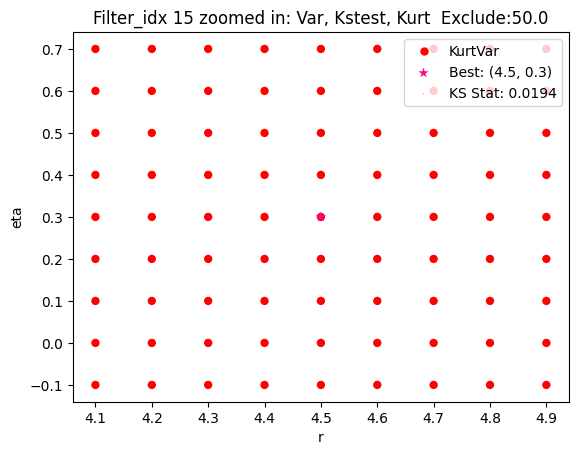

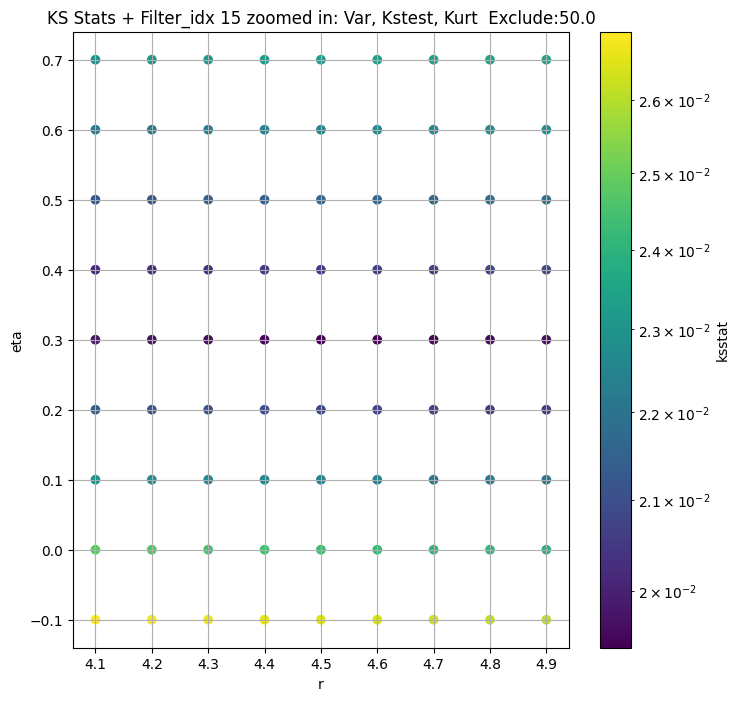

Filter_idx 16


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 16, 100.0 + 100 = 200, ksstat: 0.01079829352888416, var: 2.8017564939292603


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 16, 100.0 + 75 = 175, ksstat: 0.01067012969892056, var: 2.853379702118076


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 16, 100.0 + 50 = 150, ksstat: 0.010898811973406142, var: 2.9093138398051432


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 16, 100.0 + 25 = 125, ksstat: 0.010444530104072203, var: 2.9706242530844946


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 16, 100.0 + 0 = 100, ksstat: 0.010432960414069714, var: 3.0388773427352627


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 16, 100.0 + -25 = 75, ksstat: 0.01028194733360377, var: 3.1167007677544327


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 16, 100.0 + -50 = 50, ksstat: 0.010595816494637145, var: 3.2089710549718466


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 16, 100.0 + -75 = 25, ksstat: 0.010096369912569195, var: 3.327833949113942


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 16, 100.0 + -100 = 0, ksstat: 0.009719140084354039, var: 3.685564330396766
Number of samples: 100000, Without approximation : 196608000.0


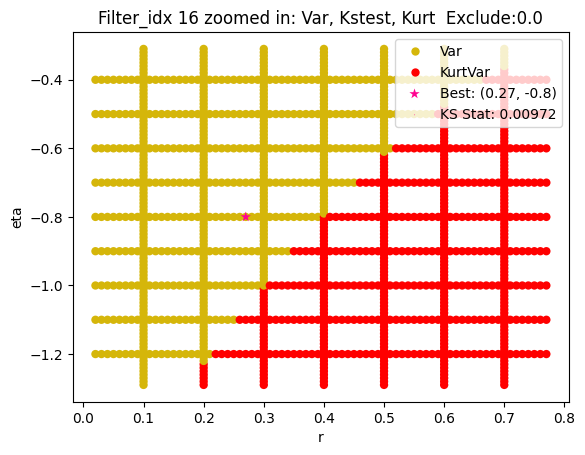

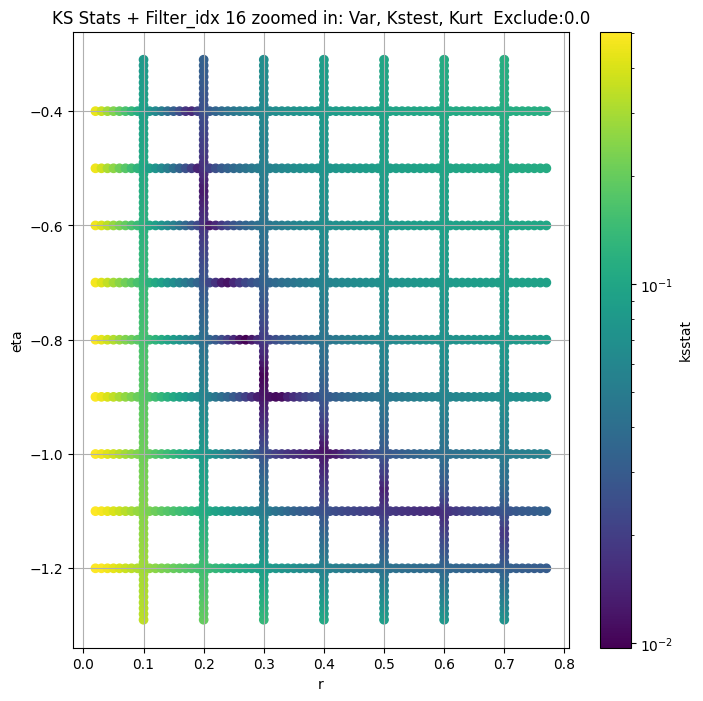

Filter_idx 17


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 100.0 + 100 = 200, ksstat: 0.013704749920455617, var: 4.6230127146411135


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 100.0 + 75 = 175, ksstat: 0.013950855347842683, var: 4.695599725831356


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 100.0 + 50 = 150, ksstat: 0.013631071954675805, var: 4.772362408580195


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 100.0 + 25 = 125, ksstat: 0.013360776902386226, var: 4.854126812866738


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 100.0 + 0 = 100, ksstat: 0.012847890841177767, var: 4.942115727230216


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 100.0 + -25 = 75, ksstat: 0.012255997347086295, var: 5.038305853282702


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 100.0 + -50 = 50, ksstat: 0.012270609993120116, var: 5.146219847506675


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 100.0 + -75 = 25, ksstat: 0.012206187791212408, var: 5.273746375831415


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 100.0 + -100 = 0, ksstat: 0.012518862818068077, var: 5.512060098087606
Number of samples: 100000, Without approximation : 196608000.0


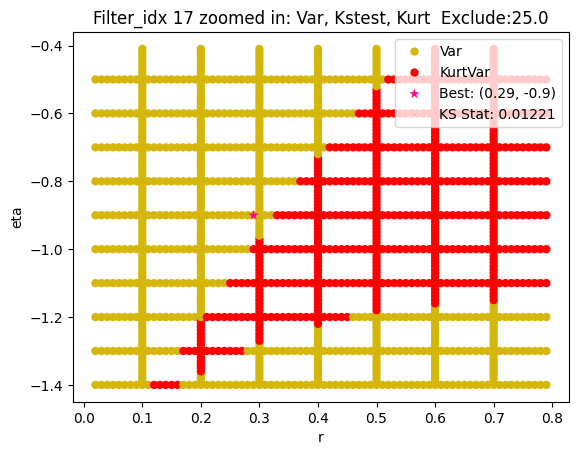

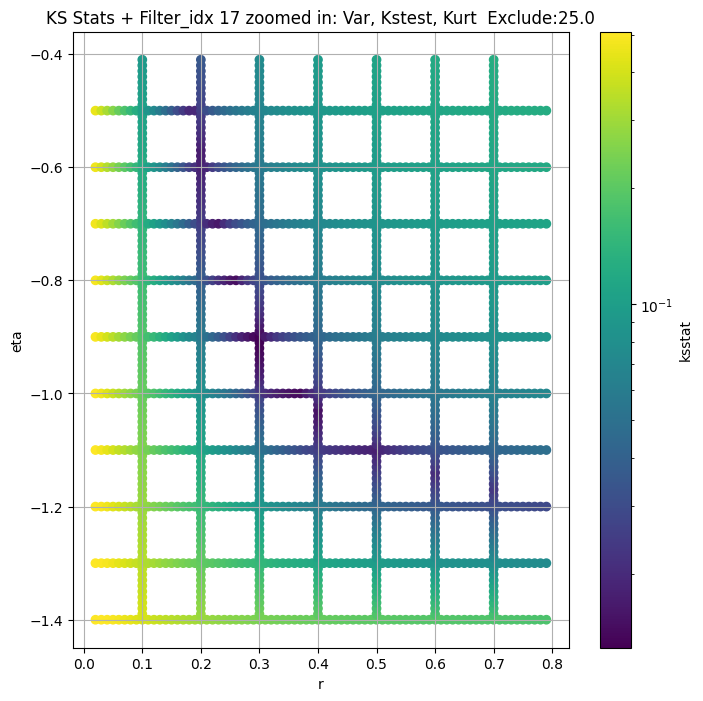

Filter_idx 18


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 18, 100.0 + 100 = 200, ksstat: 0.008465772891669138, var: 2.0257579077926353


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 18, 100.0 + 75 = 175, ksstat: 0.008357118297961708, var: 2.0680024908172587


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 18, 100.0 + 50 = 150, ksstat: 0.008703169241364273, var: 2.1140623269213425


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 18, 100.0 + 25 = 125, ksstat: 0.00855822421179897, var: 2.164880350153511


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 18, 100.0 + 0 = 100, ksstat: 0.008991742996341881, var: 2.2218846847040954


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 18, 100.0 + -25 = 75, ksstat: 0.008241109977867422, var: 2.287416496996914


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 18, 100.0 + -50 = 50, ksstat: 0.007525154814552709, var: 2.3658861923778622


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 18, 100.0 + -75 = 25, ksstat: 0.007370894771646319, var: 2.468156321322288


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 18, 100.0 + -100 = 0, ksstat: 0.007761379850249273, var: 2.7819095130280544
Number of samples: 100000, Without approximation : 196608000.0


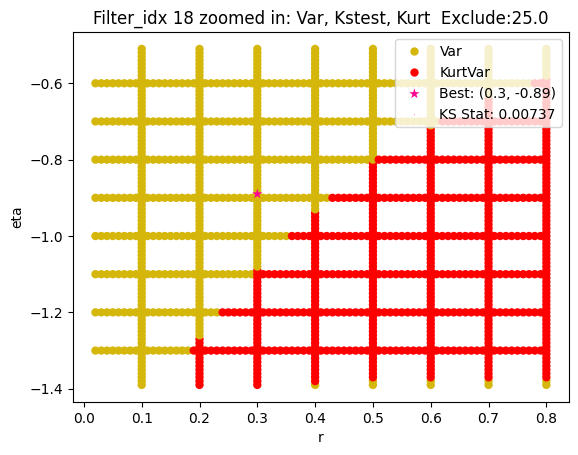

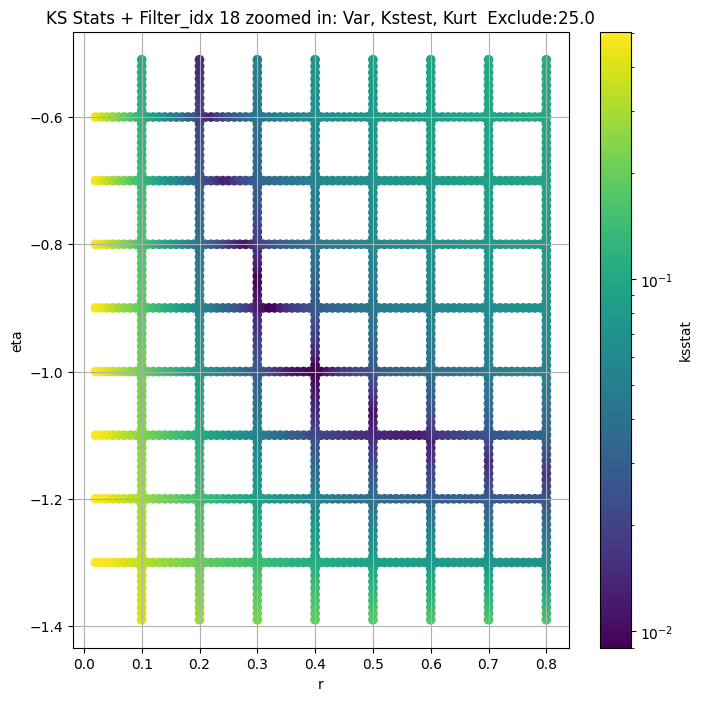

Filter_idx 19


  0%|          | 0/810 [00:00<?, ?it/s]

Finding Minimum after computing 810 CDFs
filter_idx 19, 0.0 + 100 = 100, ksstat: 0.022664462055173445, var: 8.413143617322097


  0%|          | 0/810 [00:00<?, ?it/s]

Finding Minimum after computing 810 CDFs
filter_idx 19, 0.0 + 75 = 75, ksstat: 0.02239874600572722, var: 8.47996463952359


  0%|          | 0/810 [00:00<?, ?it/s]

Finding Minimum after computing 810 CDFs
filter_idx 19, 0.0 + 50 = 50, ksstat: 0.021627544274268606, var: 8.554244680374586


  0%|          | 0/810 [00:00<?, ?it/s]

Finding Minimum after computing 810 CDFs
filter_idx 19, 0.0 + 25 = 25, ksstat: 0.021762824503935962, var: 8.640636998414987


  0%|          | 0/810 [00:00<?, ?it/s]

Finding Minimum after computing 810 CDFs
filter_idx 19, 0.0 + 0 = 0, ksstat: 0.021610317032869475, var: 8.81050758335045
Number of samples: 100000, Without approximation : 196608000.0


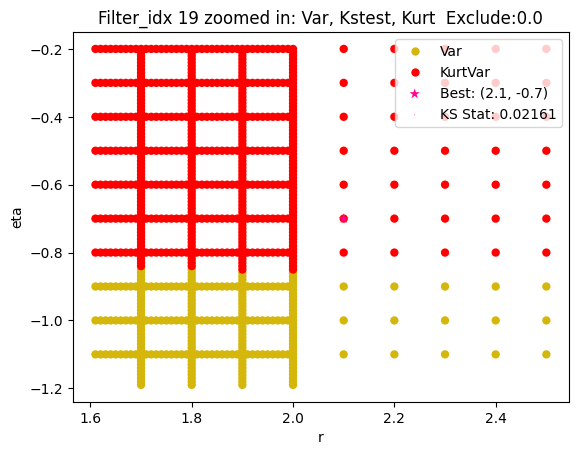

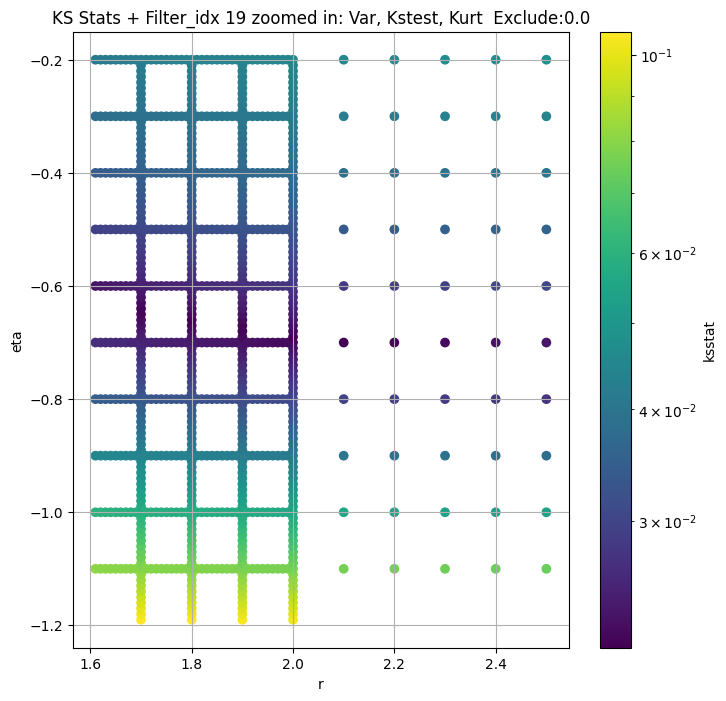

Filter_idx 20


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 20, 0.0 + 100 = 100, ksstat: 0.006615080336439108, var: 5.614335926473939


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 20, 0.0 + 75 = 75, ksstat: 0.005948892883282424, var: 5.747529767078954


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 20, 0.0 + 50 = 50, ksstat: 0.005916584297067096, var: 5.899504512046723


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 20, 0.0 + 25 = 25, ksstat: 0.005786083495435468, var: 6.083404293754419


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 20, 0.0 + 0 = 0, ksstat: 0.005601773701376406, var: 6.5114604403666325
Number of samples: 100000, Without approximation : 196608000.0


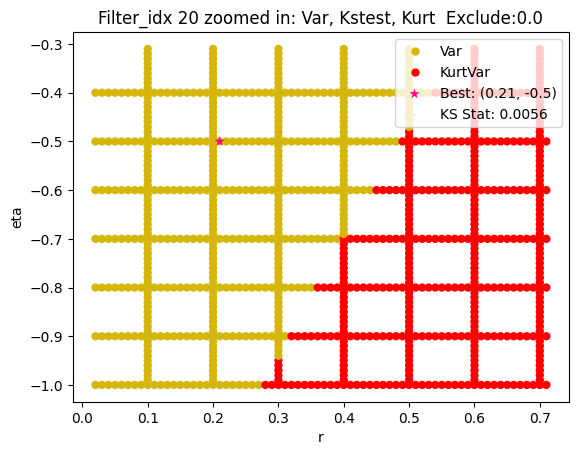

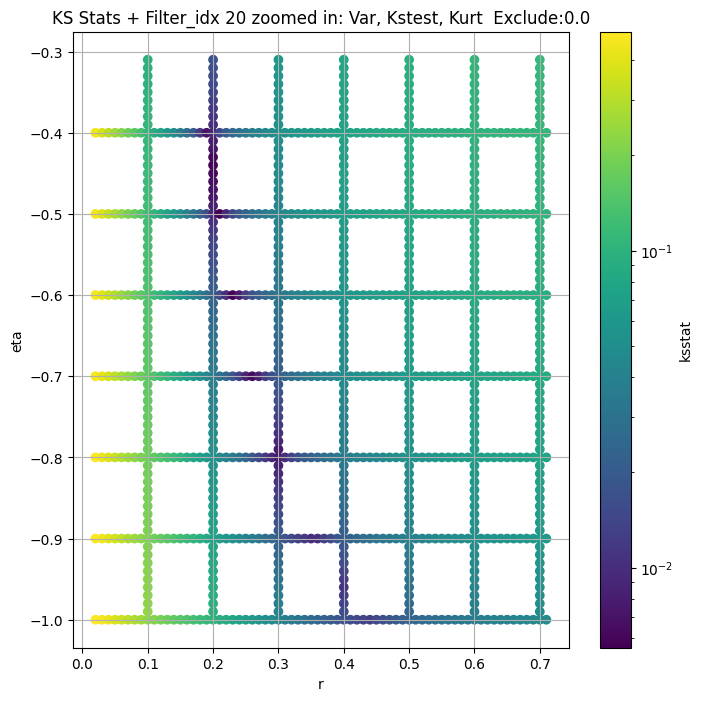

Filter_idx 21


  0%|          | 0/180 [00:00<?, ?it/s]

Finding Minimum after computing 180 CDFs
filter_idx 21, 0.0 + 100 = 100, ksstat: 0.027559690636418777, var: 16.084409564393315


  0%|          | 0/180 [00:00<?, ?it/s]

Finding Minimum after computing 180 CDFs
filter_idx 21, 0.0 + 75 = 75, ksstat: 0.027138374786395802, var: 16.21858115534109


  0%|          | 0/180 [00:00<?, ?it/s]

Finding Minimum after computing 180 CDFs
filter_idx 21, 0.0 + 50 = 50, ksstat: 0.02691896650081438, var: 16.369343246622492


  0%|          | 0/180 [00:00<?, ?it/s]

Finding Minimum after computing 180 CDFs
filter_idx 21, 0.0 + 25 = 25, ksstat: 0.026576939039844816, var: 16.548350082401875


  0%|          | 0/180 [00:00<?, ?it/s]

Finding Minimum after computing 180 CDFs
filter_idx 21, 0.0 + 0 = 0, ksstat: 0.02581435068938509, var: 16.940987670424363
Number of samples: 100000, Without approximation : 196608000.0


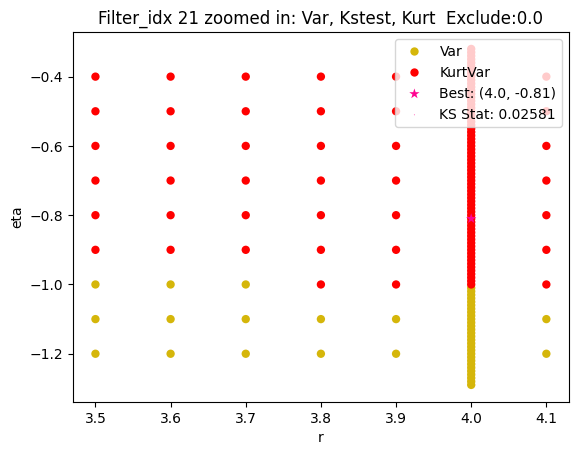

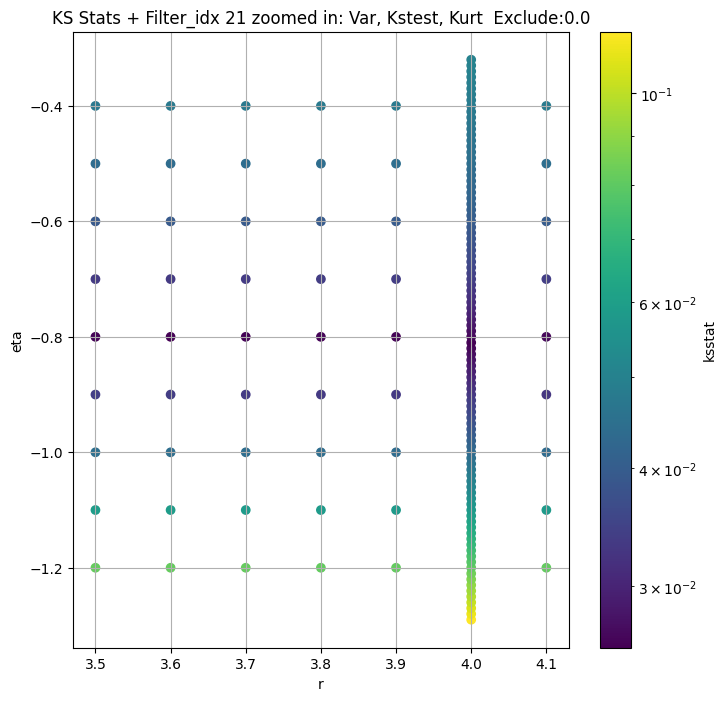

Filter_idx 22


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 22, 50.0 + 100 = 150, ksstat: 0.00726384089298282, var: 3.451329595503149


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 22, 50.0 + 75 = 125, ksstat: 0.007132323578775801, var: 3.52170316272411


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 22, 50.0 + 50 = 100, ksstat: 0.007370600021589846, var: 3.599355085320618


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 22, 50.0 + 25 = 75, ksstat: 0.006472728179485854, var: 3.6868172566223074


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 22, 50.0 + 0 = 50, ksstat: 0.0059754149958314295, var: 3.78867657529266


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 22, 50.0 + -25 = 25, ksstat: 0.0061610448013856844, var: 3.915640276136354


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 22, 50.0 + -50 = 0, ksstat: 0.006161060754191872, var: 4.190189072064269
Number of samples: 100000, Without approximation : 196608000.0


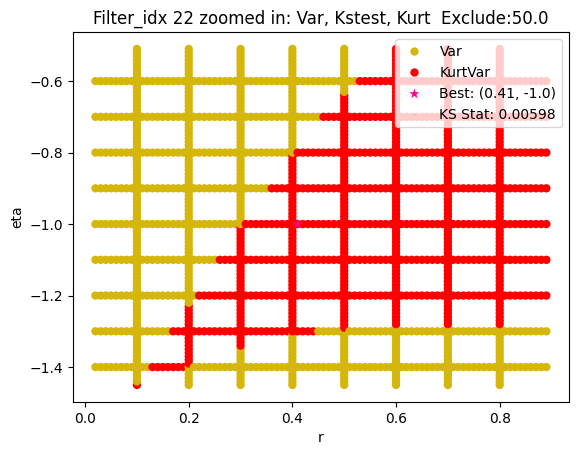

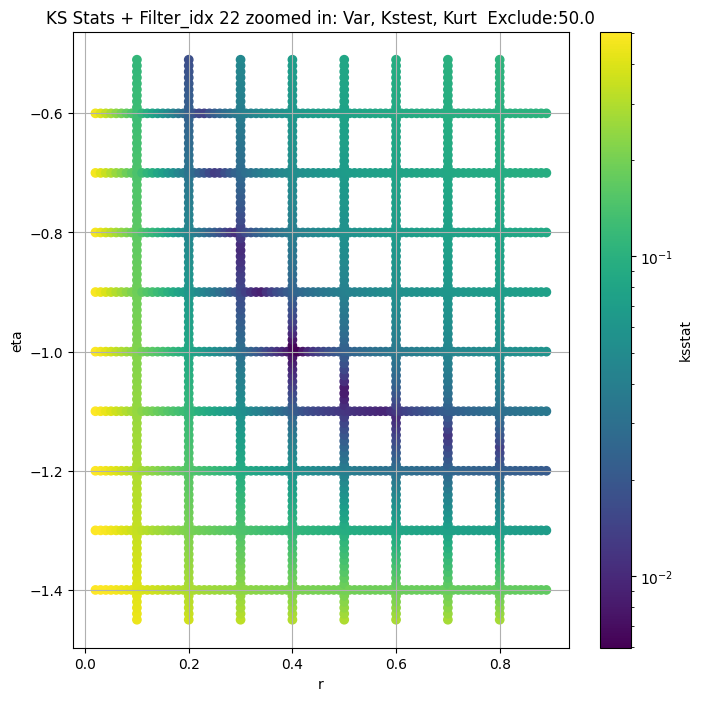

Filter_idx 23


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 100 = 100, ksstat: 0.007961299183093573, var: 2.629051660319697


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 75 = 75, ksstat: 0.008002052336341103, var: 2.691516548784109


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 50 = 50, ksstat: 0.0080911579353653, var: 2.7637995154881123


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 25 = 25, ksstat: 0.007947483316566223, var: 2.853317348566564


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 0 = 0, ksstat: 0.006662360624215435, var: 3.1143944590416934
Number of samples: 100000, Without approximation : 196608000.0


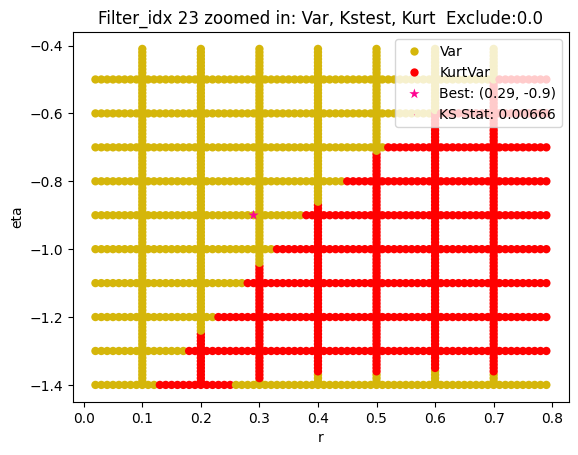

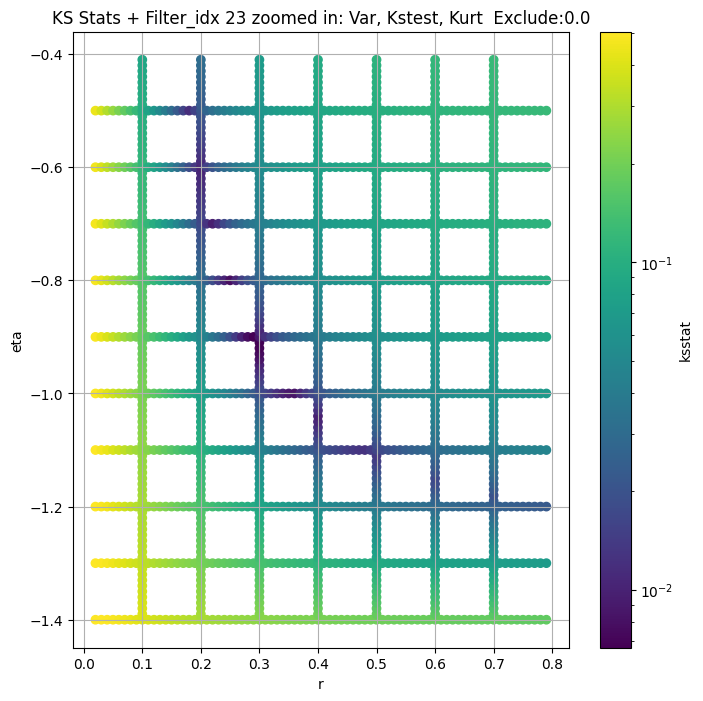

Filter_idx 24


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 100 = 100, ksstat: 0.010844194210304026, var: 2.9537947119746715


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 75 = 75, ksstat: 0.011007515228891485, var: 3.0448482678155817


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 50 = 50, ksstat: 0.010237058163898083, var: 3.1523382473182964


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 25 = 25, ksstat: 0.010111800610716204, var: 3.2893324947218607


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 0 = 0, ksstat: 0.010018337280238265, var: 3.638220124930815
Number of samples: 100000, Without approximation : 196608000.0


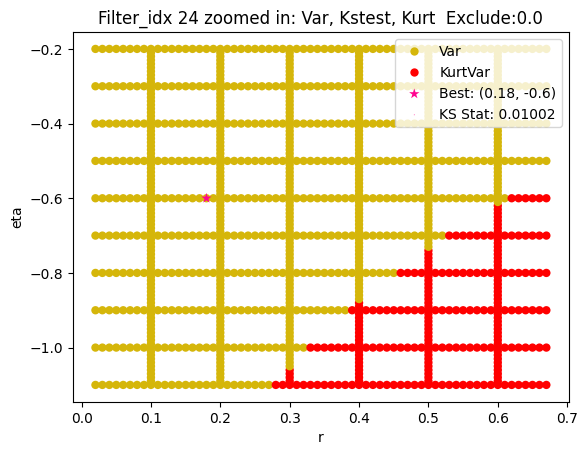

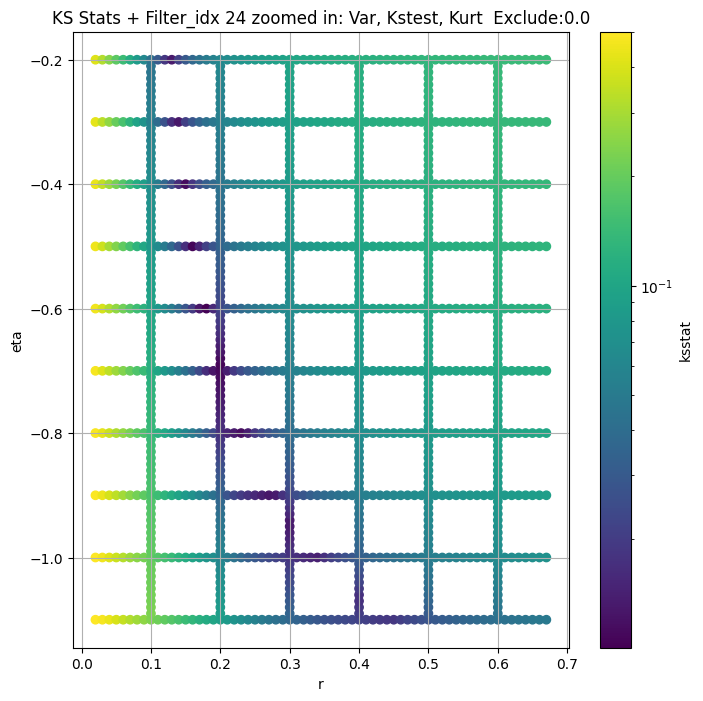

Filter_idx 25


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 0.0 + 100 = 100, ksstat: 0.008606447882835544, var: 4.206298438769095


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 0.0 + 75 = 75, ksstat: 0.007932819910180466, var: 4.32042530609034


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 0.0 + 50 = 50, ksstat: 0.008205171256883581, var: 4.455330230708685


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 0.0 + 25 = 25, ksstat: 0.008146386232852632, var: 4.628092134938269


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 0.0 + 0 = 0, ksstat: 0.008241800433798852, var: 5.047052985853809
Number of samples: 100000, Without approximation : 196608000.0


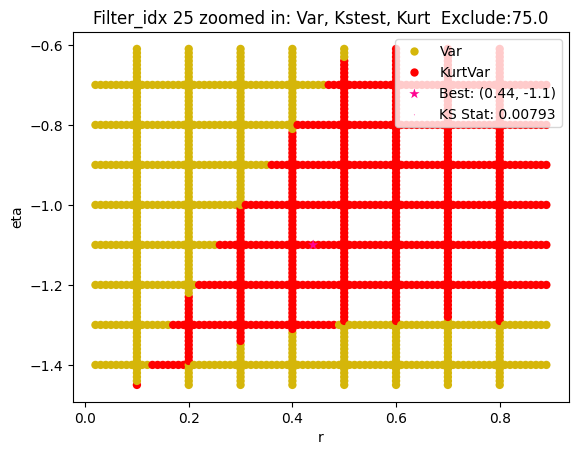

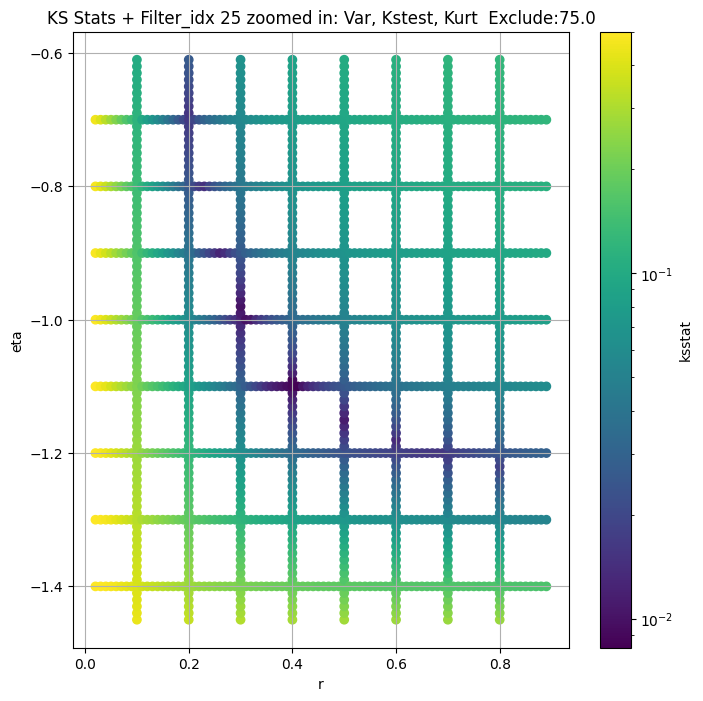

Filter_idx 26


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 26, 0.0 + 100 = 100, ksstat: 0.010115358366232785, var: 3.2166087058191604


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 26, 0.0 + 75 = 75, ksstat: 0.010309718624914033, var: 3.2765653098760588


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 26, 0.0 + 50 = 50, ksstat: 0.010076388857787416, var: 3.345636714197064


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 26, 0.0 + 25 = 25, ksstat: 0.009786334822769749, var: 3.430464635502345


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 26, 0.0 + 0 = 0, ksstat: 0.009827263176000134, var: 3.6602117946603467
Number of samples: 100000, Without approximation : 196608000.0


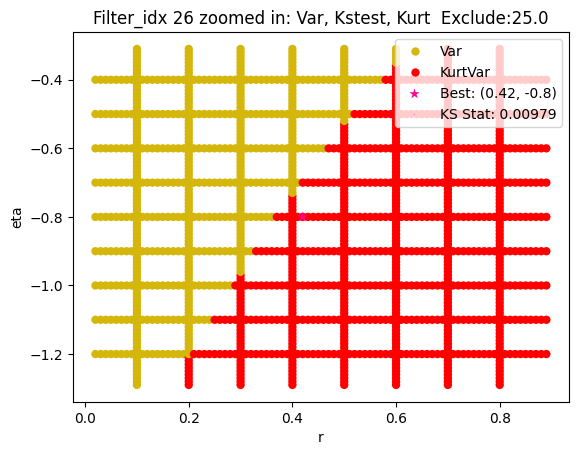

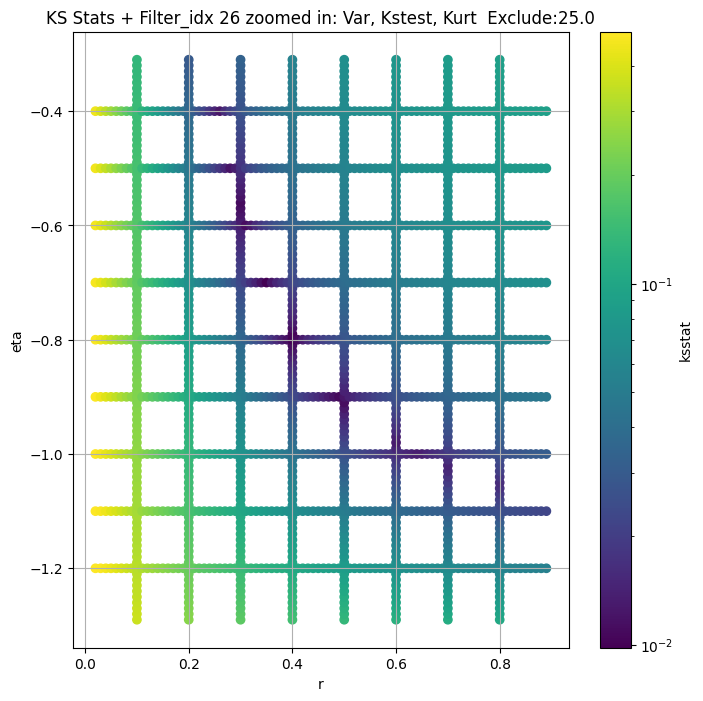

Filter_idx 27


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 100.0 + 100 = 200, ksstat: 0.011673653864416988, var: 2.374295937466964


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 100.0 + 75 = 175, ksstat: 0.011545448129775898, var: 2.4258793609411238


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 100.0 + 50 = 150, ksstat: 0.01141025669537743, var: 2.482117271964512


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 100.0 + 25 = 125, ksstat: 0.011224488287576273, var: 2.5441554696211166


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 100.0 + 0 = 100, ksstat: 0.011358993303765996, var: 2.61369934151101


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 100.0 + -25 = 75, ksstat: 0.011391566751175475, var: 2.6935805587369015


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 100.0 + -50 = 50, ksstat: 0.011783094048907983, var: 2.7889635309225795


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 100.0 + -75 = 25, ksstat: 0.011369741444029136, var: 2.9122852189431008


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 100.0 + -100 = 0, ksstat: 0.010023516322475112, var: 3.254640355051365
Number of samples: 100000, Without approximation : 196608000.0


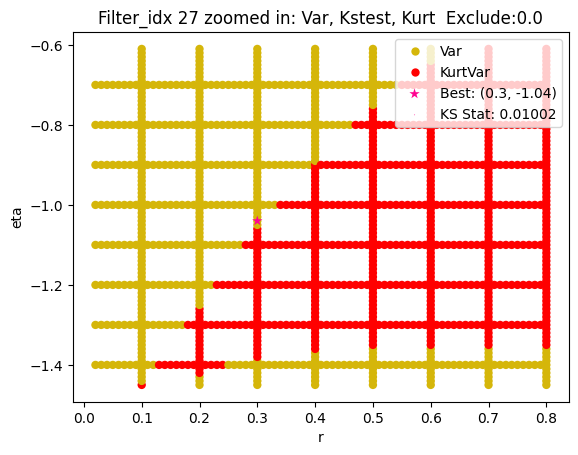

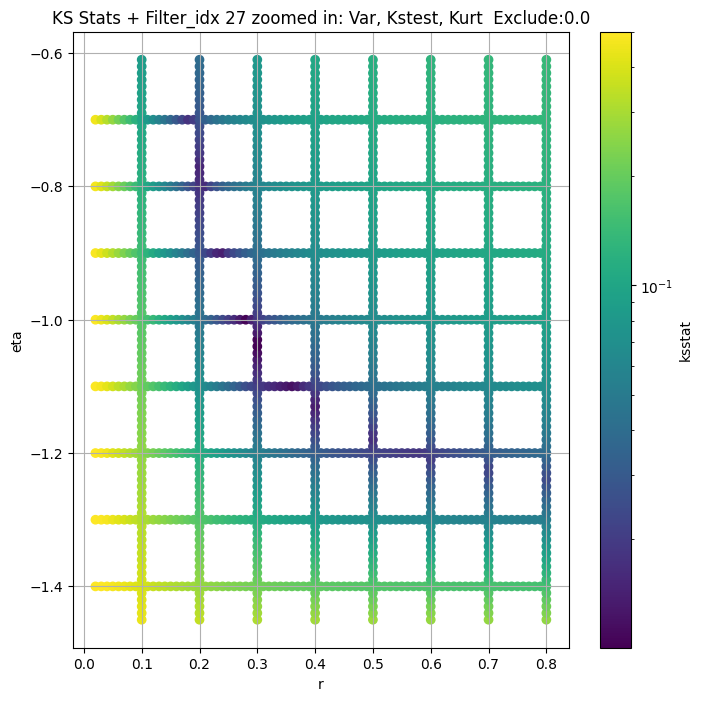

Filter_idx 28


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 28, 0.0 + 100 = 100, ksstat: 0.008234865210289544, var: 3.1247451983590144


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 28, 0.0 + 75 = 75, ksstat: 0.008225247768936794, var: 3.2198522719605314


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 28, 0.0 + 50 = 50, ksstat: 0.008094806056233361, var: 3.3320335137934696


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 28, 0.0 + 25 = 25, ksstat: 0.0072104740179866345, var: 3.4746477540475005


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 28, 0.0 + 0 = 0, ksstat: 0.0067589689319951796, var: 3.895680326926129
Number of samples: 100000, Without approximation : 196608000.0


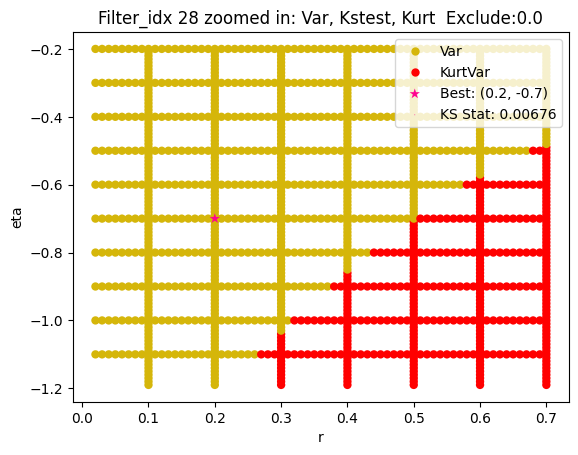

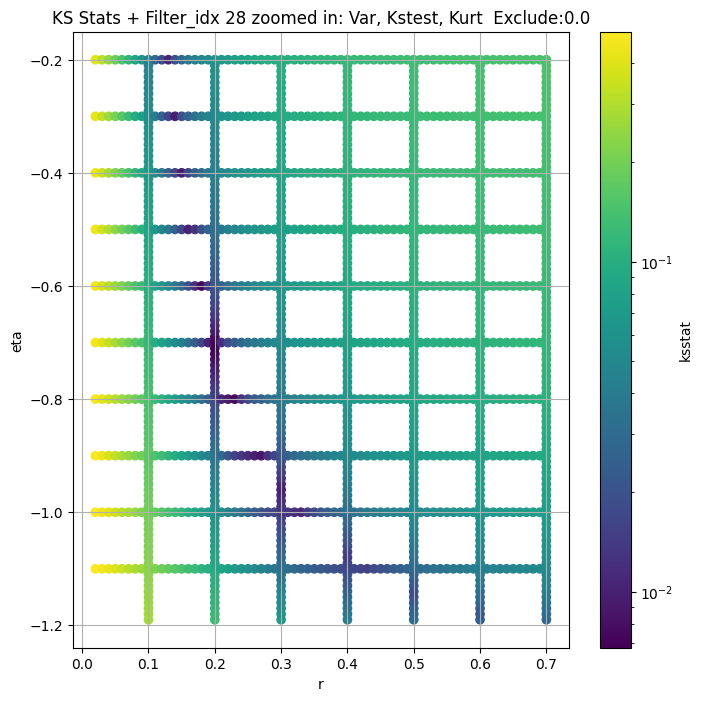

Filter_idx 29


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + 100 = 300, ksstat: 0.016262038361447073, var: 1.5960742579821428


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + 75 = 275, ksstat: 0.016142558610211244, var: 1.6232461400299736


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + 50 = 250, ksstat: 0.01676243293874763, var: 1.6518932929741945


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + 25 = 225, ksstat: 0.016515808530654985, var: 1.6822168898597134


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + 0 = 200, ksstat: 0.016426070574239116, var: 1.7144724422319957


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + -25 = 175, ksstat: 0.017250018473539797, var: 1.7489769057512838


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + -50 = 150, ksstat: 0.01693743475976367, var: 1.7861697576343312


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + -75 = 125, ksstat: 0.01667276745313323, var: 1.8266788053828948


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + -100 = 100, ksstat: 0.017606483936285666, var: 1.871379851469368
Number of samples: 100000, Without approximation : 196608000.0


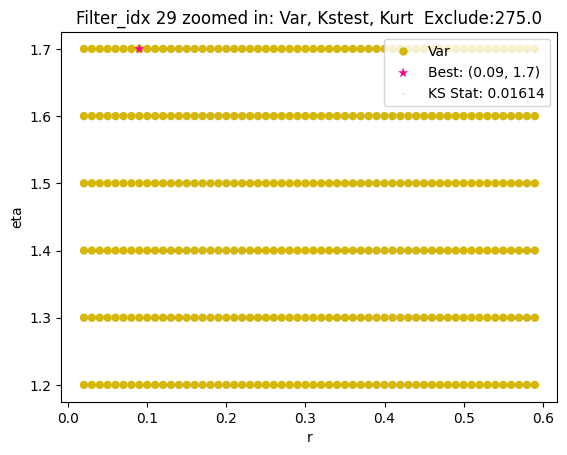

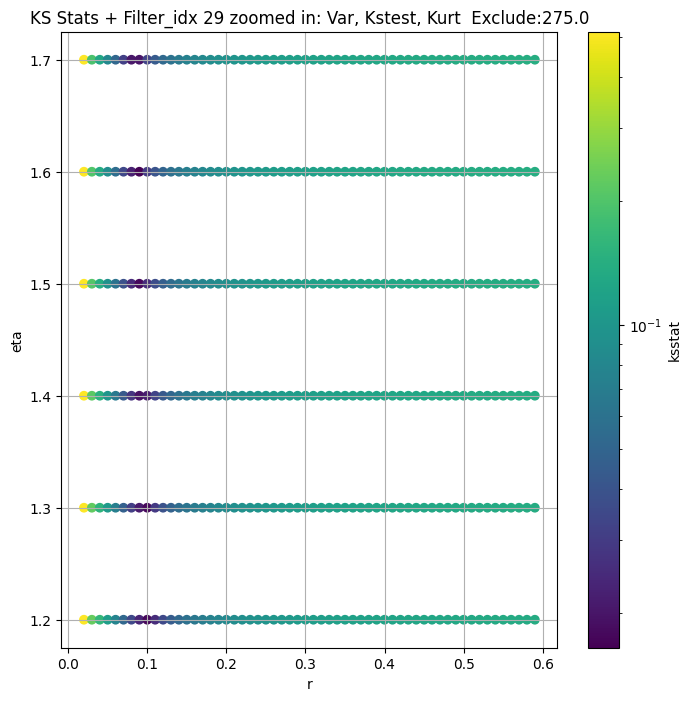

Filter_idx 30


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 30, 100.0 + 100 = 200, ksstat: 0.011184327384105186, var: 2.136078214260093


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 30, 100.0 + 75 = 175, ksstat: 0.011338394000637741, var: 2.185169691792714


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 30, 100.0 + 50 = 150, ksstat: 0.011209435506378651, var: 2.23853627148418


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 30, 100.0 + 25 = 125, ksstat: 0.01107922399279565, var: 2.297208634064957


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 30, 100.0 + 0 = 100, ksstat: 0.010975506563419113, var: 2.3626928428513625


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 30, 100.0 + -25 = 75, ksstat: 0.010656280674359031, var: 2.437375206571359


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 30, 100.0 + -50 = 50, ksstat: 0.01042376056615868, var: 2.5257992994060294


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 30, 100.0 + -75 = 25, ksstat: 0.010380311527281416, var: 2.638810201299016


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 30, 100.0 + -100 = 0, ksstat: 0.0106414325705938, var: 2.929029328316167
Number of samples: 100000, Without approximation : 196608000.0


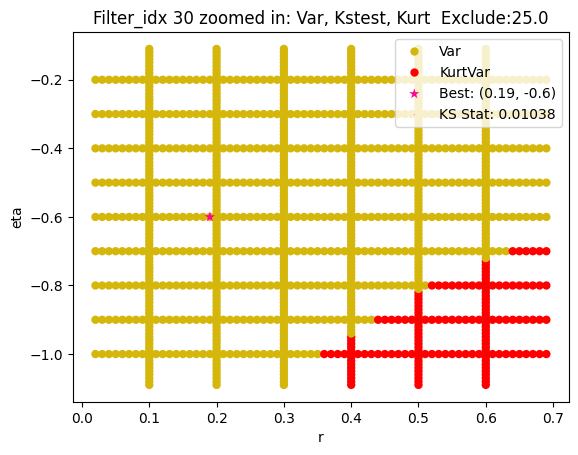

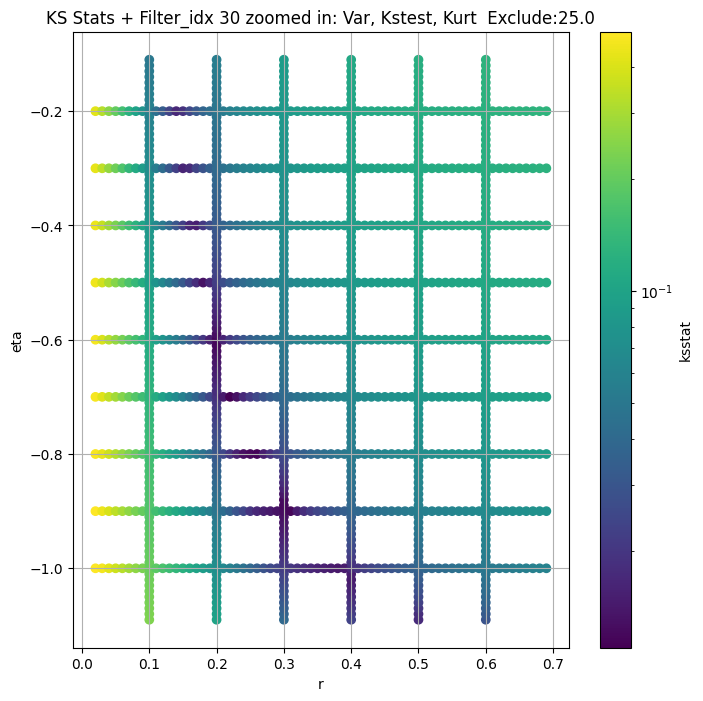

Filter_idx 31


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 31, 0.0 + 100 = 100, ksstat: 0.012139736414045088, var: 3.746834418933566


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 31, 0.0 + 75 = 75, ksstat: 0.012164906511587747, var: 3.799429346460695


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 31, 0.0 + 50 = 50, ksstat: 0.012306332324832206, var: 3.8586942162095585


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 31, 0.0 + 25 = 25, ksstat: 0.012110511569848284, var: 3.929538032373964


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 31, 0.0 + 0 = 0, ksstat: 0.012172381994461912, var: 4.122970071977911
Number of samples: 100000, Without approximation : 196608000.0


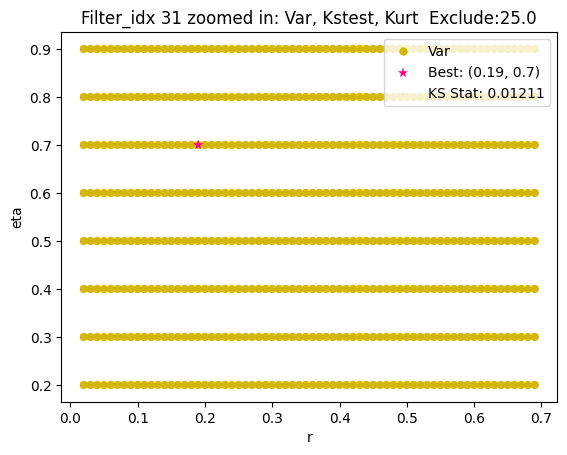

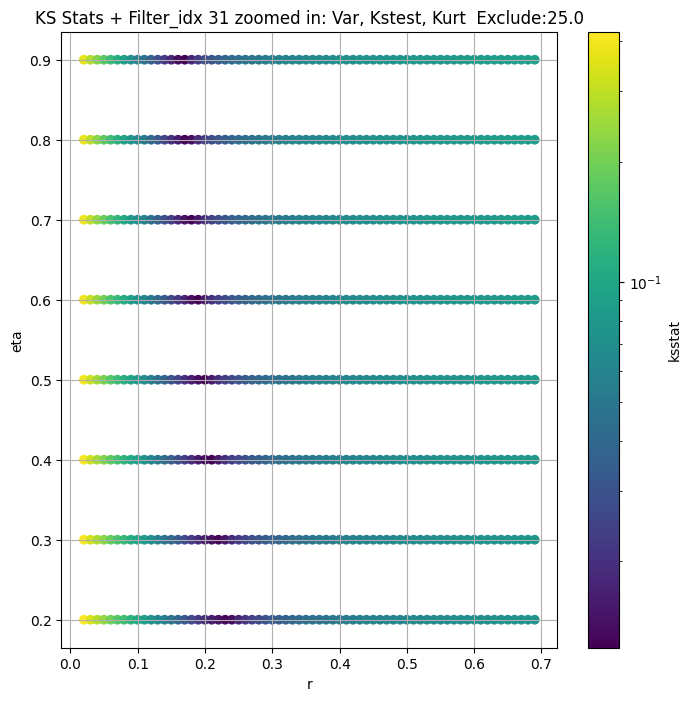

Filter_idx 32


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 50.0 + 100 = 150, ksstat: 0.007923209816925347, var: 2.4573530430746335


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 50.0 + 75 = 125, ksstat: 0.00792809930627325, var: 2.506306804483357


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 50.0 + 50 = 100, ksstat: 0.0076213289281047425, var: 2.5601107287962113


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 50.0 + 25 = 75, ksstat: 0.007424982212534625, var: 2.6204457382366884


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 50.0 + 0 = 50, ksstat: 0.006983258858519803, var: 2.6903410728508006


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 50.0 + -25 = 25, ksstat: 0.006183780658605587, var: 2.7769886627110365


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 50.0 + -50 = 0, ksstat: 0.007102983525580808, var: 3.016518217170903
Number of samples: 100000, Without approximation : 196608000.0


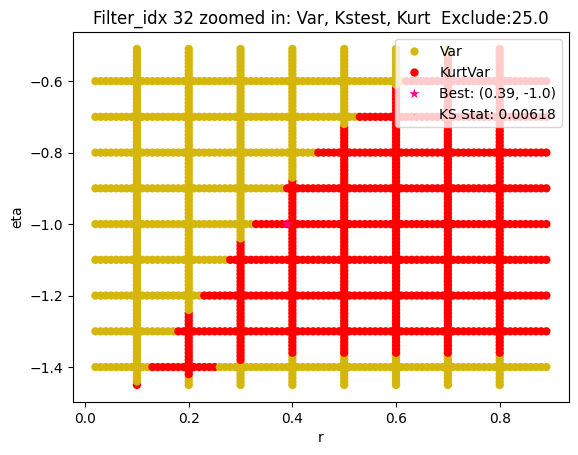

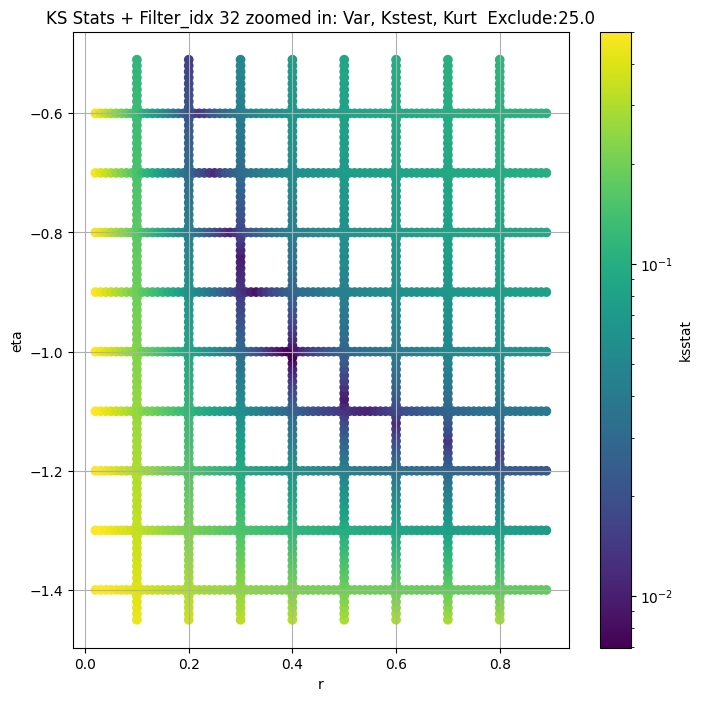

Filter_idx 33


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 33, 200.0 + 100 = 300, ksstat: 0.009390668807276403, var: 1.7908799332617602


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 33, 200.0 + 75 = 275, ksstat: 0.009262567857823145, var: 1.8209870740273133


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 33, 200.0 + 50 = 250, ksstat: 0.009129969106899505, var: 1.8528965733037137


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 33, 200.0 + 25 = 225, ksstat: 0.0094196600258325, var: 1.8868833305943074


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 33, 200.0 + 0 = 200, ksstat: 0.00967900416295342, var: 1.9232853770035812


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 33, 200.0 + -25 = 175, ksstat: 0.009225157029384534, var: 1.9625486139039618


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 33, 200.0 + -50 = 150, ksstat: 0.008804793437632408, var: 2.0052982552549703


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 33, 200.0 + -75 = 125, ksstat: 0.007849678812839989, var: 2.0524208388793017


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 33, 200.0 + -100 = 100, ksstat: 0.008510064930911998, var: 2.105233886218333
Number of samples: 100000, Without approximation : 196608000.0


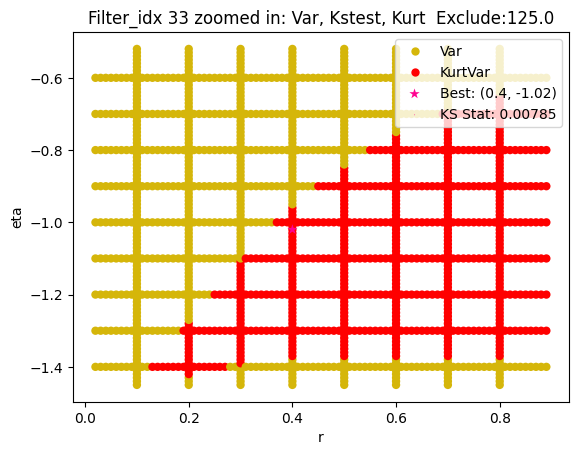

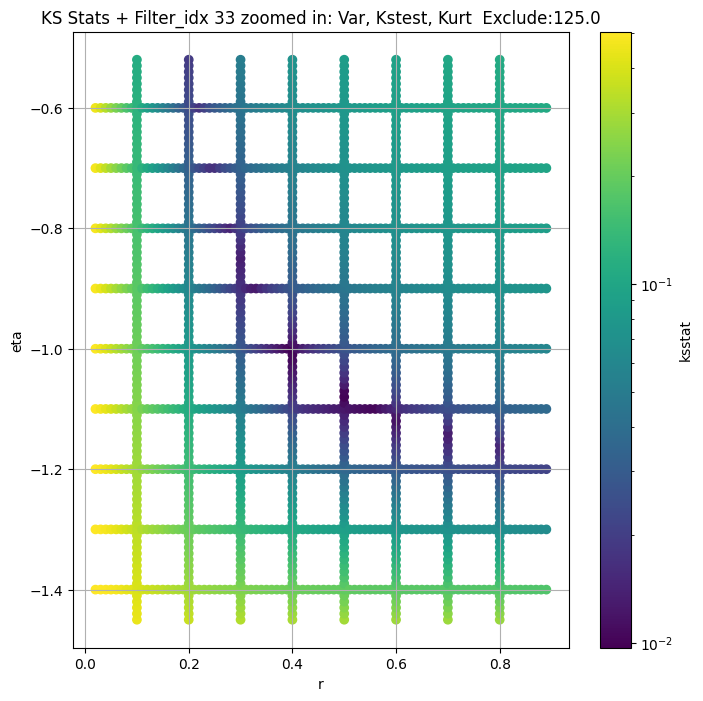

Filter_idx 34


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 34, 200.0 + 100 = 300, ksstat: 0.009928437470643647, var: 2.118725798754687


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 34, 200.0 + 75 = 275, ksstat: 0.009837956745639809, var: 2.1587326295224303


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 34, 200.0 + 50 = 250, ksstat: 0.00973905959788346, var: 2.201098446562975


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 34, 200.0 + 25 = 225, ksstat: 0.00966462823014591, var: 2.24613431046363


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 34, 200.0 + 0 = 200, ksstat: 0.009213511355291137, var: 2.2942735603272144


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 34, 200.0 + -25 = 175, ksstat: 0.008771694144391162, var: 2.3460514660813114


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 34, 200.0 + -50 = 150, ksstat: 0.008832415050649911, var: 2.4021878597550184


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 34, 200.0 + -75 = 125, ksstat: 0.008736119122504438, var: 2.4637333805184243


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 34, 200.0 + -100 = 100, ksstat: 0.008717283892912764, var: 2.53221320794042
Number of samples: 100000, Without approximation : 196608000.0


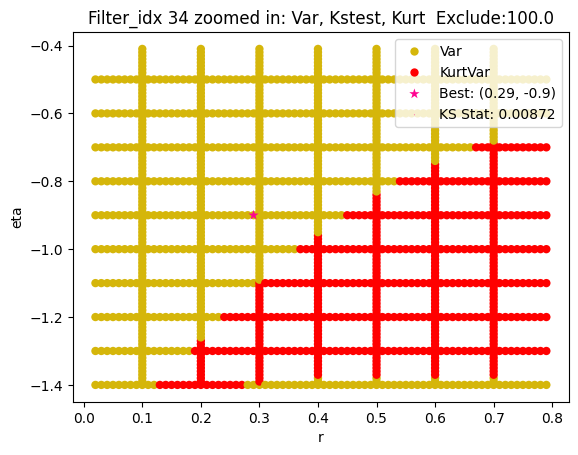

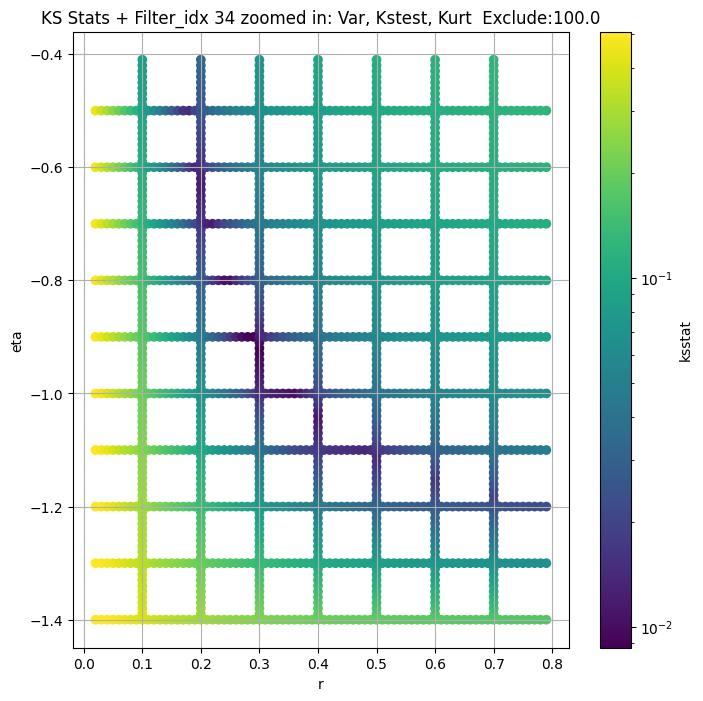

Filter_idx 35


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 35, 0.0 + 100 = 100, ksstat: 0.010612512418318648, var: 13.251630537536299


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 35, 0.0 + 75 = 75, ksstat: 0.010128351360502039, var: 13.354660513733304


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 35, 0.0 + 50 = 50, ksstat: 0.009542083436980472, var: 13.469112087947366


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 35, 0.0 + 25 = 25, ksstat: 0.008832221720335987, var: 13.601797343834132


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 35, 0.0 + 0 = 0, ksstat: 0.007658946767844482, var: 13.84805788323212
Number of samples: 100000, Without approximation : 196608000.0


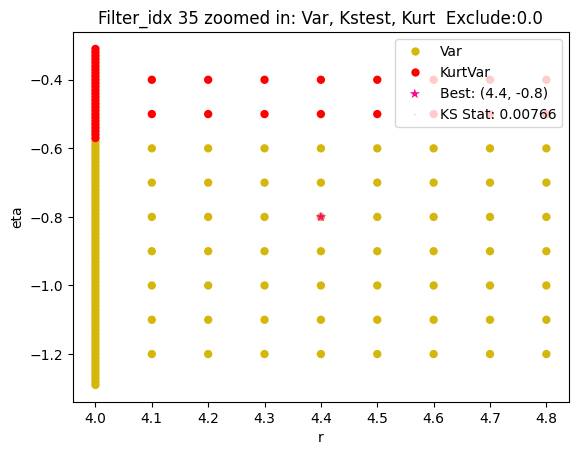

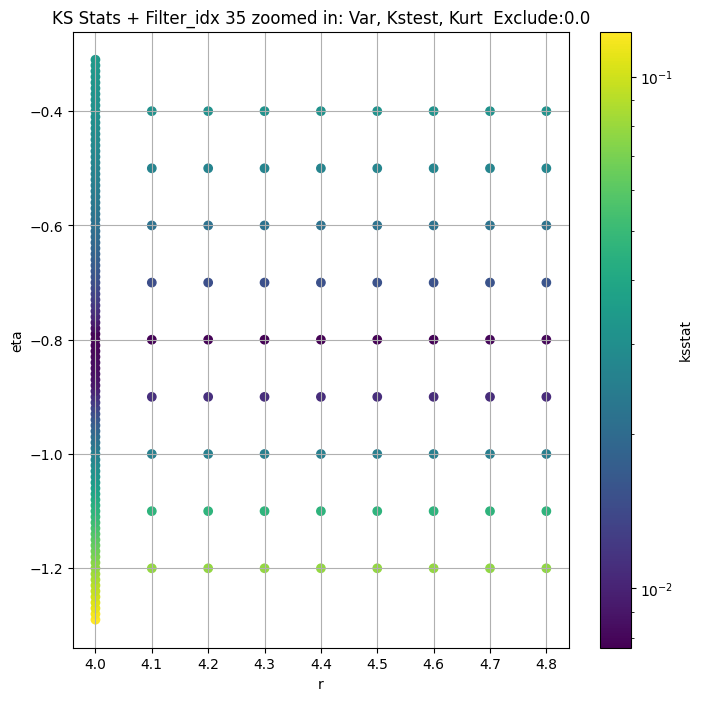

Filter_idx 36


  0%|          | 0/990 [00:00<?, ?it/s]

Finding Minimum after computing 990 CDFs
filter_idx 36, 0.0 + 100 = 100, ksstat: 0.009126252146647085, var: 6.715780505280026


  0%|          | 0/990 [00:00<?, ?it/s]

Finding Minimum after computing 990 CDFs
filter_idx 36, 0.0 + 75 = 75, ksstat: 0.008769627567242963, var: 6.763688416149967


  0%|          | 0/990 [00:00<?, ?it/s]

Finding Minimum after computing 990 CDFs
filter_idx 36, 0.0 + 50 = 50, ksstat: 0.008370641194237666, var: 6.81719771844464


  0%|          | 0/990 [00:00<?, ?it/s]

Finding Minimum after computing 990 CDFs
filter_idx 36, 0.0 + 25 = 25, ksstat: 0.007905695402848467, var: 6.880488776865762


  0%|          | 0/990 [00:00<?, ?it/s]

Finding Minimum after computing 990 CDFs
filter_idx 36, 0.0 + 0 = 0, ksstat: 0.007254045015997565, var: 7.040786253131293
Number of samples: 100000, Without approximation : 196608000.0


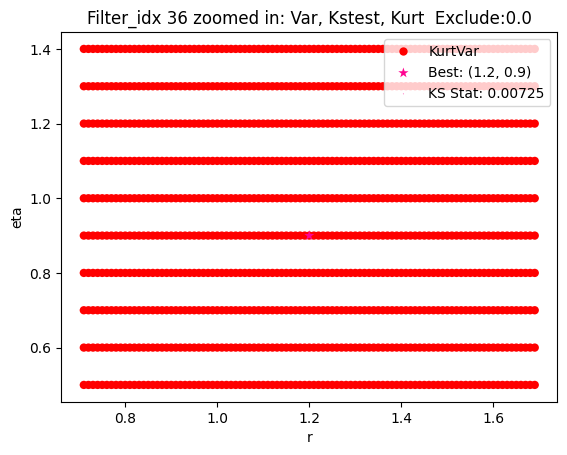

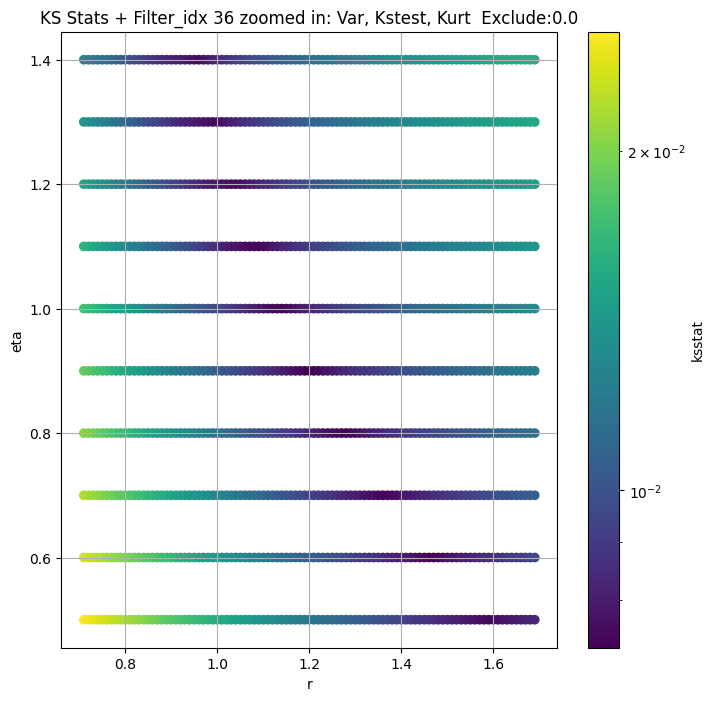

Filter_idx 37


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 37, 0.0 + 100 = 100, ksstat: 0.022356381149673532, var: 14.426241398401519


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 37, 0.0 + 75 = 75, ksstat: 0.022133632382629387, var: 14.549886877814167


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 37, 0.0 + 50 = 50, ksstat: 0.0218575104197887, var: 14.688876096413253


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 37, 0.0 + 25 = 25, ksstat: 0.021447283125630295, var: 14.854482488581116


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 37, 0.0 + 0 = 0, ksstat: 0.02056194396131006, var: 15.200028728462916
Number of samples: 100000, Without approximation : 196608000.0


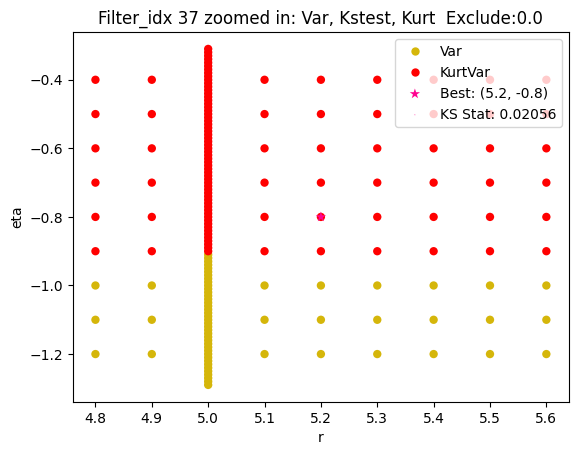

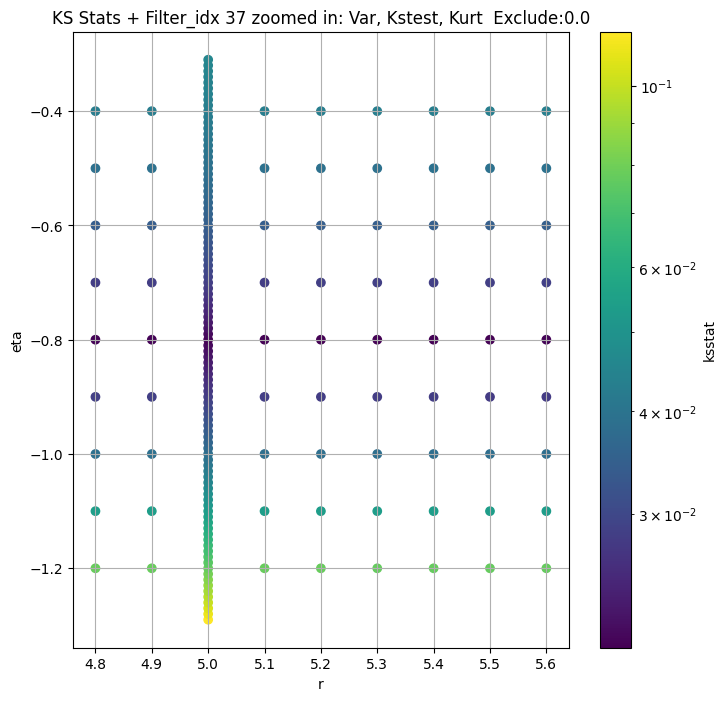

Filter_idx 38


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 0.0 + 100 = 100, ksstat: 0.010944777057937505, var: 5.552774354418197


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 0.0 + 75 = 75, ksstat: 0.010679178504620315, var: 5.665799130674845


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 0.0 + 50 = 50, ksstat: 0.01071101479899135, var: 5.794936895028381


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 0.0 + 25 = 25, ksstat: 0.00974480034155839, var: 5.950752576605356


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 0.0 + 0 = 0, ksstat: 0.01002787043052017, var: 6.32019143295072
Number of samples: 100000, Without approximation : 196608000.0


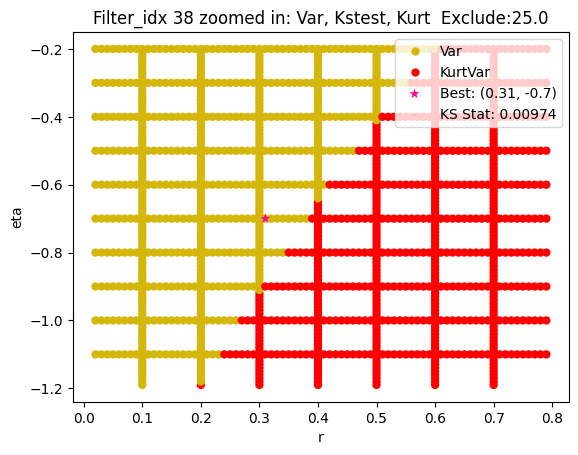

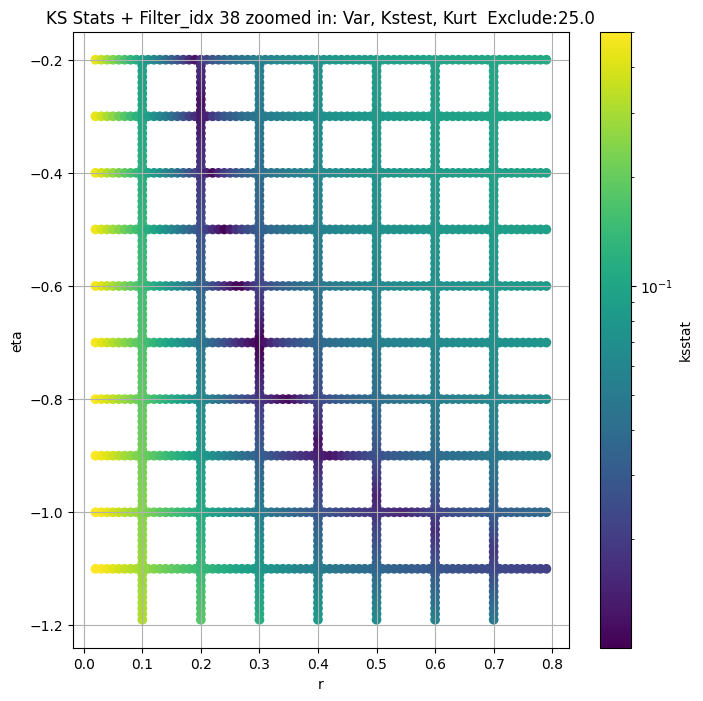

Filter_idx 39


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 50.0 + 100 = 150, ksstat: 0.01347819289685881, var: 4.145548925021078


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 50.0 + 75 = 125, ksstat: 0.012912971391360939, var: 4.1985662956804415


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 50.0 + 50 = 100, ksstat: 0.012709705452500497, var: 4.256091552153781


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 50.0 + 25 = 75, ksstat: 0.012437065340887177, var: 4.319583697849019


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 50.0 + 0 = 50, ksstat: 0.012089152428418015, var: 4.391781818982652


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 50.0 + -25 = 25, ksstat: 0.012571337371576008, var: 4.4790378769730586


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 50.0 + -50 = 0, ksstat: 0.01290505711921186, var: 4.7153702362393375
Number of samples: 100000, Without approximation : 196608000.0


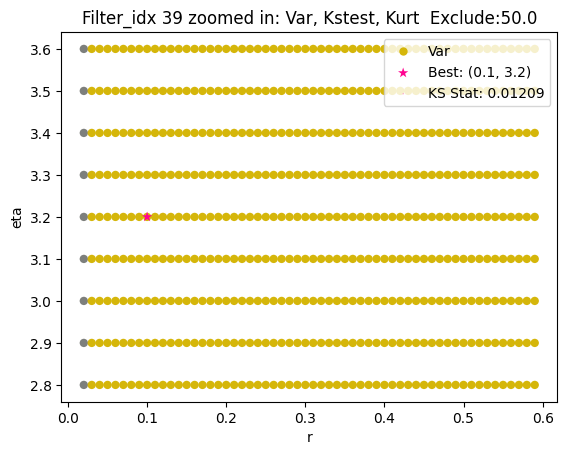

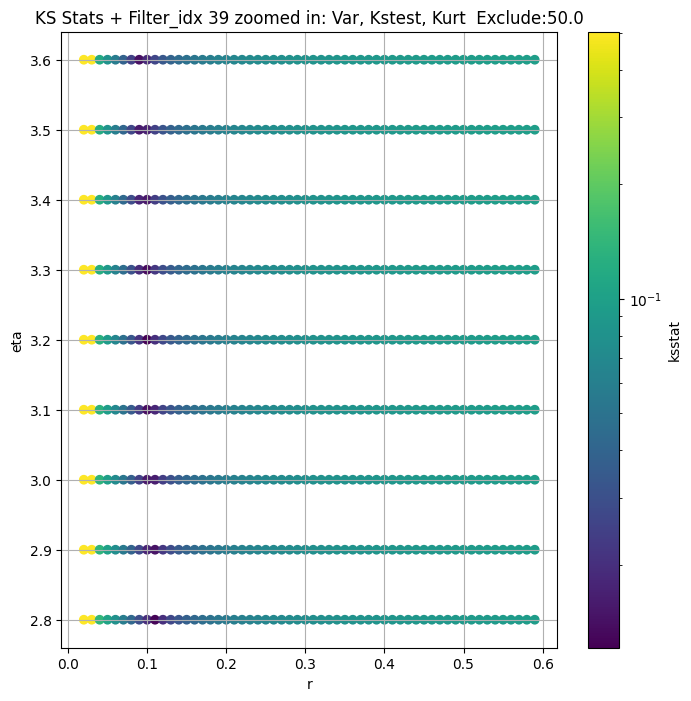

Filter_idx 40


  0%|          | 0/153 [00:00<?, ?it/s]

Finding Minimum after computing 153 CDFs
filter_idx 40, 0.0 + 100 = 100, ksstat: 0.029995858571504774, var: 5.367712274866881


  0%|          | 0/153 [00:00<?, ?it/s]

Finding Minimum after computing 153 CDFs
filter_idx 40, 0.0 + 75 = 75, ksstat: 0.029996957703985694, var: 5.404872011081096


  0%|          | 0/153 [00:00<?, ?it/s]

Finding Minimum after computing 153 CDFs
filter_idx 40, 0.0 + 50 = 50, ksstat: 0.029995716987779142, var: 5.44610671941782


  0%|          | 0/153 [00:00<?, ?it/s]

Finding Minimum after computing 153 CDFs
filter_idx 40, 0.0 + 25 = 25, ksstat: 0.029999584659834433, var: 5.4944433575254585


  0%|          | 0/153 [00:00<?, ?it/s]

Finding Minimum after computing 153 CDFs
filter_idx 40, 0.0 + 0 = 0, ksstat: 0.029995395346414155, var: 5.621045718093805
Number of samples: 100000, Without approximation : 196608000.0


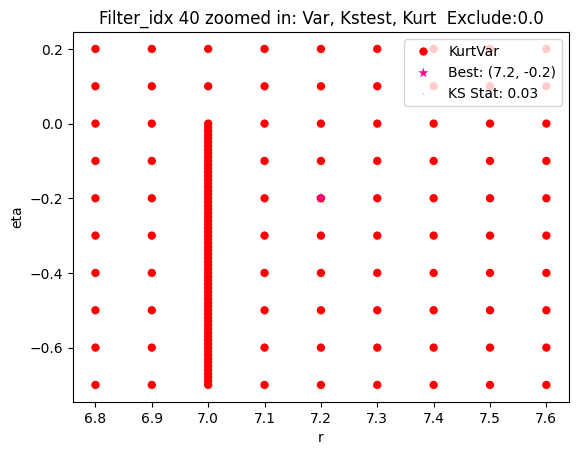

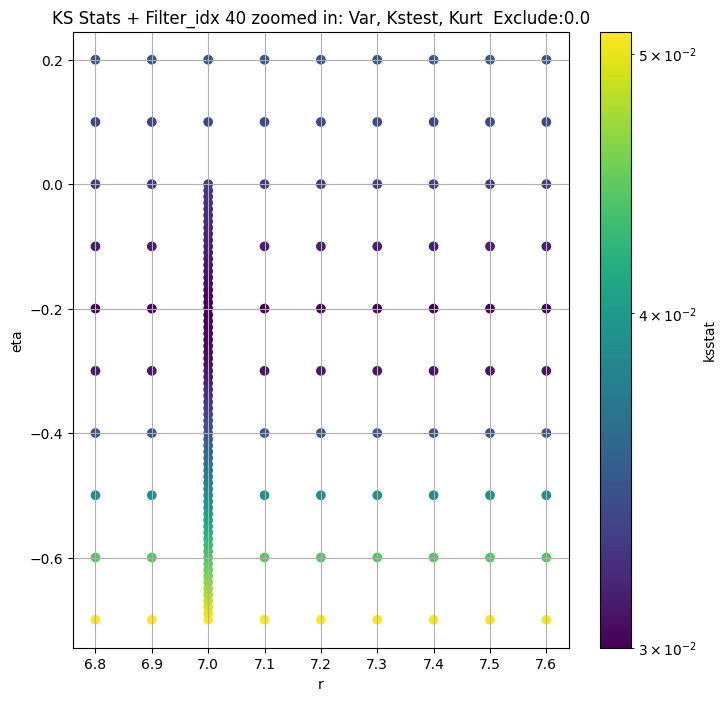

Filter_idx 41


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 41, 0.0 + 100 = 100, ksstat: 0.007833802941875245, var: 2.439005180491382


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 41, 0.0 + 75 = 75, ksstat: 0.007677022996254224, var: 2.5092006971343226


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 41, 0.0 + 50 = 50, ksstat: 0.0075757873023282185, var: 2.593211531395669


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 41, 0.0 + 25 = 25, ksstat: 0.0067041352289549105, var: 2.702593796362017


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 41, 0.0 + 0 = 0, ksstat: 0.007018769454424478, var: 3.005167781922227
Number of samples: 100000, Without approximation : 196608000.0


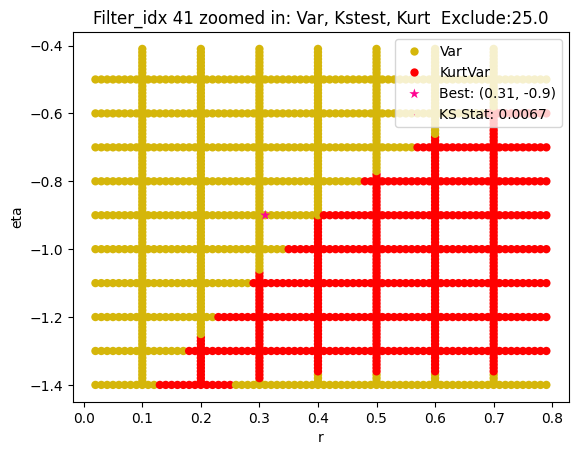

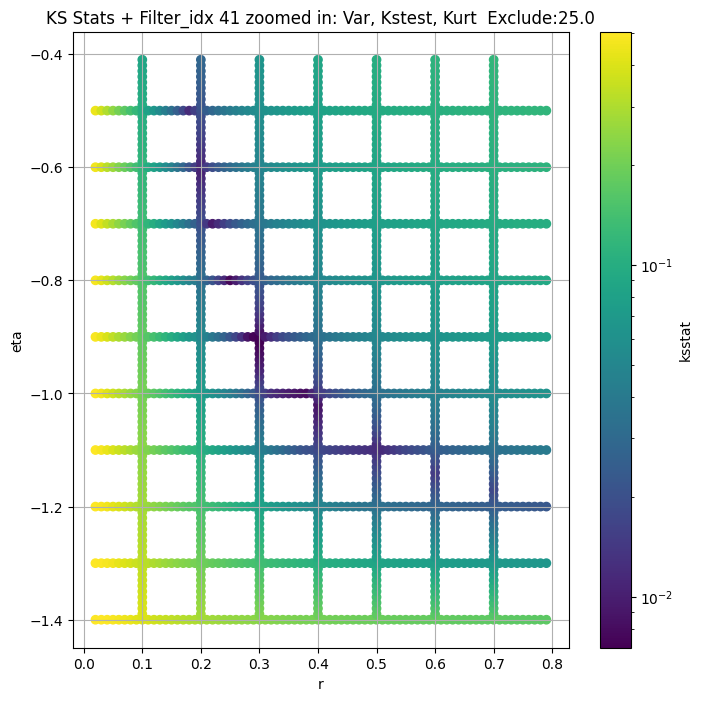

Filter_idx 42


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 42, 100.0 + 100 = 200, ksstat: 0.011130206791742148, var: 5.983682372920219


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 42, 100.0 + 75 = 175, ksstat: 0.011326683080712663, var: 6.109454170350909


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 42, 100.0 + 50 = 150, ksstat: 0.01096761249907885, var: 6.244152102471858


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 42, 100.0 + 25 = 125, ksstat: 0.011027035266209073, var: 6.38950682961793


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 42, 100.0 + 0 = 100, ksstat: 0.011506493036455123, var: 6.547793064205199


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 42, 100.0 + -25 = 75, ksstat: 0.011447043710883564, var: 6.72303390420634


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 42, 100.0 + -50 = 50, ksstat: 0.011074534955390958, var: 6.922669176053803


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 42, 100.0 + -75 = 25, ksstat: 0.010627466242292327, var: 7.162445280460209


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 42, 100.0 + -100 = 0, ksstat: 0.012035065694585234, var: 7.697337580804665
Number of samples: 100000, Without approximation : 196608000.0


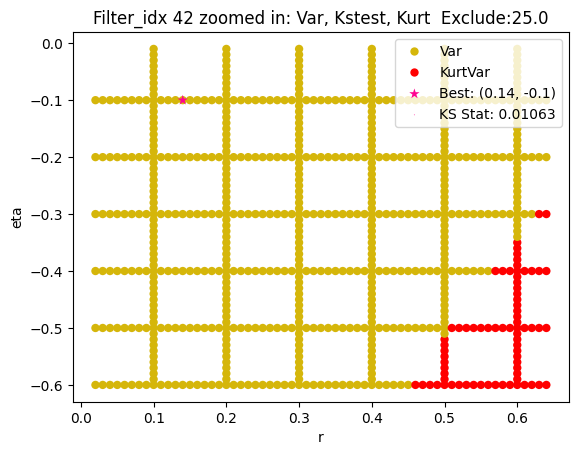

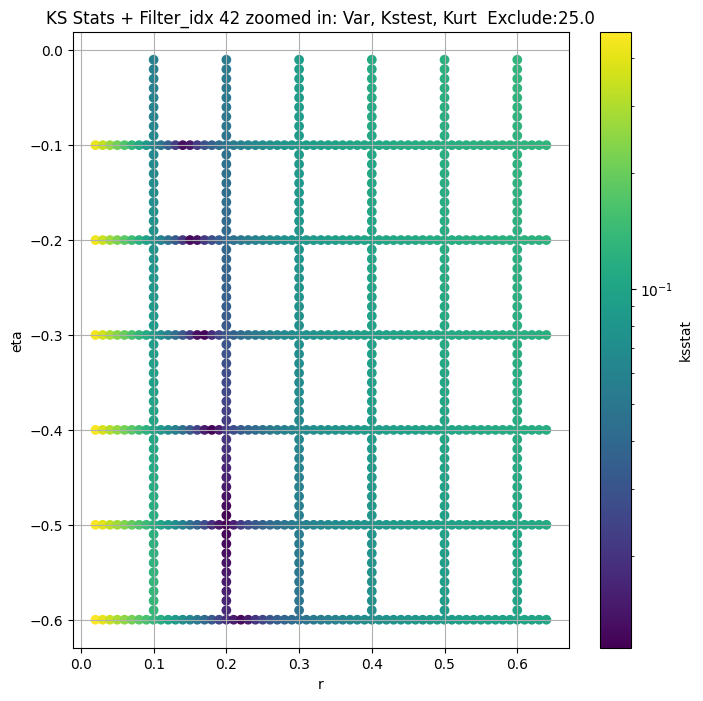

Filter_idx 43


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 43, 0.0 + 100 = 100, ksstat: 0.005467501655675555, var: 2.4083114339180116


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 43, 0.0 + 75 = 75, ksstat: 0.005663482154692201, var: 2.460083887214194


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 43, 0.0 + 50 = 50, ksstat: 0.00509534296125741, var: 2.519659866493037


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 43, 0.0 + 25 = 25, ksstat: 0.005034199760760472, var: 2.59250198364329


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 43, 0.0 + 0 = 0, ksstat: 0.004538565433196862, var: 2.7609431928221473
Number of samples: 100000, Without approximation : 196608000.0


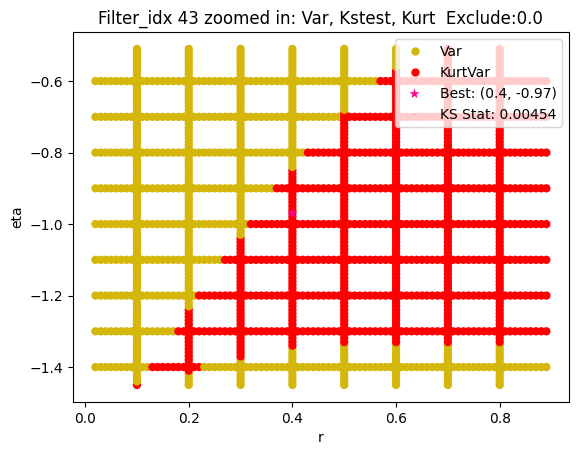

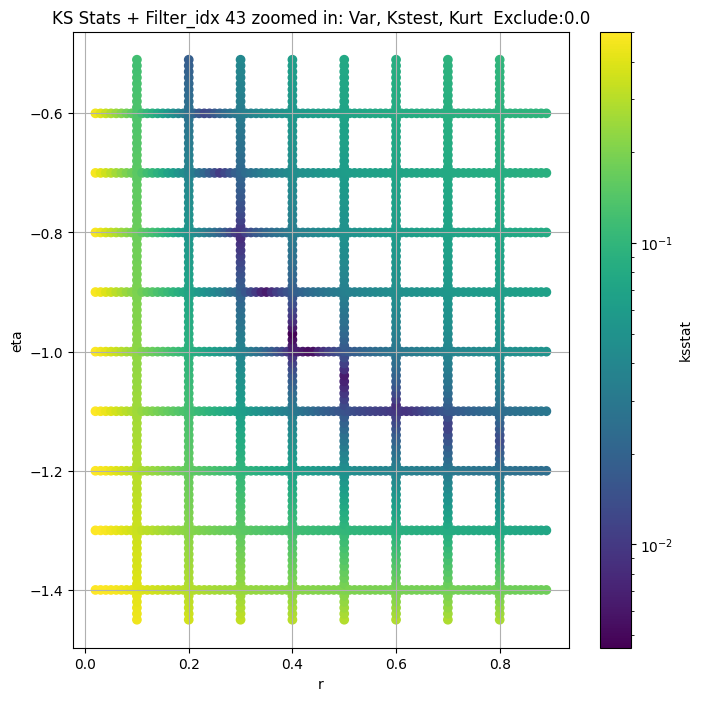

Filter_idx 44


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 44, 50.0 + 100 = 150, ksstat: 0.006854318716867702, var: 5.099647288417842


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 44, 50.0 + 75 = 125, ksstat: 0.00722724805466194, var: 5.208341298861193


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 44, 50.0 + 50 = 100, ksstat: 0.006366292769414451, var: 5.327378089232825


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 44, 50.0 + 25 = 75, ksstat: 0.006997809037737522, var: 5.460181268566645


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 44, 50.0 + 0 = 50, ksstat: 0.005856948162824588, var: 5.612621677556628


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 44, 50.0 + -25 = 25, ksstat: 0.005635537019241861, var: 5.798757773828376


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 44, 50.0 + -50 = 0, ksstat: 0.0057375364739232215, var: 6.248442544266474
Number of samples: 100000, Without approximation : 196608000.0


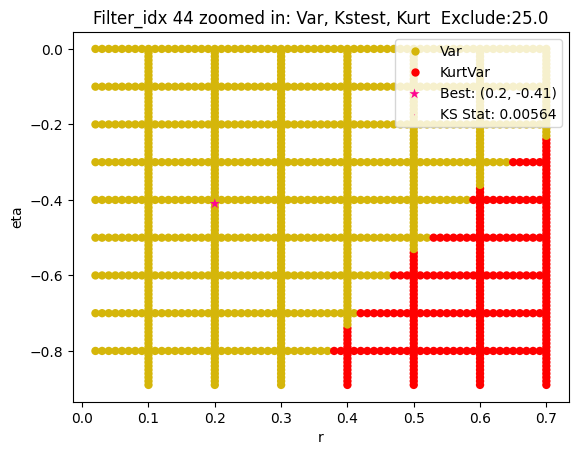

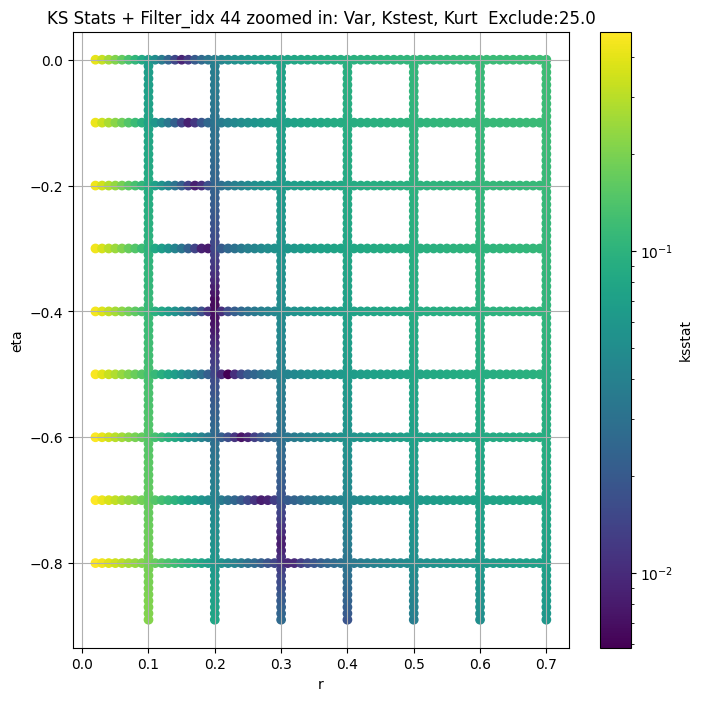

Filter_idx 45


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 45, 50.0 + 100 = 150, ksstat: 0.019379910427829994, var: 2.8118816448403186


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 45, 50.0 + 75 = 125, ksstat: 0.019318631831846567, var: 2.855711159283367


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 45, 50.0 + 50 = 100, ksstat: 0.019409494803192, var: 2.9032161129763345


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 45, 50.0 + 25 = 75, ksstat: 0.019557825270046347, var: 2.955569782656475


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 45, 50.0 + 0 = 50, ksstat: 0.019439287132227423, var: 3.014880425708489


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 45, 50.0 + -25 = 25, ksstat: 0.019413199145240034, var: 3.086209490939657


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 45, 50.0 + -50 = 0, ksstat: 0.019459480610215296, var: 3.3127519106531587
Number of samples: 100000, Without approximation : 196608000.0


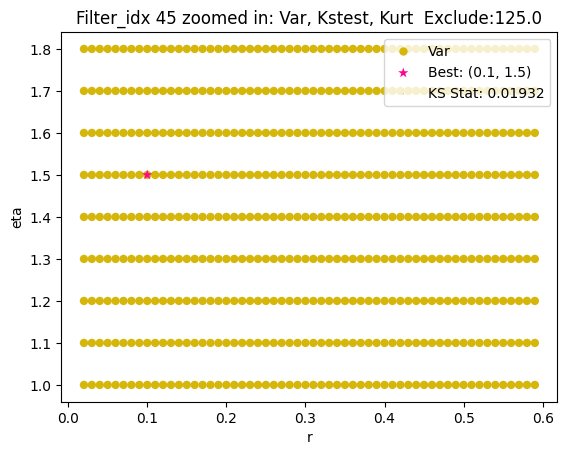

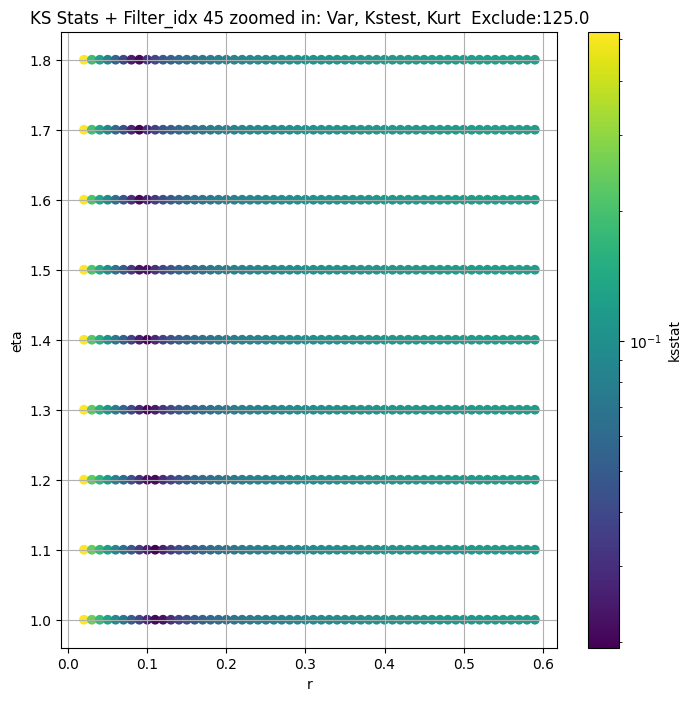

Filter_idx 46


  0%|          | 0/880 [00:00<?, ?it/s]

Finding Minimum after computing 880 CDFs
filter_idx 46, 100.0 + 100 = 200, ksstat: 0.010790994029782786, var: 2.121041085565547


  0%|          | 0/880 [00:00<?, ?it/s]

Finding Minimum after computing 880 CDFs
filter_idx 46, 100.0 + 75 = 175, ksstat: 0.01074261197581361, var: 2.144629995868102


  0%|          | 0/880 [00:00<?, ?it/s]

Finding Minimum after computing 880 CDFs
filter_idx 46, 100.0 + 50 = 150, ksstat: 0.010665335447814062, var: 2.1696994237944796


  0%|          | 0/880 [00:00<?, ?it/s]

Finding Minimum after computing 880 CDFs
filter_idx 46, 100.0 + 25 = 125, ksstat: 0.010686727144312513, var: 2.196534511772675


  0%|          | 0/880 [00:00<?, ?it/s]

Finding Minimum after computing 880 CDFs
filter_idx 46, 100.0 + 0 = 100, ksstat: 0.010716847215994307, var: 2.2255661690073505


  0%|          | 0/880 [00:00<?, ?it/s]

Finding Minimum after computing 880 CDFs
filter_idx 46, 100.0 + -25 = 75, ksstat: 0.010916438755926183, var: 2.257485597731948


  0%|          | 0/880 [00:00<?, ?it/s]

Finding Minimum after computing 880 CDFs
filter_idx 46, 100.0 + -50 = 50, ksstat: 0.011017441428890135, var: 2.293512587411293


  0%|          | 0/880 [00:00<?, ?it/s]

Finding Minimum after computing 880 CDFs
filter_idx 46, 100.0 + -75 = 25, ksstat: 0.01158042482767406, var: 2.3363777703808726


  0%|          | 0/880 [00:00<?, ?it/s]

Finding Minimum after computing 880 CDFs
filter_idx 46, 100.0 + -100 = 0, ksstat: 0.01310302425812071, var: 2.4564696872703986
Number of samples: 100000, Without approximation : 196608000.0


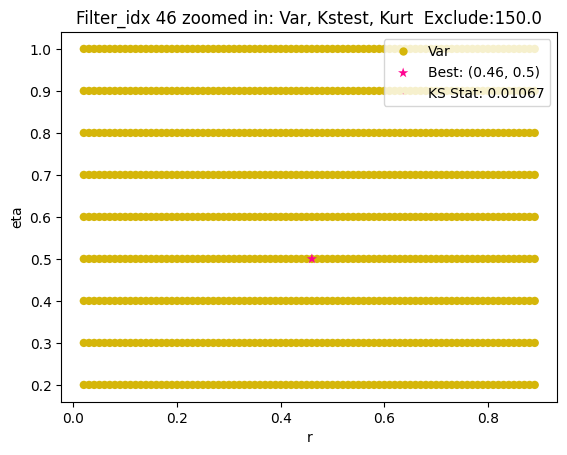

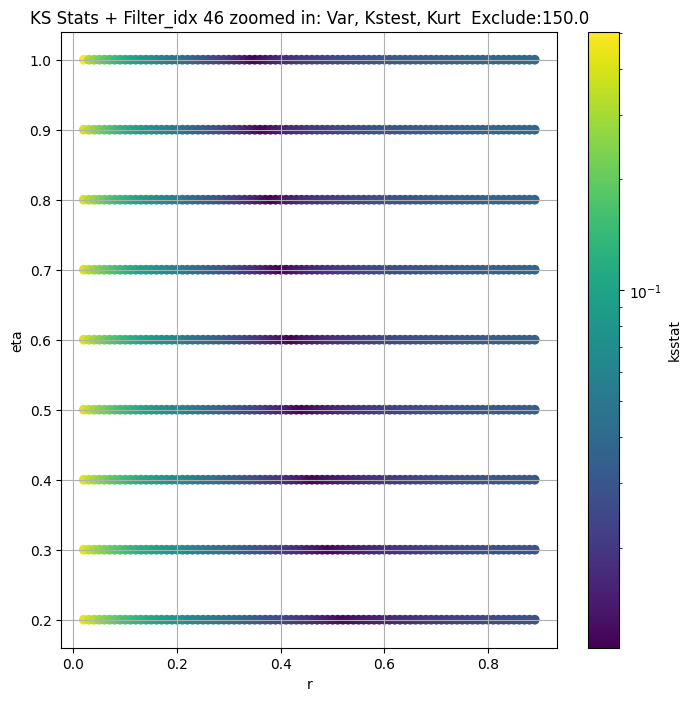

Filter_idx 47


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 47, 200.0 + 100 = 300, ksstat: 0.007876725040407408, var: 3.627408858741216


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 47, 200.0 + 75 = 275, ksstat: 0.0073751037545576464, var: 3.6777982572723737


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 47, 200.0 + 50 = 250, ksstat: 0.007045385181810748, var: 3.7304388440917555


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 47, 200.0 + 25 = 225, ksstat: 0.007551687508930427, var: 3.785602053584983


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 47, 200.0 + 0 = 200, ksstat: 0.007297722951287985, var: 3.8435933749254763


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 47, 200.0 + -25 = 175, ksstat: 0.0069067973271778466, var: 3.9047814652379933


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 47, 200.0 + -50 = 150, ksstat: 0.0065026449698230016, var: 3.9697009447713194


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 47, 200.0 + -75 = 125, ksstat: 0.006425912529869904, var: 4.039034814194259


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 47, 200.0 + -100 = 100, ksstat: 0.005919709468656387, var: 4.113658366991194
Number of samples: 100000, Without approximation : 196608000.0


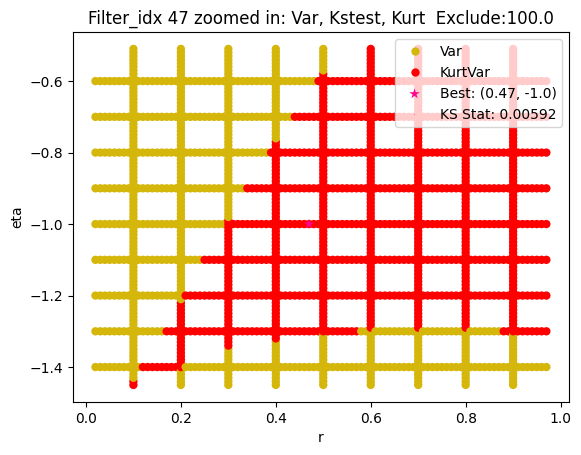

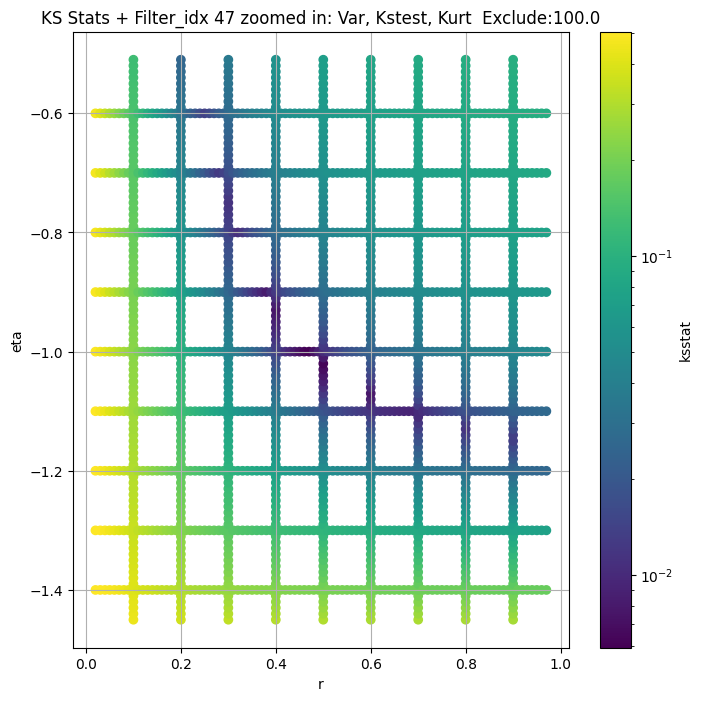

Filter_idx 48


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 48, 100.0 + 100 = 200, ksstat: 0.011400839501065296, var: 2.2583805575490814


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 48, 100.0 + 75 = 175, ksstat: 0.01160191559418966, var: 2.3032948665350688


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 48, 100.0 + 50 = 150, ksstat: 0.011204608222737389, var: 2.3518336369685473


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 48, 100.0 + 25 = 125, ksstat: 0.011109464775481526, var: 2.4048536948728287


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 48, 100.0 + 0 = 100, ksstat: 0.011152137133821516, var: 2.4635886728412206


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 48, 100.0 + -25 = 75, ksstat: 0.010796713555388304, var: 2.5299916128086735


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 48, 100.0 + -50 = 50, ksstat: 0.011163899753314166, var: 2.607658057187236


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 48, 100.0 + -75 = 25, ksstat: 0.011365947341634042, var: 2.7049169638005304


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 48, 100.0 + -100 = 0, ksstat: 0.010832034722039308, var: 2.924931701551067
Number of samples: 100000, Without approximation : 196608000.0


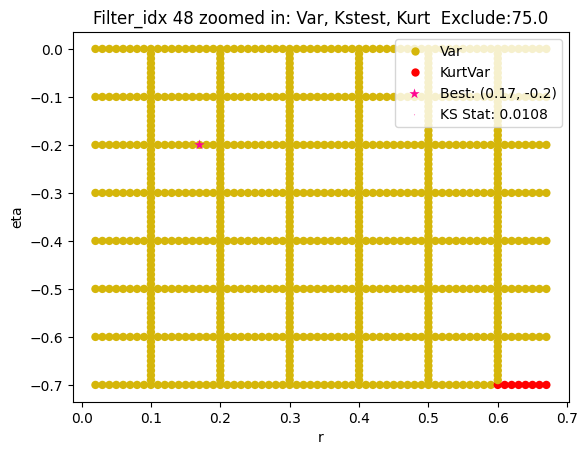

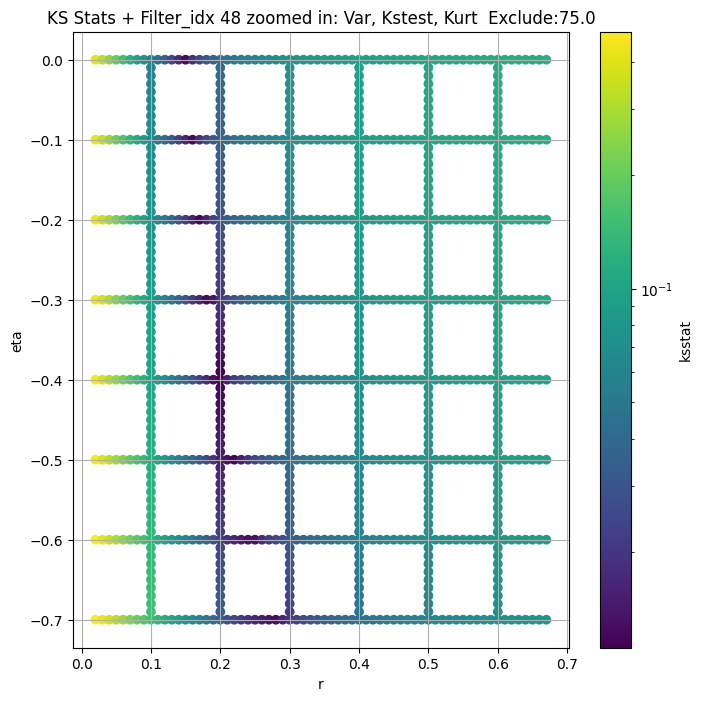

Filter_idx 49


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 49, 0.0 + 100 = 100, ksstat: 0.006608519727974604, var: 4.743648622161137


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 49, 0.0 + 75 = 75, ksstat: 0.00643281539132079, var: 4.851227813289072


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 49, 0.0 + 50 = 50, ksstat: 0.005996545885005311, var: 4.975472564231762


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 49, 0.0 + 25 = 25, ksstat: 0.006309187312903086, var: 5.128155608763203


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 49, 0.0 + 0 = 0, ksstat: 0.0055237386485360584, var: 5.523211620377323
Number of samples: 100000, Without approximation : 196608000.0


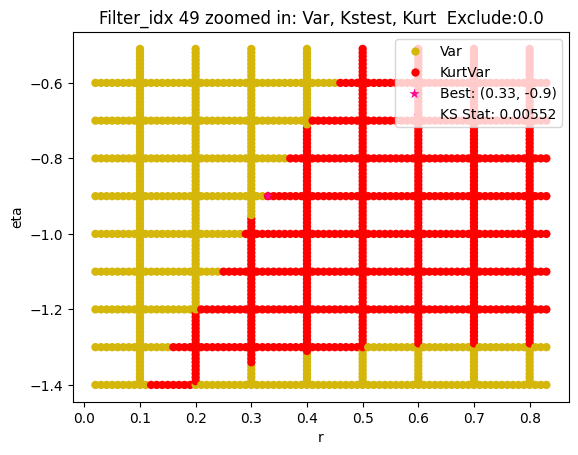

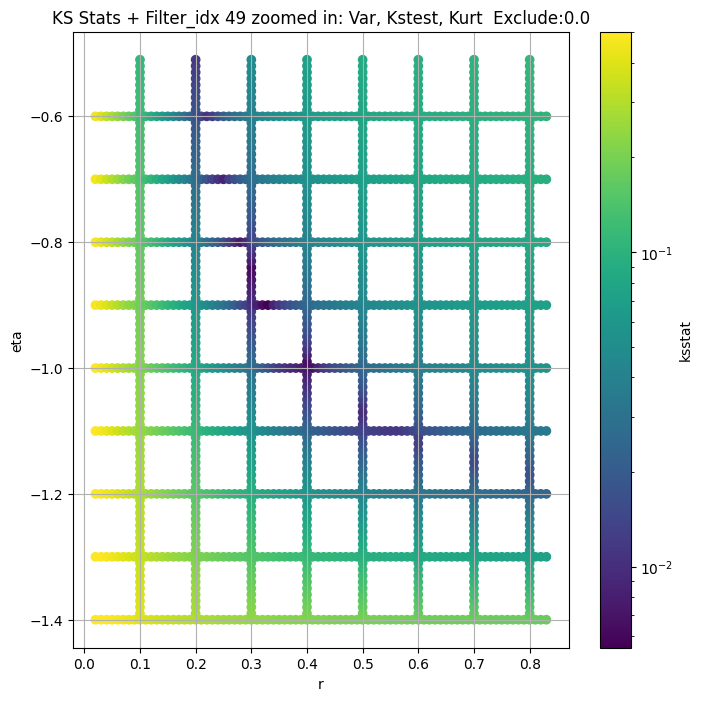

Filter_idx 50


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 50, 0.0 + 100 = 100, ksstat: 0.008548368380305316, var: 2.836225144283794


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 50, 0.0 + 75 = 75, ksstat: 0.008161301475604066, var: 2.9079530490714878


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 50, 0.0 + 50 = 50, ksstat: 0.00828041801810675, var: 2.9921964120688904


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 50, 0.0 + 25 = 25, ksstat: 0.00805443722286675, var: 3.098653366870758


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 50, 0.0 + 0 = 0, ksstat: 0.008139286036085713, var: 3.382892563601956
Number of samples: 100000, Without approximation : 196608000.0


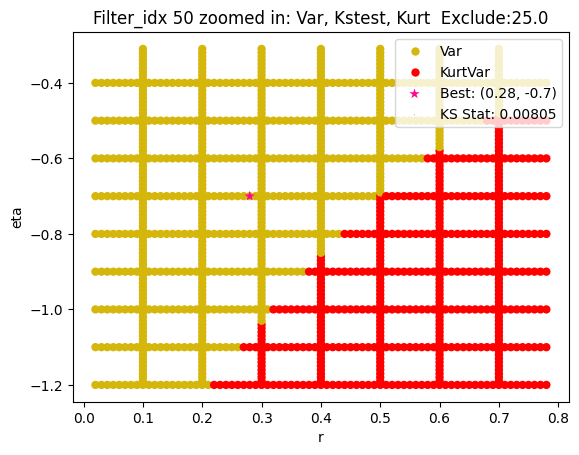

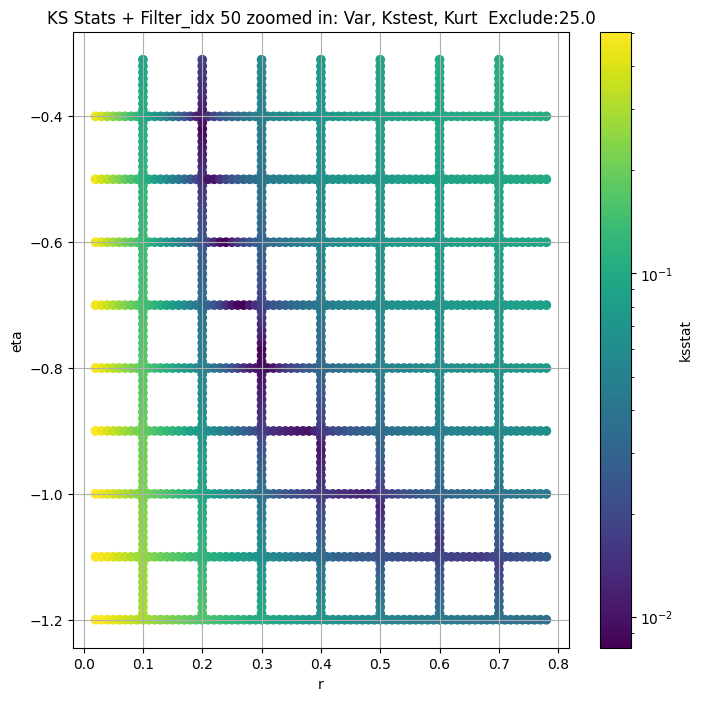

Filter_idx 51


  0%|          | 0/1 [00:00<?, ?it/s]

Finding Minimum after computing 1 CDFs
filter_idx 51, 0.0 + 100 = 100, ksstat: 0.022976036619912543, var: 7.107988167269349


  0%|          | 0/1 [00:00<?, ?it/s]

Finding Minimum after computing 1 CDFs
filter_idx 51, 0.0 + 75 = 75, ksstat: 0.02247056173699996, var: 7.149567284371723


  0%|          | 0/1 [00:00<?, ?it/s]

Finding Minimum after computing 1 CDFs
filter_idx 51, 0.0 + 50 = 50, ksstat: 0.02191560724619429, var: 7.195633905319169


  0%|          | 0/1 [00:00<?, ?it/s]

Finding Minimum after computing 1 CDFs
filter_idx 51, 0.0 + 25 = 25, ksstat: 0.02127049265101677, var: 7.2496988179855935


  0%|          | 0/1 [00:00<?, ?it/s]

Finding Minimum after computing 1 CDFs
filter_idx 51, 0.0 + 0 = 0, ksstat: 0.01988894596493318, var: 7.367633166373575
Number of samples: 100000, Without approximation : 196608000.0


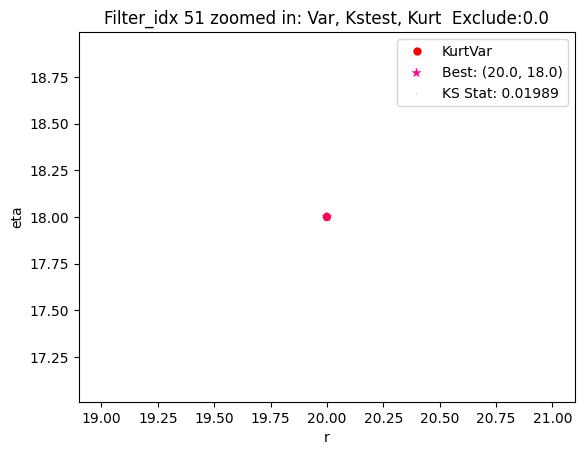

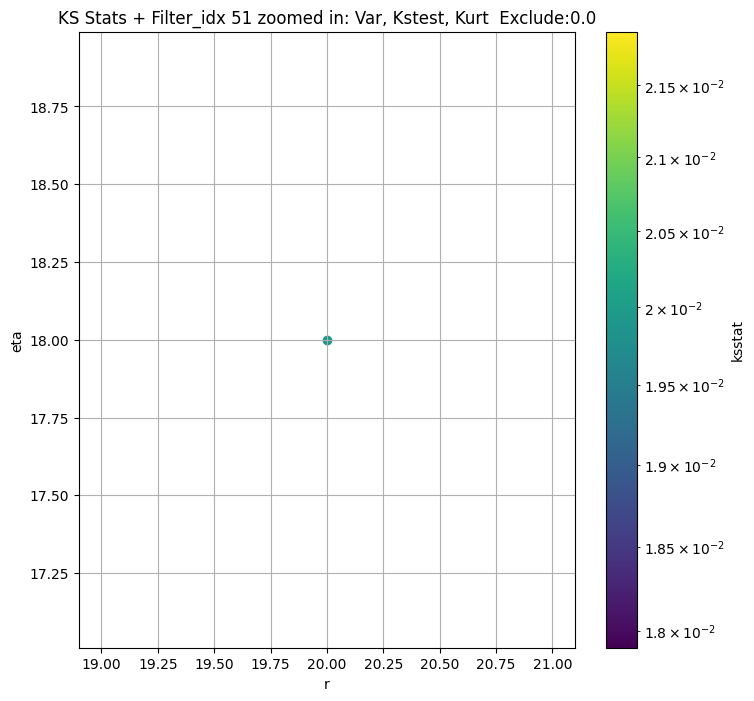

Filter_idx 52


  0%|          | 0/900 [00:00<?, ?it/s]

Finding Minimum after computing 900 CDFs
filter_idx 52, 100.0 + 100 = 200, ksstat: 0.030406787966213655, var: 4.901824688273953


  0%|          | 0/900 [00:00<?, ?it/s]

Finding Minimum after computing 900 CDFs
filter_idx 52, 100.0 + 75 = 175, ksstat: 0.030406841581905986, var: 4.929390814273467


  0%|          | 0/900 [00:00<?, ?it/s]

Finding Minimum after computing 900 CDFs
filter_idx 52, 100.0 + 50 = 150, ksstat: 0.030406616260168273, var: 4.958425384095366


  0%|          | 0/900 [00:00<?, ?it/s]

Finding Minimum after computing 900 CDFs
filter_idx 52, 100.0 + 25 = 125, ksstat: 0.030406503477977354, var: 4.9892600216853085


  0%|          | 0/900 [00:00<?, ?it/s]

Finding Minimum after computing 900 CDFs
filter_idx 52, 100.0 + 0 = 100, ksstat: 0.03040649083911562, var: 5.022346925461932


  0%|          | 0/900 [00:00<?, ?it/s]

Finding Minimum after computing 900 CDFs
filter_idx 52, 100.0 + -25 = 75, ksstat: 0.03040654764688211, var: 5.058394132926098


  0%|          | 0/900 [00:00<?, ?it/s]

Finding Minimum after computing 900 CDFs
filter_idx 52, 100.0 + -50 = 50, ksstat: 0.03040655600473774, var: 5.098804472821172


  0%|          | 0/900 [00:00<?, ?it/s]

Finding Minimum after computing 900 CDFs
filter_idx 52, 100.0 + -75 = 25, ksstat: 0.030406587999470713, var: 5.147054053738355


  0%|          | 0/900 [00:00<?, ?it/s]

Finding Minimum after computing 900 CDFs
filter_idx 52, 100.0 + -100 = 0, ksstat: 0.030408368321984625, var: 5.293439327262451
Number of samples: 100000, Without approximation : 196608000.0


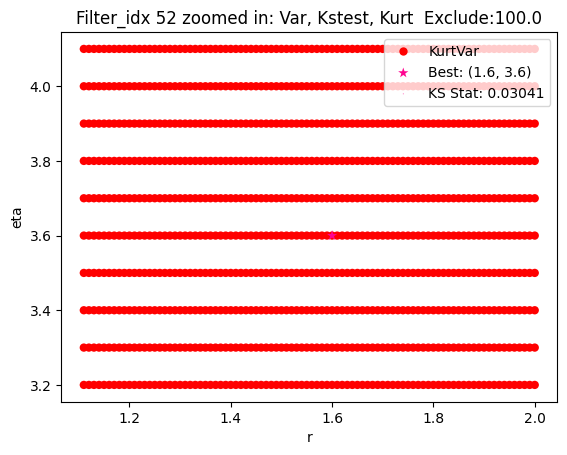

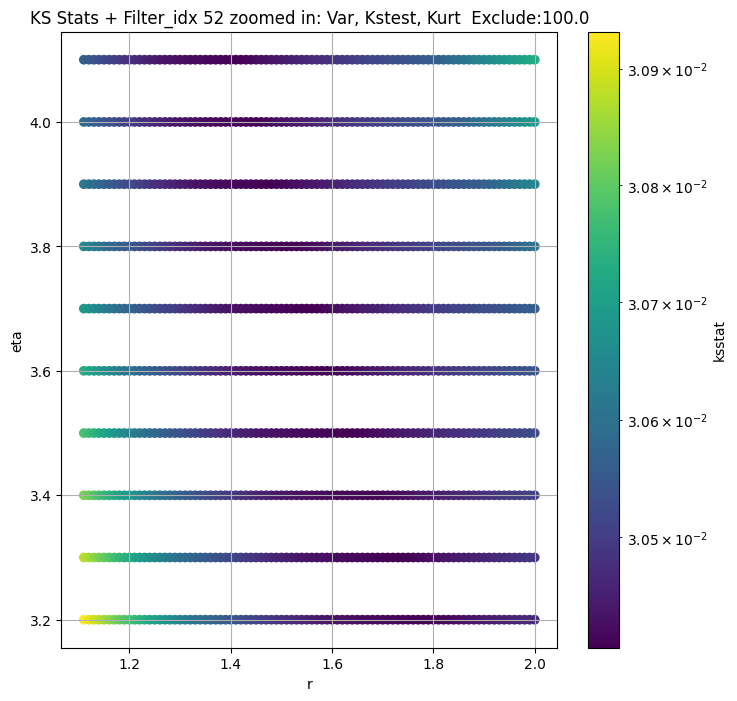

Filter_idx 53


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 53, 0.0 + 100 = 100, ksstat: 0.022776978937502995, var: 1.4838520112478044


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 53, 0.0 + 75 = 75, ksstat: 0.022513474699156072, var: 1.4951655204577516


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 53, 0.0 + 50 = 50, ksstat: 0.022233637000763307, var: 1.5078455251858935


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 53, 0.0 + 25 = 25, ksstat: 0.021779491313806743, var: 1.522917368349854


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 53, 0.0 + 0 = 0, ksstat: 0.020680026429025666, var: 1.5622172467296105
Number of samples: 100000, Without approximation : 196608000.0


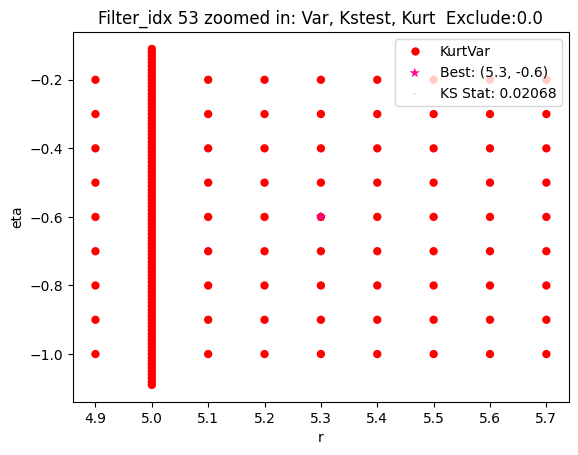

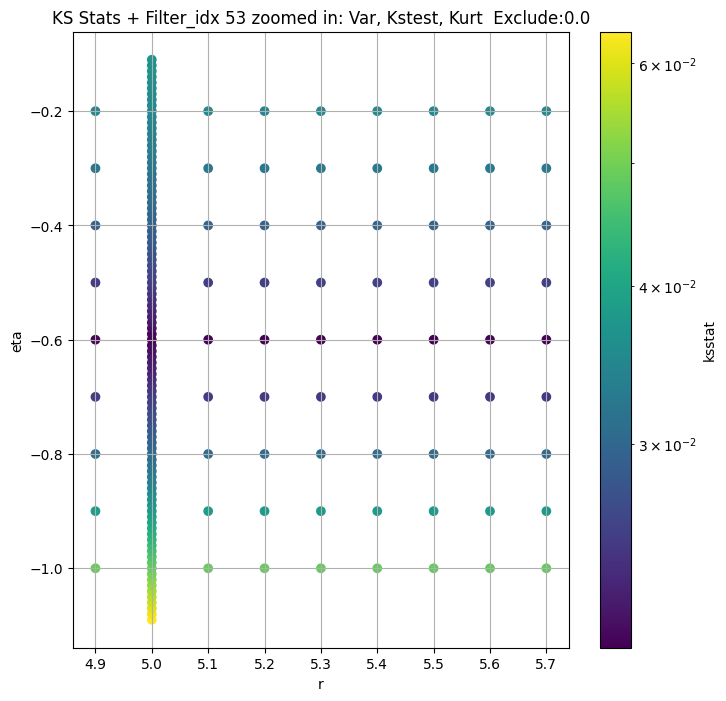

Filter_idx 54


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 54, 200.0 + 100 = 300, ksstat: 0.010334161489544913, var: 3.1594401218311376


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 54, 200.0 + 75 = 275, ksstat: 0.00994369950912588, var: 3.212797220607044


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 54, 200.0 + 50 = 250, ksstat: 0.010345192565391126, var: 3.2693460071249647


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 54, 200.0 + 25 = 225, ksstat: 0.010208561971142449, var: 3.3295606163686937


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 54, 200.0 + 0 = 200, ksstat: 0.010471551680152846, var: 3.3940421066944073


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 54, 200.0 + -25 = 175, ksstat: 0.010246236770284411, var: 3.4636394739282177


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 54, 200.0 + -50 = 150, ksstat: 0.010502791216338236, var: 3.539425220750068


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 54, 200.0 + -75 = 125, ksstat: 0.009531715070755009, var: 3.6228987309456597


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 54, 200.0 + -100 = 100, ksstat: 0.009092262225205316, var: 3.7163356135703247
Number of samples: 100000, Without approximation : 196608000.0


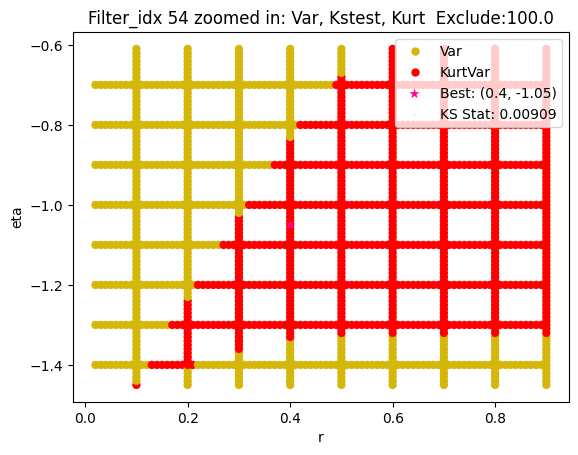

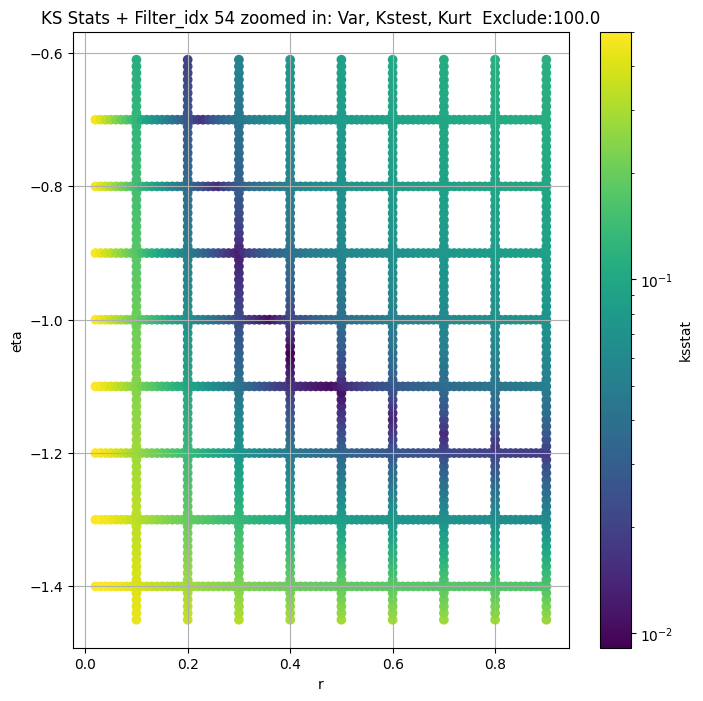

Filter_idx 55


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 55, 0.0 + 100 = 100, ksstat: 0.008844868596477151, var: 2.390229410488475


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 55, 0.0 + 75 = 75, ksstat: 0.008900809270167676, var: 2.4540829195997964


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 55, 0.0 + 50 = 50, ksstat: 0.008474607718653993, var: 2.5302323818170875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 55, 0.0 + 25 = 25, ksstat: 0.008293725529732288, var: 2.6287938143474667


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 55, 0.0 + 0 = 0, ksstat: 0.007980353057752687, var: 2.991251654518789
Number of samples: 100000, Without approximation : 196608000.0


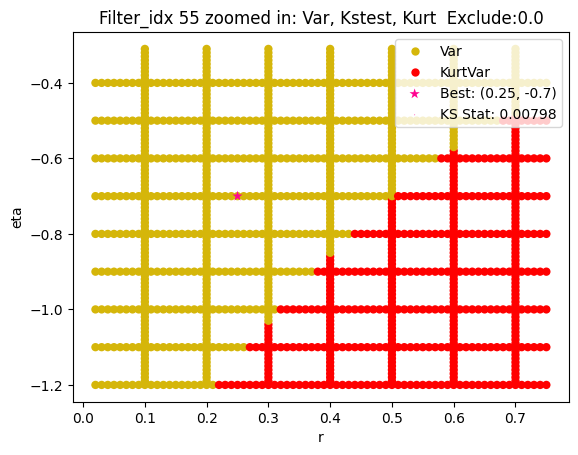

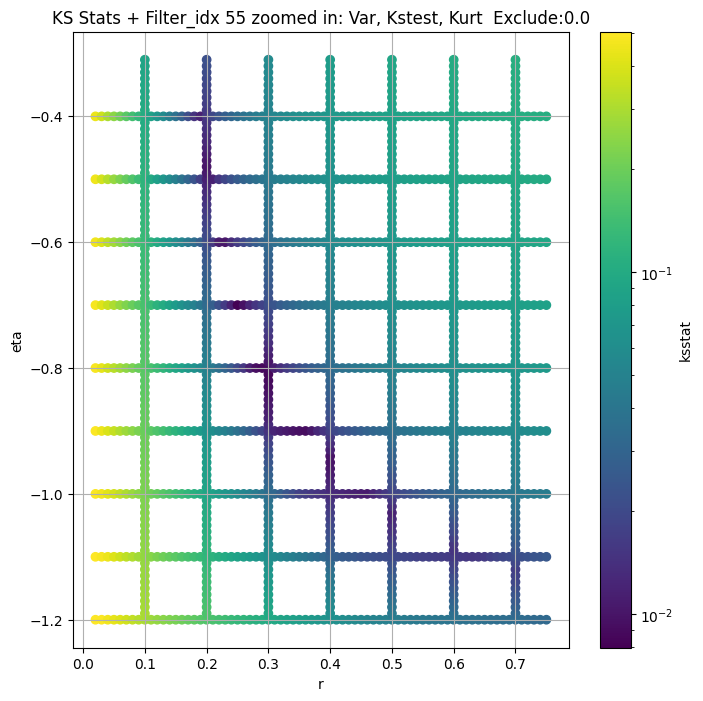

Filter_idx 56


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 56, 100.0 + 100 = 200, ksstat: 0.012246589116449769, var: 4.905418029373902


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 56, 100.0 + 75 = 175, ksstat: 0.011840201741669443, var: 4.997252555094523


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 56, 100.0 + 50 = 150, ksstat: 0.011809989506216478, var: 5.095619388794983


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 56, 100.0 + 25 = 125, ksstat: 0.011381440970205214, var: 5.201928218799635


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 56, 100.0 + 0 = 100, ksstat: 0.010910448605520373, var: 5.3181644606882195


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 56, 100.0 + -25 = 75, ksstat: 0.010474144952879128, var: 5.447125520179537


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 56, 100.0 + -50 = 50, ksstat: 0.010319939873234651, var: 5.593582952502383


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 56, 100.0 + -75 = 25, ksstat: 0.011307009975748405, var: 5.767606170072621


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 56, 100.0 + -100 = 0, ksstat: 0.010312471744845564, var: 6.187806388625462
Number of samples: 100000, Without approximation : 196608000.0


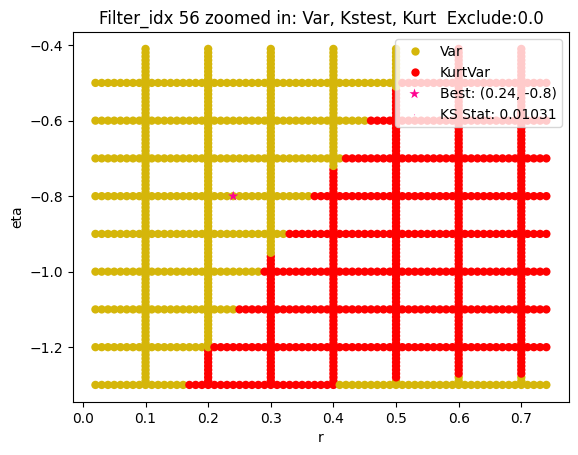

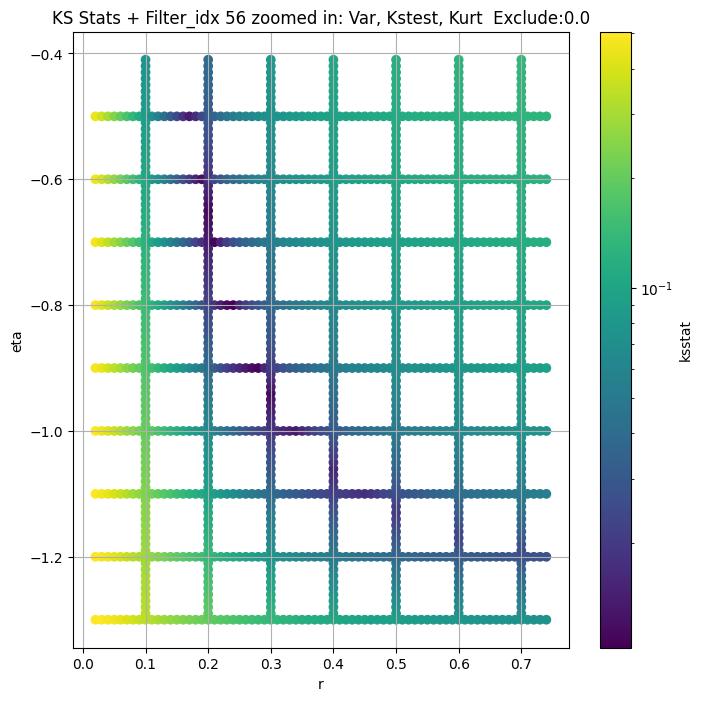

Filter_idx 57


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 57, 100.0 + 100 = 200, ksstat: 0.006284957256021739, var: 2.457075121129111


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 57, 100.0 + 75 = 175, ksstat: 0.006076024619573794, var: 2.501120178694668


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 57, 100.0 + 50 = 150, ksstat: 0.006056758721166178, var: 2.5488368267833104


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 57, 100.0 + 25 = 125, ksstat: 0.005935218774301032, var: 2.601071882504635


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 57, 100.0 + 0 = 100, ksstat: 0.0061649493547214496, var: 2.6591514798304288


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 57, 100.0 + -25 = 75, ksstat: 0.006262370707208809, var: 2.725235066534394


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 57, 100.0 + -50 = 50, ksstat: 0.005942356489018308, var: 2.8033482085927357


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 57, 100.0 + -75 = 25, ksstat: 0.0055006653240291525, var: 2.903316238189926


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 57, 100.0 + -100 = 0, ksstat: 0.005177548390113751, var: 3.1663944371820065
Number of samples: 100000, Without approximation : 196608000.0


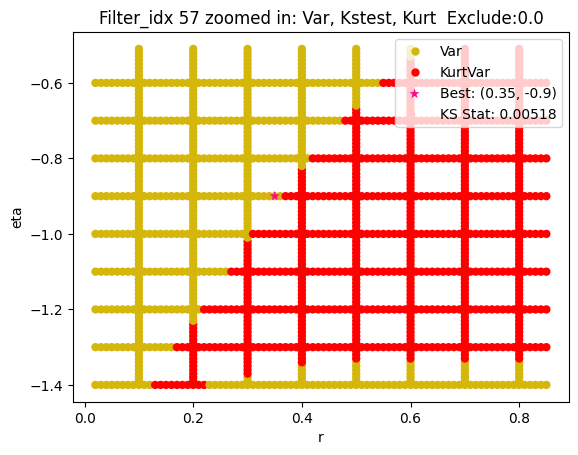

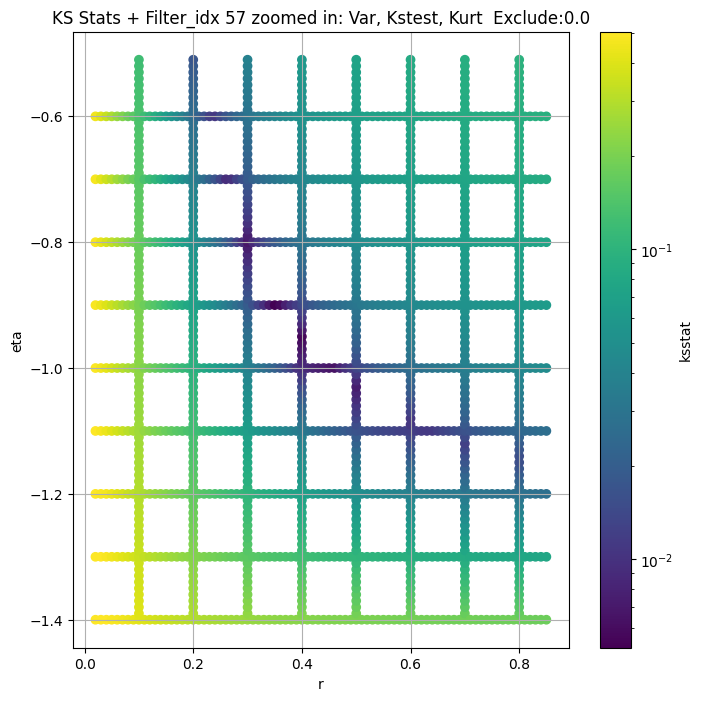

Filter_idx 58


  0%|          | 0/99 [00:00<?, ?it/s]

Finding Minimum after computing 99 CDFs
filter_idx 58, 200.0 + 100 = 300, ksstat: 0.016847819481570436, var: 2.6692854354388493


  0%|          | 0/99 [00:00<?, ?it/s]

Finding Minimum after computing 99 CDFs
filter_idx 58, 200.0 + 75 = 275, ksstat: 0.016563039945589164, var: 2.683143602730972


  0%|          | 0/99 [00:00<?, ?it/s]

Finding Minimum after computing 99 CDFs
filter_idx 58, 200.0 + 50 = 250, ksstat: 0.016269724184932555, var: 2.6975270687685784


  0%|          | 0/99 [00:00<?, ?it/s]

Finding Minimum after computing 99 CDFs
filter_idx 58, 200.0 + 25 = 225, ksstat: 0.016159089391430626, var: 2.712495291078866


  0%|          | 0/99 [00:00<?, ?it/s]

Finding Minimum after computing 99 CDFs
filter_idx 58, 200.0 + 0 = 200, ksstat: 0.016298297003757845, var: 2.7281259511644875


  0%|          | 0/99 [00:00<?, ?it/s]

Finding Minimum after computing 99 CDFs
filter_idx 58, 200.0 + -25 = 175, ksstat: 0.0164391443944375, var: 2.7445265890887787


  0%|          | 0/99 [00:00<?, ?it/s]

Finding Minimum after computing 99 CDFs
filter_idx 58, 200.0 + -50 = 150, ksstat: 0.016608255666082705, var: 2.761850334311082


  0%|          | 0/99 [00:00<?, ?it/s]

Finding Minimum after computing 99 CDFs
filter_idx 58, 200.0 + -75 = 125, ksstat: 0.01677574251765579, var: 2.780304346317253


  0%|          | 0/99 [00:00<?, ?it/s]

Finding Minimum after computing 99 CDFs
filter_idx 58, 200.0 + -100 = 100, ksstat: 0.017434832591529392, var: 2.8002074666918215
Number of samples: 100000, Without approximation : 196608000.0


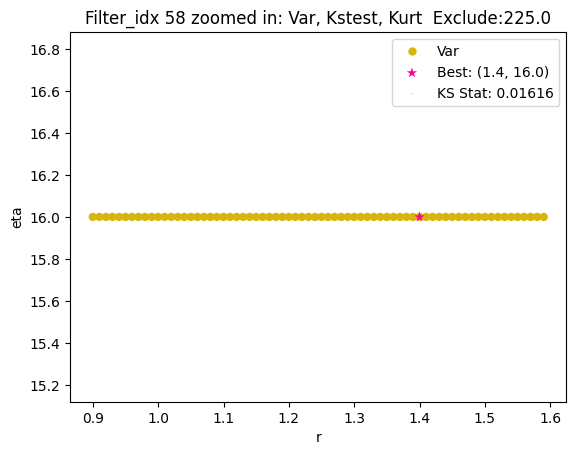

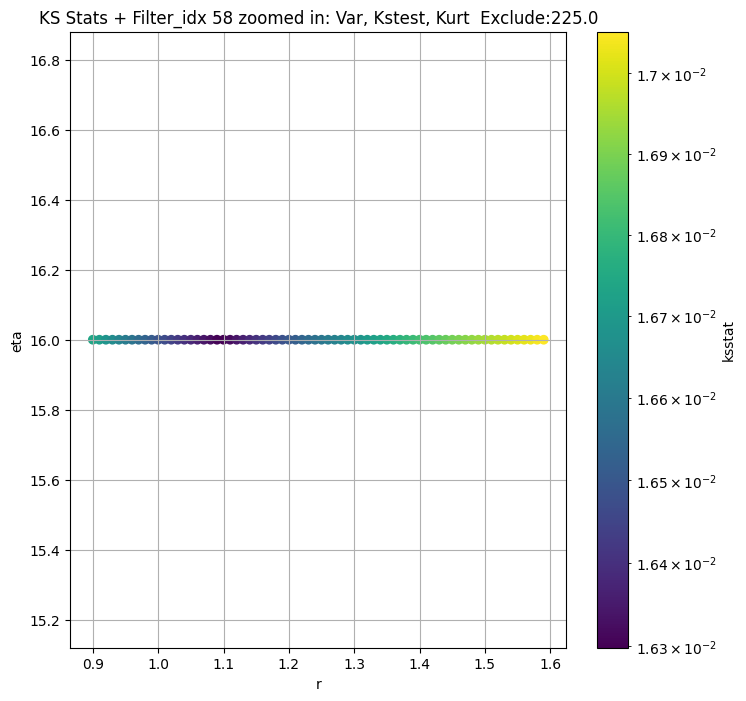

Filter_idx 59


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 59, 100.0 + 100 = 200, ksstat: 0.0056337365973417874, var: 6.205107798729714


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 59, 100.0 + 75 = 175, ksstat: 0.0057620603328674, var: 6.290926990638582


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 59, 100.0 + 50 = 150, ksstat: 0.00531684012880787, var: 6.382036885168565


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 59, 100.0 + 25 = 125, ksstat: 0.0047706130466830116, var: 6.479540300151125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 59, 100.0 + 0 = 100, ksstat: 0.004938523886493094, var: 6.58503789576765


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 59, 100.0 + -25 = 75, ksstat: 0.004448276231025131, var: 6.700859828808446


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 59, 100.0 + -50 = 50, ksstat: 0.0038486759949091717, var: 6.831544240547153


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 59, 100.0 + -75 = 25, ksstat: 0.0034773596545399355, var: 6.98673186173705


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 59, 100.0 + -100 = 0, ksstat: 0.0028528631447323274, var: 7.331521449818652
Number of samples: 100000, Without approximation : 196608000.0


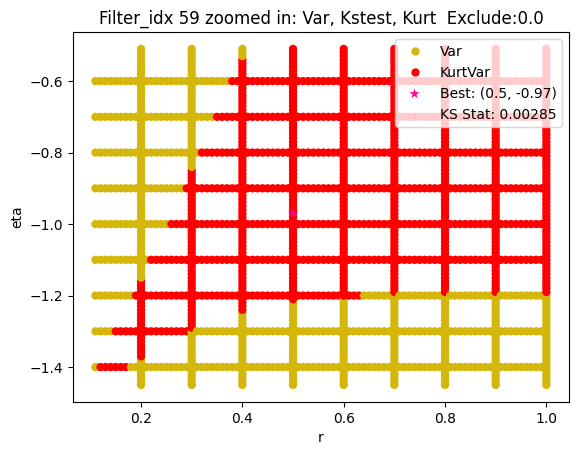

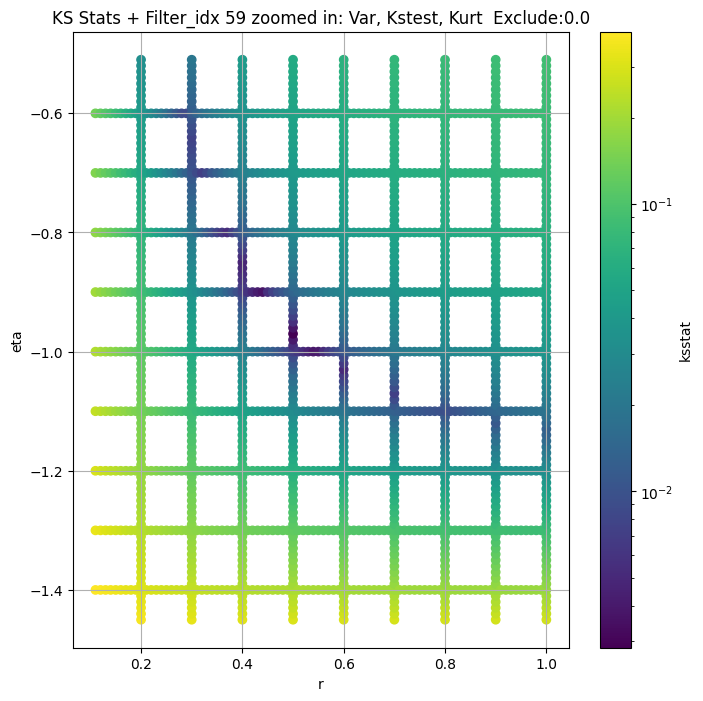

Filter_idx 60


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 50.0 + 100 = 150, ksstat: 0.008650594829617206, var: 0.7356507964522713


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 50.0 + 75 = 125, ksstat: 0.00805106864957389, var: 0.7493369078809656


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 50.0 + 50 = 100, ksstat: 0.007744765211853764, var: 0.764460871218104


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 50.0 + 25 = 75, ksstat: 0.0072838705461318876, var: 0.7815400199031548


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 50.0 + 0 = 50, ksstat: 0.0067315338368033745, var: 0.8015402114318937


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 50.0 + -25 = 25, ksstat: 0.0068655612939553246, var: 0.8267995988150525


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 50.0 + -50 = 0, ksstat: 0.007884870083906759, var: 0.9083998213826714
Number of samples: 100000, Without approximation : 196608000.0


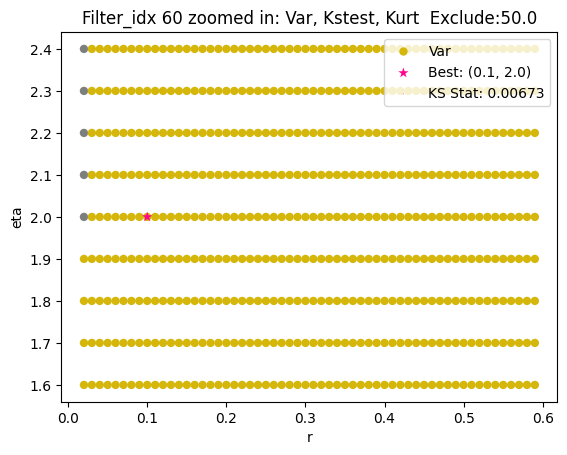

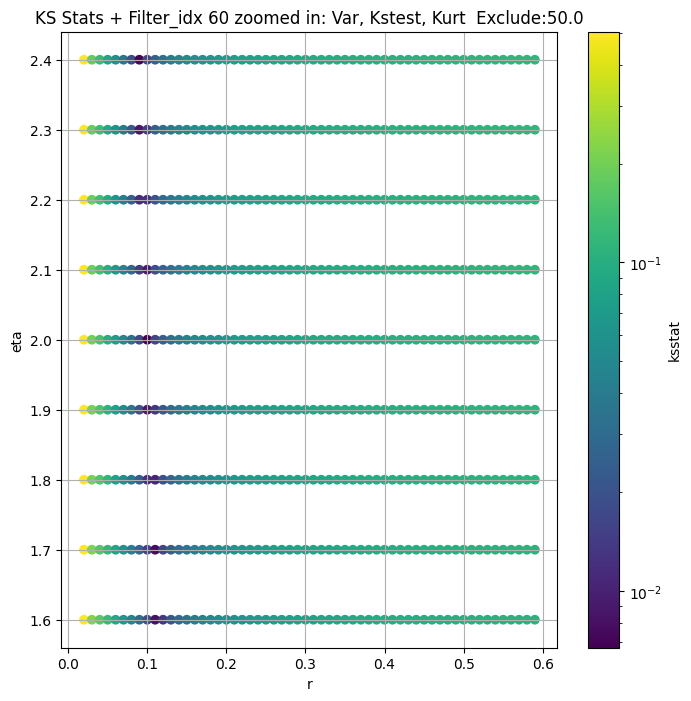

Filter_idx 61


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 61, 0.0 + 100 = 100, ksstat: 0.011257065325940646, var: 2.4028619730783647


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 61, 0.0 + 75 = 75, ksstat: 0.01120573842834327, var: 2.4667580879719178


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 61, 0.0 + 50 = 50, ksstat: 0.011049119863082102, var: 2.540592122936473


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 61, 0.0 + 25 = 25, ksstat: 0.011115653221571264, var: 2.631306708499735


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 61, 0.0 + 0 = 0, ksstat: 0.011066366668281202, var: 2.831790664803961
Number of samples: 100000, Without approximation : 196608000.0


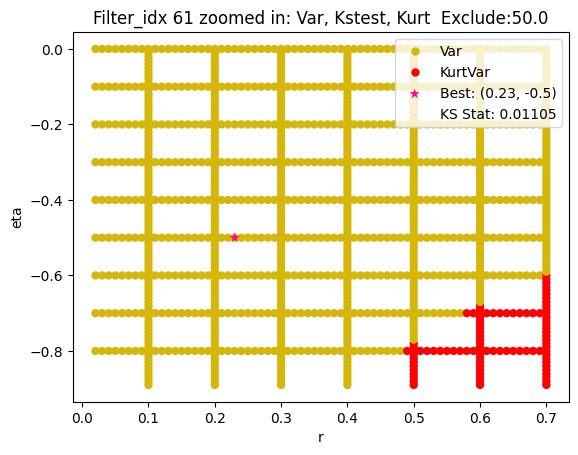

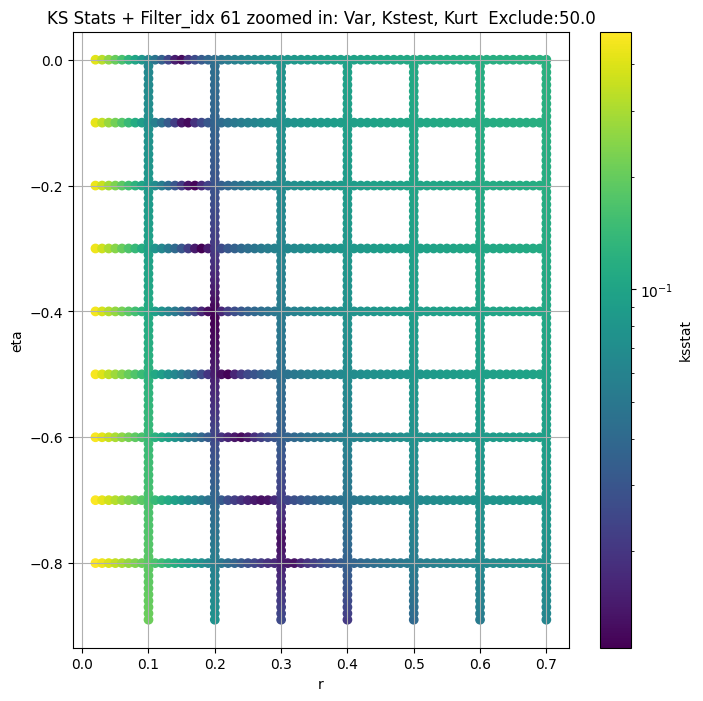

Filter_idx 62


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 62, 200.0 + 100 = 300, ksstat: 0.018925379461347203, var: 4.606618075638078


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 62, 200.0 + 75 = 275, ksstat: 0.018642052675636123, var: 4.669040330039537


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 62, 200.0 + 50 = 250, ksstat: 0.018521460938839218, var: 4.734110637596196


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 62, 200.0 + 25 = 225, ksstat: 0.01865658754796906, var: 4.802129378874056


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 62, 200.0 + 0 = 200, ksstat: 0.018786649540883216, var: 4.8735121285742435


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 62, 200.0 + -25 = 175, ksstat: 0.018643266838973882, var: 4.948780594865923


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 62, 200.0 + -50 = 150, ksstat: 0.018243811661944997, var: 5.02853597599897


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 62, 200.0 + -75 = 125, ksstat: 0.01890187663661491, var: 5.113687066985654


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 62, 200.0 + -100 = 100, ksstat: 0.018728298322975512, var: 5.20559514123655
Number of samples: 100000, Without approximation : 196608000.0


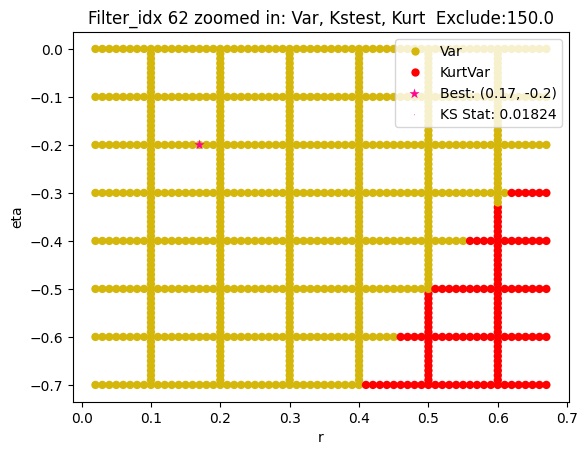

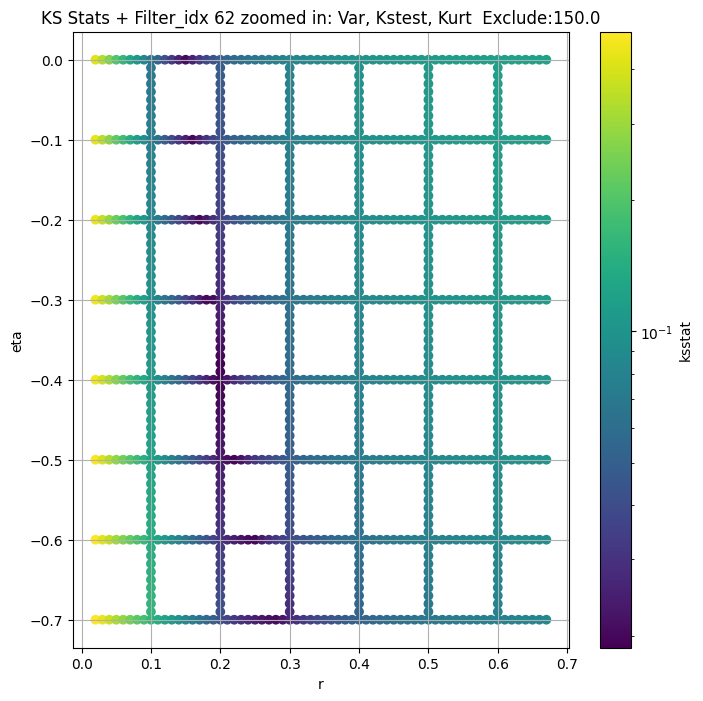

Filter_idx 63


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 63, 100.0 + 100 = 200, ksstat: 0.009875333268898445, var: 2.00151539329958


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 63, 100.0 + 75 = 175, ksstat: 0.00970684238189945, var: 2.0389928374229935


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 63, 100.0 + 50 = 150, ksstat: 0.009532189031398852, var: 2.0796503912425557


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 63, 100.0 + 25 = 125, ksstat: 0.009282764724585002, var: 2.1242676982753275


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 63, 100.0 + 0 = 100, ksstat: 0.0092118067034207, var: 2.1740105872453954


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 63, 100.0 + -25 = 75, ksstat: 0.008661980532252755, var: 2.2308158424236577


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 63, 100.0 + -50 = 50, ksstat: 0.008098949622238005, var: 2.2982685765544058


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 63, 100.0 + -75 = 25, ksstat: 0.008378447467620842, var: 2.3852980871992386


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 63, 100.0 + -100 = 0, ksstat: 0.008117779801625757, var: 2.6454210809616843
Number of samples: 100000, Without approximation : 196608000.0


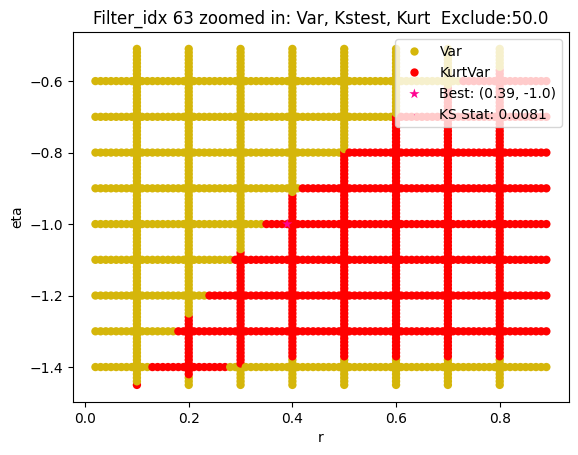

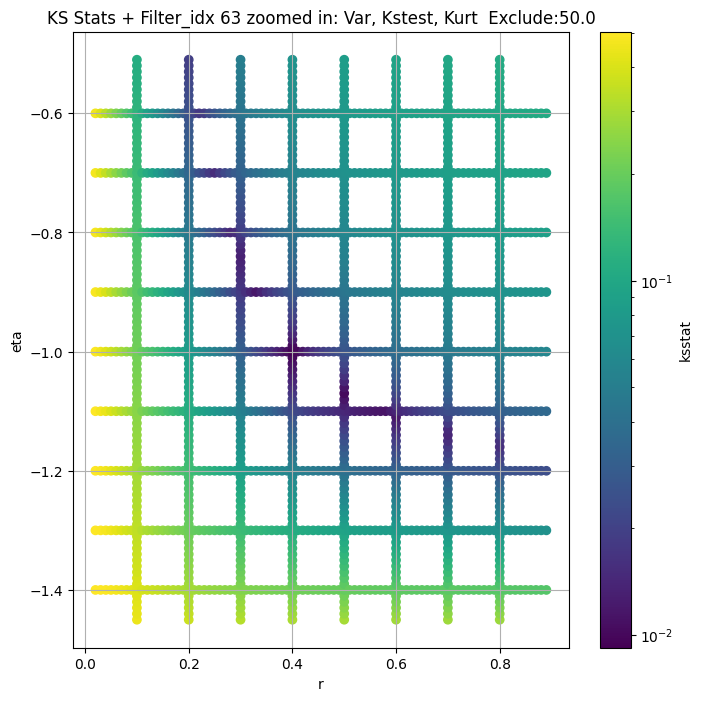

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,5.722945,3.941295,15.222635,59.391348,5.931396,391.685447,196608000.0,dual_color,0.007873,0.2,...,1.892508e-04,0.0,5.722945,0.000097,0.007340,0.20,-0.31,1.954810e-04,0.0,36000
1,6.533414,5.498173,8.526413,3.136300,0.137287,80.026759,196608000.0,misc,0.027652,0.3,...,3.905950e-05,200.0,5.980894,0.000097,0.027640,0.33,9.00,1.521558e-04,300.0,2530
2,7.159568,4.921619,20.682040,85.591074,7.076928,476.156391,196608000.0,dual_color,0.006579,0.3,...,1.784140e-01,0.0,6.565237,0.000097,0.005977,0.31,-0.90,2.084724e-01,25.0,54000
3,4.838522,3.290435,11.411586,48.853143,6.976516,333.181233,196608000.0,single_edge,0.005482,0.3,...,1.205743e-01,0.0,4.474196,0.000097,0.004377,0.38,-1.00,7.128944e-01,25.0,96000
4,8.759626,6.083474,18.486370,34.242134,7.774326,295.723662,196608000.0,dual_color,0.010011,0.3,...,1.919591e-01,100.0,8.759626,0.000097,0.007590,0.30,-0.95,2.662991e-01,0.0,32433
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59,7.331521,5.420855,13.697990,22.008065,4.583866,237.169119,196608000.0,dual_color,0.005118,0.6,...,5.591574e+00,100.0,7.331521,0.000097,0.002853,0.50,-0.97,3.357539e+00,0.0,216000
60,0.908400,0.631226,2.939074,103.870175,5.770326,500.142442,196608000.0,misc,0.006732,0.1,...,8.902061e-17,50.0,0.801540,0.000097,0.006732,0.10,2.00,8.902061e-17,50.0,40500
61,2.831791,1.875037,6.085772,40.461455,7.221174,309.068150,196608000.0,misc,0.011179,0.2,...,1.307920e-04,0.0,2.540592,0.000097,0.011049,0.23,-0.50,1.135240e-03,50.0,15187


In [14]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group} zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

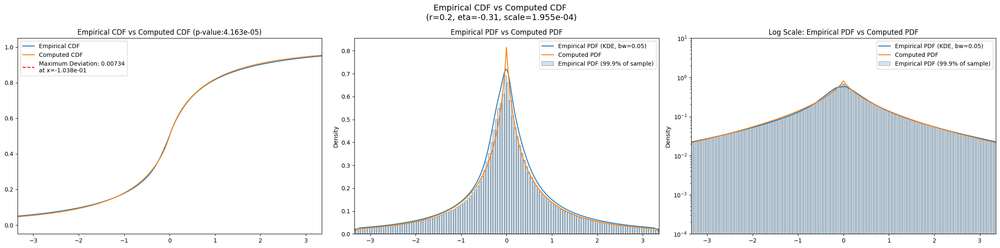

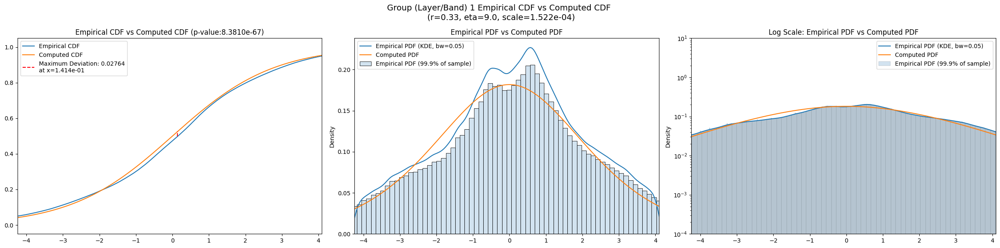

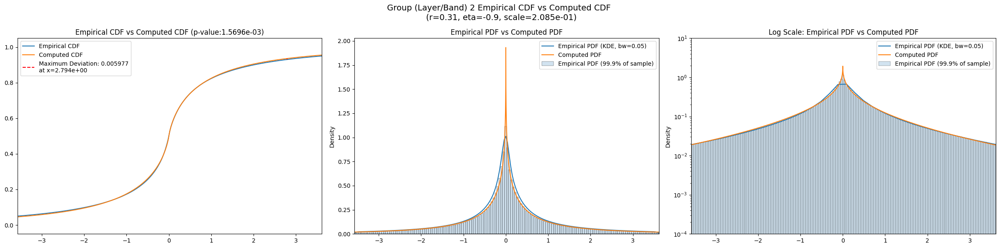

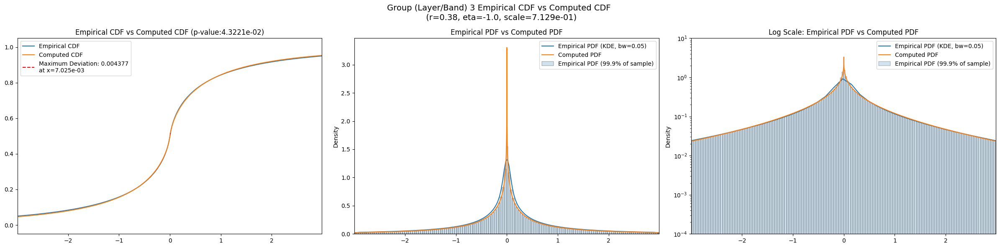

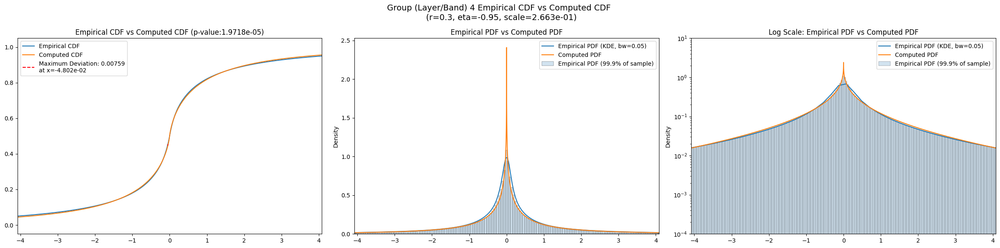

...

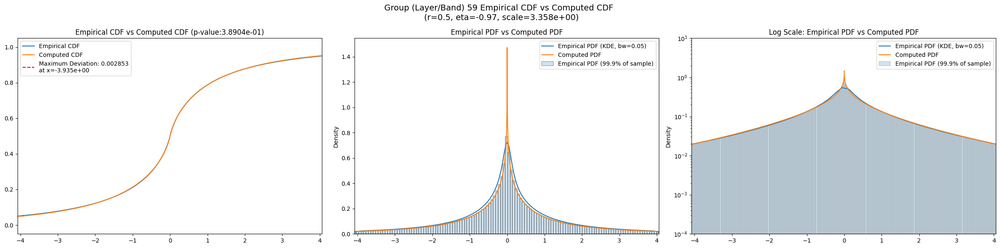

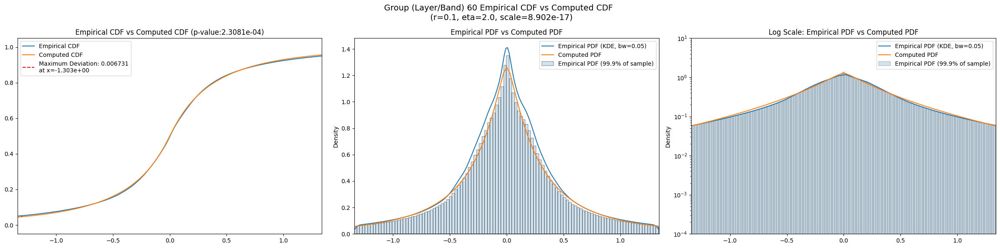

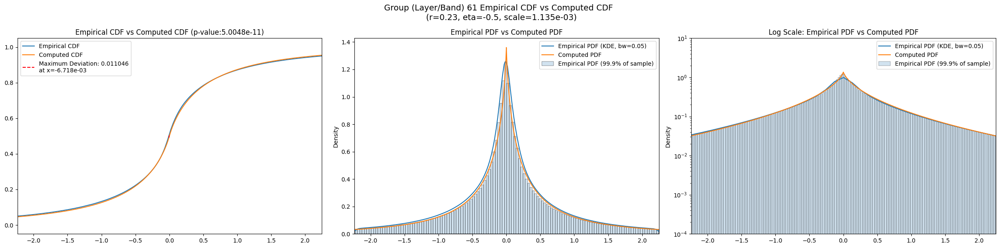

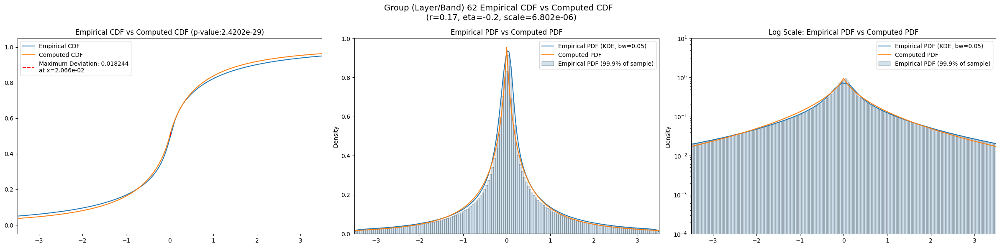

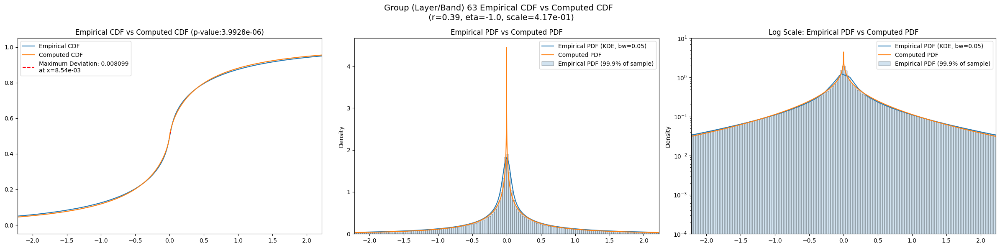

In [15]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = group)
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [16]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [17]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,5.722945,3.941295,15.222635,59.391348,5.931396,391.685447,196608000.0,dual_color,0.007873,0.2,...,1.127460,0.063041,0.0,0.991081,0.035667,0.0,0.790136,0.034920,0.0,0.0
1,6.533414,5.498173,8.526413,3.136300,0.137287,80.026759,196608000.0,misc,0.027652,0.3,...,2.202320,0.027556,0.0,2.288780,0.033899,0.0,1.801080,0.031029,0.0,0.0
2,7.159568,4.921619,20.682040,85.591074,7.076928,476.156391,196608000.0,dual_color,0.006579,0.3,...,1.049200,0.073374,0.0,0.914740,0.047148,0.0,0.713254,0.047398,0.0,0.0
3,4.838522,3.290435,11.411586,48.853143,6.976516,333.181233,196608000.0,single_edge,0.005482,0.3,...,0.877825,0.073957,0.0,0.756033,0.048515,0.0,0.588935,0.049865,0.0,0.0
4,8.759626,6.083474,18.486370,34.242134,7.774326,295.723662,196608000.0,dual_color,0.010011,0.3,...,1.082950,0.077597,0.0,0.943687,0.052128,0.0,0.727981,0.051763,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59,7.331521,5.420855,13.697990,22.008065,4.583866,237.169119,196608000.0,dual_color,0.005118,0.6,...,1.393950,0.062646,0.0,1.209300,0.036217,0.0,0.950989,0.038008,0.0,0.0
60,0.908400,0.631226,2.939074,103.870175,5.770326,500.142442,196608000.0,misc,0.006732,0.1,...,0.520219,0.049901,0.0,0.457578,0.023703,0.0,0.366757,0.020047,0.0,0.0
61,2.831791,1.875037,6.085772,40.461455,7.221174,309.068150,196608000.0,misc,0.011179,0.2,...,0.727448,0.066807,0.0,0.631647,0.040145,0.0,0.499376,0.041868,0.0,0.0


## Results

In [18]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [19]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.007873,0.000097,0.007340,0.063041,0.035667,0.034920
1,0.027652,0.000097,0.027640,0.027556,0.033899,0.031029
2,0.006579,0.000097,0.005977,0.073374,0.047148,0.047398
3,0.005482,0.000097,0.004377,0.073957,0.048515,0.049865
4,0.010011,0.000097,0.007590,0.077597,0.052128,0.051763
...,...,...,...,...,...,...
59,0.005118,0.000097,0.002853,0.062646,0.036217,0.038008
60,0.006732,0.000097,0.006732,0.049901,0.023703,0.020047
61,0.011179,0.000097,0.011049,0.066807,0.040145,0.041868


In [20]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,5.722945,0.007340,0.20,-0.31,1.954810e-04,0.0
1,5.980894,0.027640,0.33,9.00,1.521558e-04,300.0
2,6.565237,0.005977,0.31,-0.90,2.084724e-01,25.0
3,4.474196,0.004377,0.38,-1.00,7.128944e-01,25.0
4,8.759626,0.007590,0.30,-0.95,2.662991e-01,0.0
...,...,...,...,...,...,...
59,7.331521,0.002853,0.50,-0.97,3.357539e+00,0.0
60,0.801540,0.006732,0.10,2.00,8.902061e-17,50.0
61,2.540592,0.011049,0.23,-0.50,1.135240e-03,50.0
